<a href="https://colab.research.google.com/github/pranjal299/cv-project/blob/main/CS_ECE_5824_HW3_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# CS-5824 / Advanced Machine Learning
# Assignment 2 [ 100 Points ]

In this assignment, **you need to complete three sections** which are based on:

1. Gaussian Mixture Models (GMM)
2. Deep Learning
3. Generative Adversarial Networks (GANs)

## Submission guideline

1. Click the Save button at the top of the Jupyter Notebook.
2. Please make sure to have entered your Virginia Tech PID below.
3. Select Edit -> Clear All Output. This will clear all the outputs from all cells (but will keep the content of ll cells).
4. Select Runtime -> Restart and Run All. This will run all the cells in order.
5. Once you've rerun everything, select File -> Print -> Save as PDF
6. Look at the PDF file and make sure all your solutions are there, displayed correctly. 
7. Upload **both** the PDF file and this notebook.
8. Please **DO NOT** upload any data.

### Please Write Your VT PID Here: pranjalranjan@vt.edu

Import some neccesary packages 

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

#Section 3. Generative Adversarial Networks (GANs) [ 40 points ]

In this assignment, we will make use of Generative Adversarial Networks (GANs) in order to generate images from an annotated dataset. We will be implementing the architecture from scratch using only foundational PyTorch building blocks.

A GAN consists of 2 main components: a Generator and a Discriminator, which are simultaneously trained. The generator is in charge of generating images from noise vectors, and the discriminator then predicts whether the generated images are "real" or "fake." The generator wants the discriminator to think all the former's generated images are real, while the discriminator wants to distinguish the generator's fake images from actually real images. The GAN architecture is illustrated in the figure below. Source: [Thalles Silva](https://www.freecodecamp.org/news/an-intuitive-introduction-to-generative-adversarial-networks-gans-7a2264a81394).

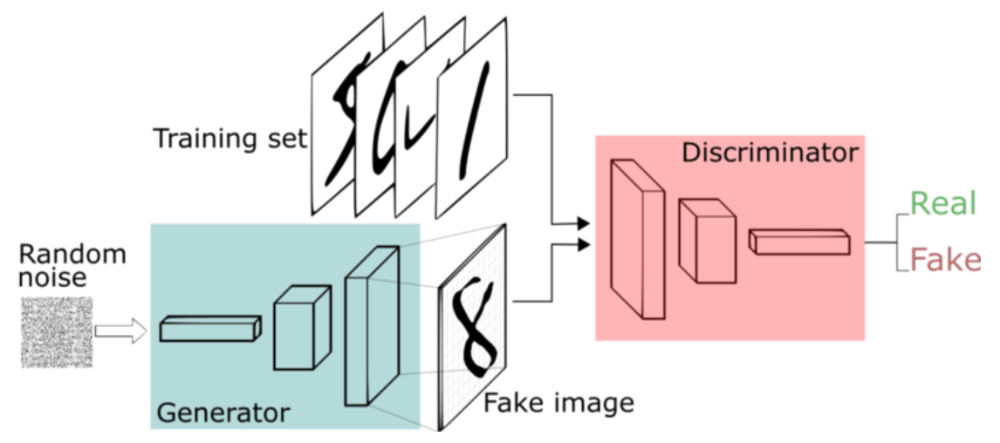

We first import necessary packages:

In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
from typing import Tuple
import matplotlib.pyplot as plt
from torch.autograd import Variable

%matplotlib inline
plt.rcParams["figure.figsize"] = (10.0, 8.0)
plt.rcParams["image.interpolation"] = "nearest"
plt.rcParams["image.cmap"] = "gray"

## 3.1. Data Preparation

We will be generating images from the [Fashion-MNIST dataset](https://github.com/zalandoresearch/fashion-mnist), consisting of small, grayscale images of pieces of clothing. The dataset contains $60,000$ training and $10,000$ test examples, each of which is an image of shape $1 \times 28 \times 28$, with the dimensions respectively denoting the image channel count ($1$ because it is grayscale), height, and width. The are 10 classes in total:

0.	T-shirt/top
1.	Trouser
2.	Pullover
3.	Dress
4.	Coat
5.	Sandal
6.	Shirt
7.	Sneaker
8.	Bag
9.	Ankle boot

Here are some example images, as taken from the Fashion-MNIST repository, which can be accessed through the link above. Follow the link for more details.

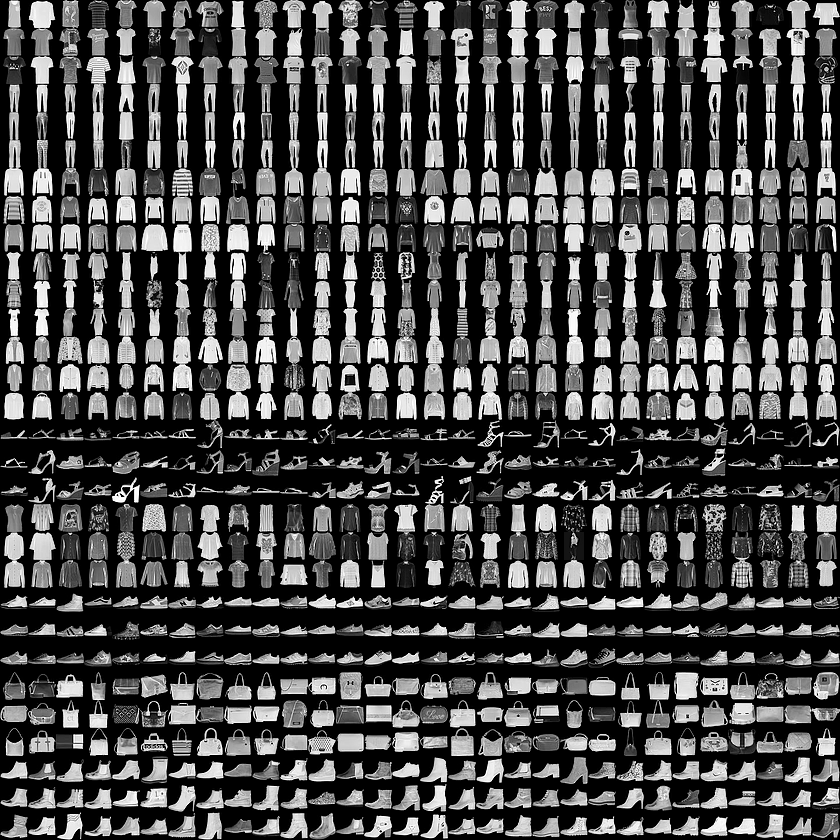

We can import Fashion-MNIST from `torchvision` as follows:

In [ ]:
from torchvision.datasets import FashionMNIST

fmnist_dataset = FashionMNIST(".", download=True, transform=transforms.ToTensor())
fmnist_shape = fmnist_dataset[0][0].shape

We can use `fmnist_shape` hereafter as our image dimensions. To visualize our image data, we use the following function:

In [ ]:
def show_images(
    imgs: torch.Tensor,
    size: Tuple[int, int, int],
    ncols: int=8,
    max_imgs: int=32
):
    if imgs.is_cuda:
        imgs = imgs.detach().cpu()
    num_imgs = min(imgs.shape[0], max_imgs)
    imgs = imgs.view(-1, *size)
    img_grid = make_grid(imgs[:num_imgs], ncols)
    plt.imshow(img_grid.permute(1, 2, 0).squeeze())
    plt.show()

Display the first 32 images in the dataset:

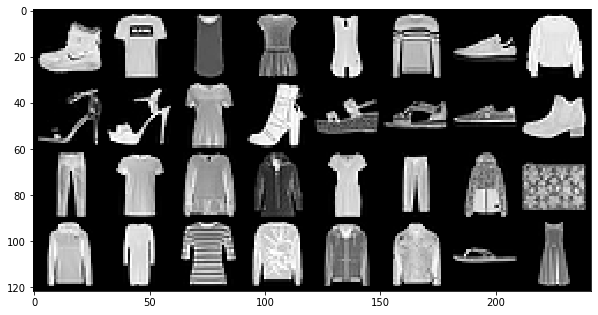

In [ ]:
num_imgs, ncols = 32, 8
to_display = torch.cat([fmnist_dataset[i][0] for i in range(num_imgs)])
show_images(to_display, fmnist_shape, ncols)

## 3.2. Generator [ 10 points ]

We first build the generator for our GAN, which is in charge of the image generation part of our model. The generator consists of a number of generator blocks of different dimensions.

For convenience, we write code to obtain a generator block of input size `input_dim` and ouput size `output_dim`. A generator block should contain:

1. A [linear layer](https://pytorch.org/docs/stable/generated/torch.nn.Linear.html) to transform our data from the input dimension to the output dimension
2. A [batch normalization layer](https://pytorch.org/docs/stable/generated/torch.nn.BatchNorm1d.html) to normalize our data for more efficient training
3. A [rectified linear unit layer (ReLU)](https://pytorch.org/docs/stable/generated/torch.nn.ReLU.html) as activation

We can chain these layers using PyTorch's [Sequential container](https://pytorch.org/docs/stable/generated/torch.nn.Sequential.html).

In [ ]:
def get_generator_block(input_dim, output_dim):
    # TODO: Start your code here
    G = nn.Sequential(
      nn.Linear(input_dim, output_dim),
      nn.BatchNorm1d(output_dim),
      nn.ReLU()
    )
    return G
    # End your code here

We can now write code for the `Generator` module of our GAN. The generator takes in 3 values:

1. The noise vector dimension `noise_dim`
2. The *flattened* image dimension `img_dim`
3. The generator's initial hidden dimension `hidden_dim`

Our generator should have 5 layers:

1. A generator block that takes in the noise vector and outputs a vector of dimension `hidden_dim`
2. A generator block with an output size twice the previous's
3. A generator block with an output size twice the previous's
4. A generator block with an output size twice the previous's
5. A final block consisting of: a linear layer that outputs our generated image with the same `img_dim`, and a [sigmoid activation layer](https://pytorch.org/docs/stable/generated/torch.nn.Sigmoid.html) that scales our output to $(0,1)$

The `forward` pass should just pass the noise vector through your generator and return the value.

In [ ]:
class Generator(nn.Module):
    def __init__(self, noise_dim, img_dim, hidden_dim):
        super(Generator, self).__init__()
        # TODO: Start your code here
        self.z_dim = noise_dim
        self.generator = nn.Sequential(
            get_generator_block(self.z_dim, hidden_dim),
            get_generator_block(hidden_dim, 2*hidden_dim),
            get_generator_block(2*hidden_dim, 2*2*hidden_dim),
            get_generator_block(2*2*hidden_dim, 2*2*2*hidden_dim),
            nn.Linear(2*2*2*hidden_dim, img_dim),
            nn.Sigmoid()
        )
        
        # End your code here

    def forward(self, noise):
        # TODO: Start your code here
        out = self.generator(noise)
        return out
        # End your code here

## 3.3. Noise [ 5 points ]

In order to use our generator, we will need to create noise vectors to be passed through our model. The noise vectors basically act as a random seed and ensure that all generated data from one class does not look identical. You will be generating it from a normal distribution using PyTorch.

Generate `num_samples` noise vectors of dimension `noise_dim`, making sure it is on the correct `device`:

In [ ]:
def get_noise(num_samples, noise_dim, device="cpu"):
    # TODO: Start your code here
    noise = Variable(torch.randn(num_samples,noise_dim)).to(device=device)
    return noise
    # End your code here

## 3.4. Discriminator [ 10 points ]

The next important part of a GAN is the discriminator, which basically acts as a classifier that evaluates whether the generator's output is "fake" or "real." Similarly to the generator, the discriminator is made up of a number of different discriminator blocks, each of which contains:

1. A linear layer to transform out data from size `input_dim` to size `output_dim`
2. A [leaky ReLU](https://pytorch.org/docs/stable/generated/torch.nn.LeakyReLU.html) with a negative slope of $0.2$

In [ ]:
def get_discriminator_block(input_dim, output_dim):
    # TODO: Start your code here
    D = nn.Sequential(
      nn.Linear(input_dim, output_dim),
      nn.LeakyReLU(0.2, inplace=True)
    )
    return D
    # End your code here

Now we construct our `Discriminator` class, which takes in the image size `img_dim` and the discriminator's hidden size `hidden_dim`. The module should consist of 4 layers:

1. A discriminator block that takes in our image and outputs a vector of dimension `4 * hidden_dim`
2. A discriminator block with an output size half the previous's (`2 * hidden_dim`)
3. A discriminator block with an output size half the previous's (`hidden_dim`)
3. A final linear layer that transform the output into a single scalar

Note that we will not need a sigmoid layer here, as it will be included later in our loss function for efficiency. More on this later.

The `forward` pass should also simply forward our image through our sequence of layers.

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, img_dim=784, hidden_dim=128):
        super(Discriminator, self).__init__()
        # TODO: Start your code here
        self.discriminator = nn.Sequential(
            get_discriminator_block(img_dim,4*hidden_dim),
            get_discriminator_block(4*hidden_dim,2*hidden_dim),
            get_discriminator_block(2*hidden_dim,hidden_dim),
            nn.Linear(hidden_dim,1)
        )
        # End your code here

    def forward(self, image):
        # TODO: Start your code here
        out = self.discriminator(image)
        return out
        # End your code here

## 3.5. GAN Losses [ 10 points ]

In order to train our GAN, we will need to write functions to compute losses for our generator and discriminator. First, we define a criterion function that obtains the loss given a set of predictions and a corresponding set of ground truth targets. Since the discriminator is looking at a binary problem ("real" vs. "fake"), we will use binary cross entropy (BCE) loss:

In [ ]:
criterion = nn.BCEWithLogitsLoss()

*Note*: This loss is a variant that includes sigmoid in it already, which is why we did not have to specify a sigmoid layer at the end of our discriminator. Its non-sigmoid counterpart is [`nn.BCELoss()`](https://pytorch.org/docs/stable/generated/torch.nn.BCELoss.html). According to PyTorch,

> [*BCEWithLogitsLoss*] is more numerically stable than using a plain Sigmoid followed by a BCELoss as, by combining the operations into one layer, we take advantage of the log-sum-exp trick for numerical stability.

With this in hand, we can now write the `get_generator_loss()` function to get the loss for our generator. The steps are as follows:

1. Get all noise vectors at once (each corresponding to one image from our dataset) from `num_images` and `noise_dim`, making sure the tensors are on the correct `device`
2. From the noise vectors, generate fake images using our `generator`
3. Predict the fake images with our `discriminator`
4. Calculate the loss between our predictions and a fake "ground truth" using our `criterion`

*Hint for step 4*: The generator wants the discriminator to think that all of the former's generated images are real. Use either [`torch.zeros_like()`](https://pytorch.org/docs/stable/generated/torch.zeros_like.html) or [`torch.ones_like()`](https://pytorch.org/docs/stable/generated/torch.ones_like.html) accordingly.

In [ ]:
def get_generator_loss(generator, discriminator, criterion, num_images, noise_dim, device):
    # TODO: Start your code here
    noise = get_noise(num_images,noise_dim,device)
    fake_images = generator(noise)
    y_pred = discriminator(fake_images)
    g_loss = criterion(y_pred, torch.ones_like(y_pred))
    return g_loss
    # End your code here

The `get_discriminator_loss()` function is a bit more involved, but doable as long as you follow the steps closely. They are as follows:

1. Similarly to above, get all noise vectors and generate fake images using `num_images`, `noise_dim`, `device`, and our `generator`
2. Predict the fake images using our `discriminator`
3. Compute the loss between the (fake) predictions and a fake "ground truth" with `criterion`
4. Here, we are also provided with real images in `real_images`. We want to then predict the real images using our `discriminator`
5. Compute the loss between the (real) predictions and a "ground truth" with `criterion`
6. Obtain the final loss as the average between the losses calculated in steps 3 and 5

*Hint for steps 3 and 5*: Here, unlike in the generator, the discriminator wants to distinguish the fake generated images from the actual ground truth data. Again, use either [`torch.zeros_like()`](https://pytorch.org/docs/stable/generated/torch.zeros_like.html) or [`torch.ones_like()`](https://pytorch.org/docs/stable/generated/torch.ones_like.html) accordingly.

**_Important note for step 2_**: Since we only want the discriminator to update its gradients when working with the actual ground truth data in `real_images`, remember to call `.detach()` on the generator's output when predicting the fake images.

In [ ]:
def get_discriminator_loss(generator, discriminator, criterion, real_images, num_images, noise_dim, device):
    # TODO: Start your code here
    noise = get_noise(num_images,noise_dim,device=device)
    fake_images = generator(noise)
    y_pred_fake = discriminator(fake_images)
    d_loss_fake = criterion(y_pred_fake, torch.zeros_like(y_pred_fake))
    y_pred_real = discriminator(real_images)
    d_loss_real = criterion(y_pred_real, torch.ones_like(y_pred_real))
    return (d_loss_fake+d_loss_real)/2
    # End your code here

## 3.6. Training [ 5 points ]

We have all the required components; it is now time to train our GAN. For each epoch, we want to update the generator and discriminator using their losses. We first define our parameters in the following cell. Feel free to play around with them and observe how it improves or degrades your GAN's performance.

In [ ]:
n_epochs = 200 # Number of epochs
noise_dim = 64 # Dimension for noise vectors
display_step = 500 # How often to visualize our trianing progress
batch_size = 128 # Batch size
lr = 0.00001 # Learning rate
device = "cuda" # Training on GPU
hidden_size = 128 # Generator and discriminator hidden size

We will be using [`Adam`](https://pytorch.org/docs/stable/generated/torch.optim.Adam.html) as our optimizer. We will need separate optimizers for the generator and discriminator. Here, we define our models and their corresponding optimizers:

In [ ]:
img_dim = fmnist_dataset[0][0].flatten().shape[0]
generator = Generator(noise_dim, img_dim, hidden_size).to(device)
discriminator = Discriminator(img_dim, hidden_size).to(device) 

# Define optimizers
# TODO: Start your code here
generator_opt = torch.optim.Adam(generator.parameters(), lr = lr)
discriminator_opt = torch.optim.Adam(discriminator.parameters(), lr = lr)
# End your code here

Before training, we want to obtain our dataloader from the Fashion-MNIST dataset `fmnist_dataset` we have fetched above, with `shuffle` set to `True`:

In [ ]:
dataloader = DataLoader(fmnist_dataset, batch_size=batch_size, shuffle=True)

Lastly, let's write and run our training loop! There is already example code for the discriminator training loop; you will only need to write code for the generator training loop. When you are done, sit back and watch as your GAN learns to generate new images of fashionable clothing items from Fashion-MNIST! Again, feel free to play around with the parameters and observe the changes each configuration produces. It is OK if Colab times out before your GAN is done training; the point is just to get you familiar with the process.

*Note*: We set `retain_graph=True` for the discriminator's backward pass so that information is not lost when we carry out the generator's backward pass. You do not need to do this for the code you will be writing.

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 500: Generator loss: 1.0321050032377244, discriminator loss: 0.533824350357056


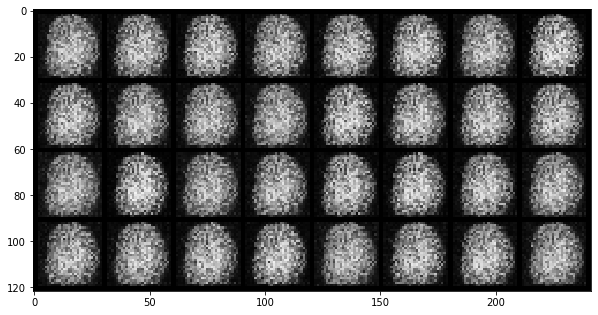

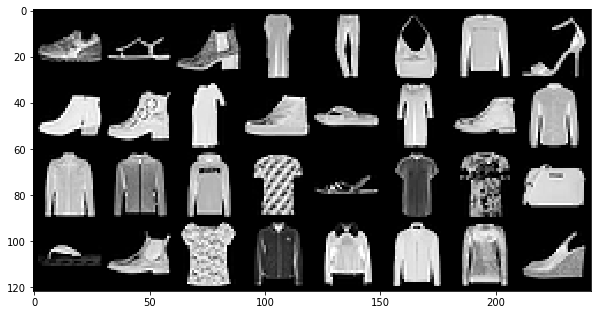

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1000: Generator loss: 1.341748080015183, discriminator loss: 0.36847958713769907


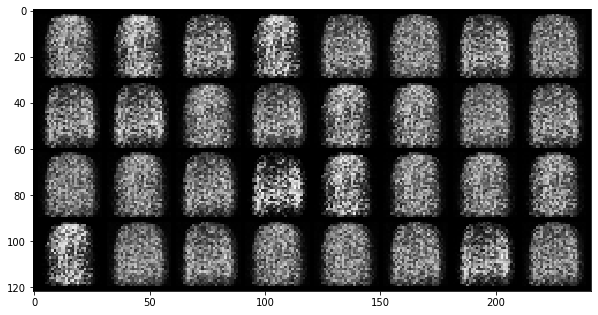

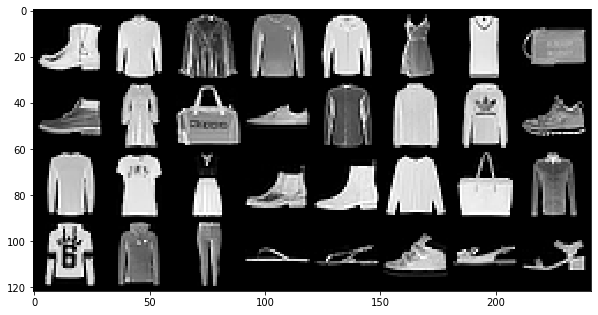

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1500: Generator loss: 1.2145677640438068, discriminator loss: 0.39827232462167744


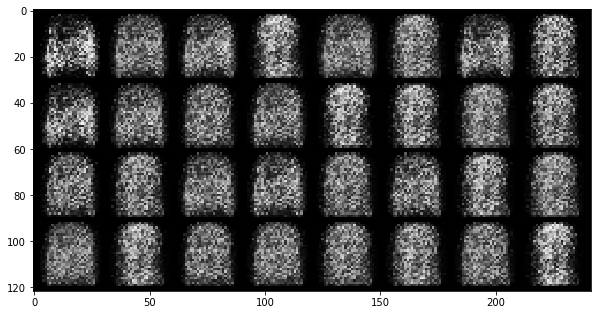

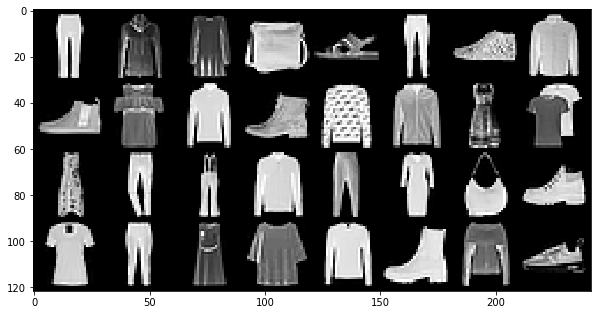

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2000: Generator loss: 1.2852534053325655, discriminator loss: 0.3630906001925471


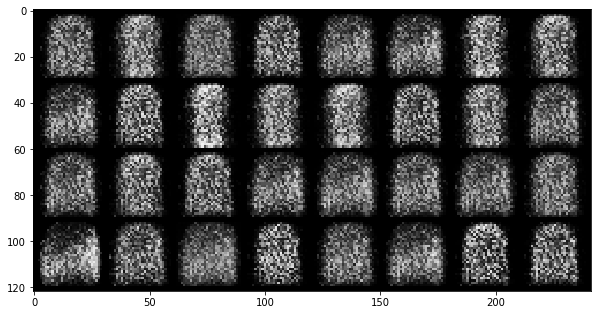

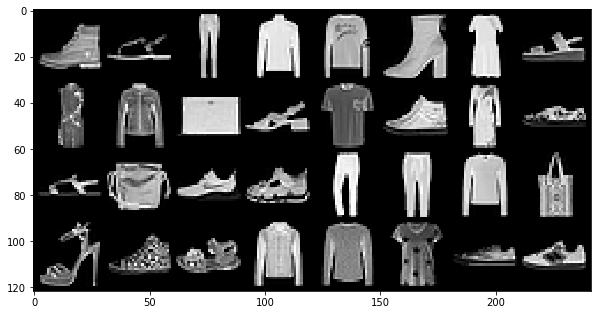

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2500: Generator loss: 1.2933843743801117, discriminator loss: 0.4083589020371435


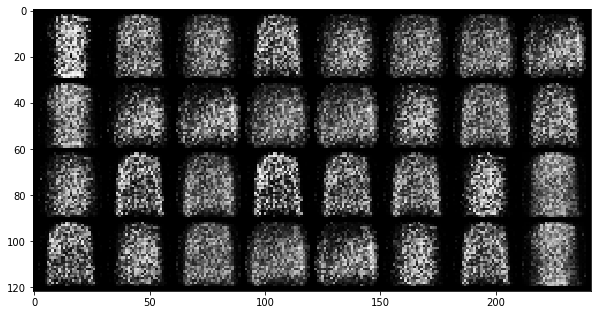

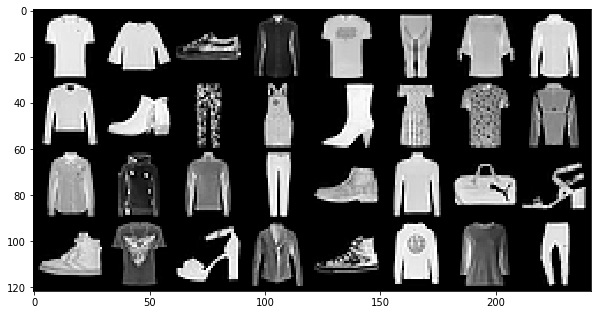

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3000: Generator loss: 1.3266129834651945, discriminator loss: 0.40258284407854045


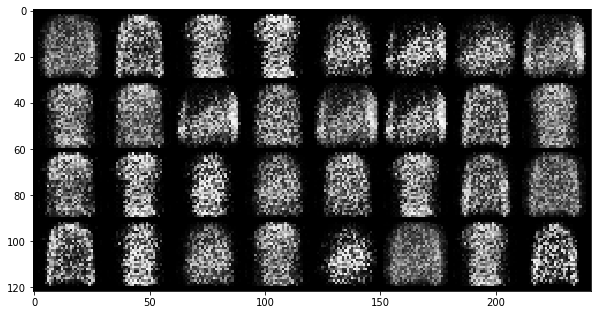

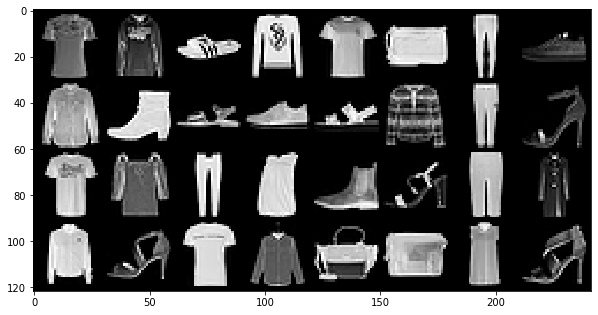

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3500: Generator loss: 1.4454266135692602, discriminator loss: 0.3830494995713228


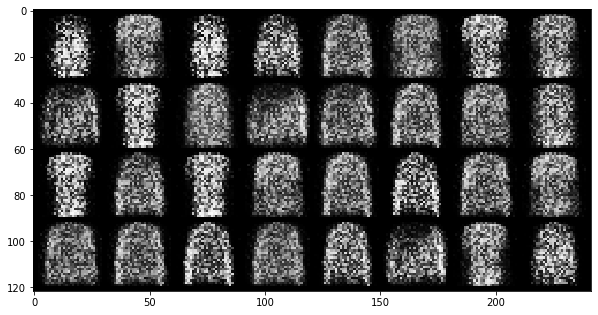

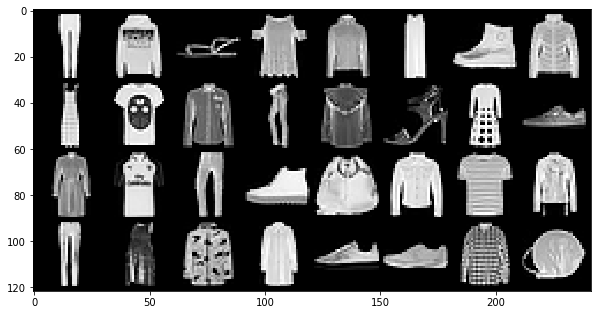

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4000: Generator loss: 1.4956950395107262, discriminator loss: 0.37355811357498137


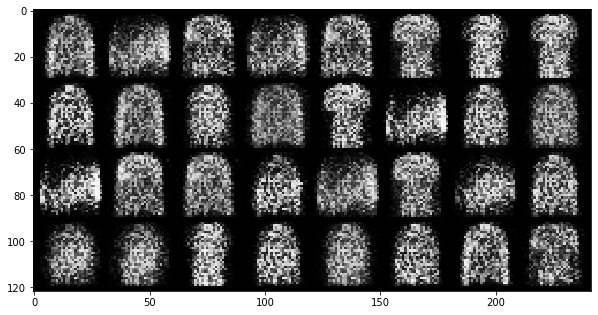

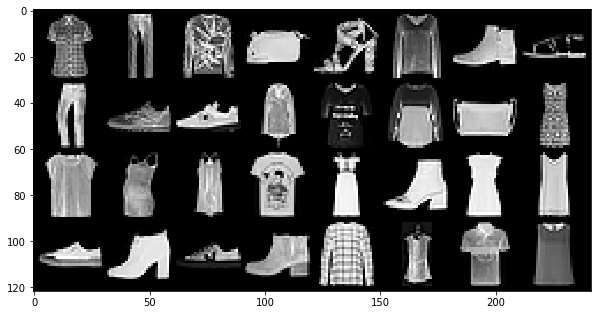

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4500: Generator loss: 1.5792678992748268, discriminator loss: 0.3771402655243873


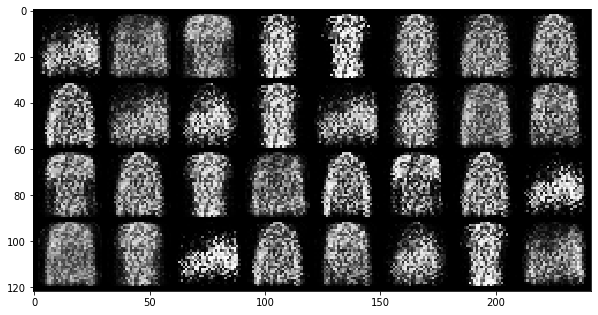

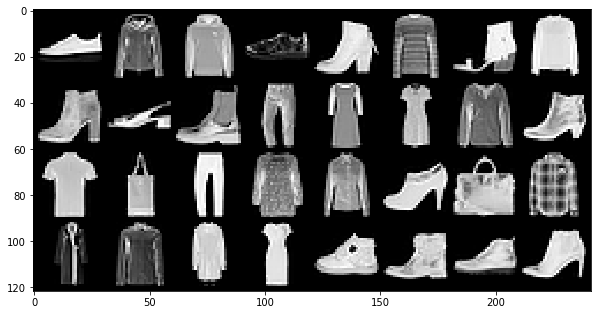

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5000: Generator loss: 1.6288210291862497, discriminator loss: 0.36943019616603884


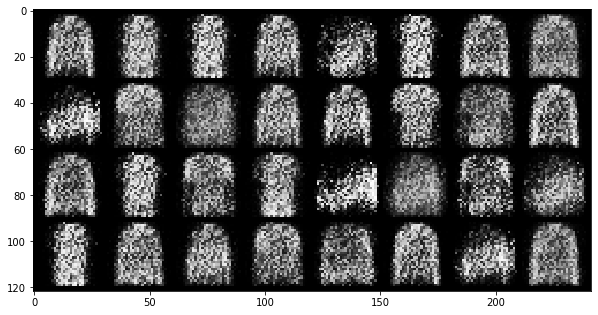

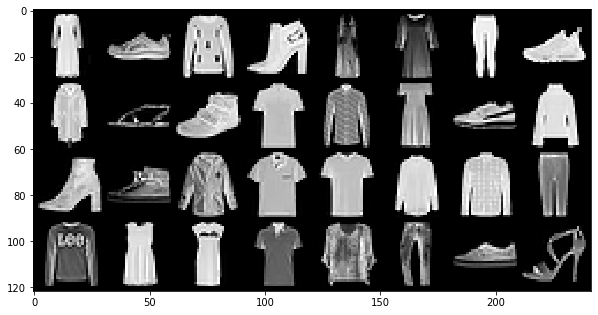

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5500: Generator loss: 1.6602317640781399, discriminator loss: 0.3525619225502012


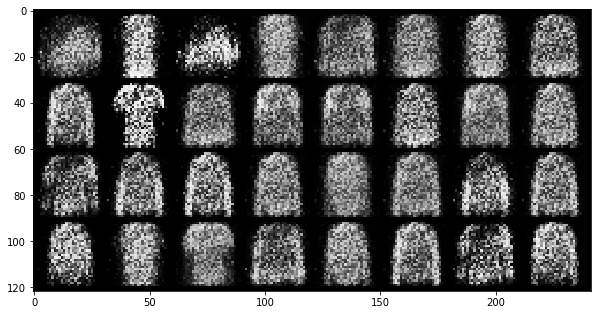

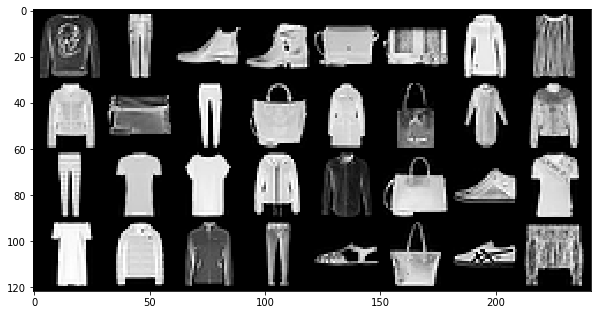

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6000: Generator loss: 1.7034002304077152, discriminator loss: 0.3520828548073765


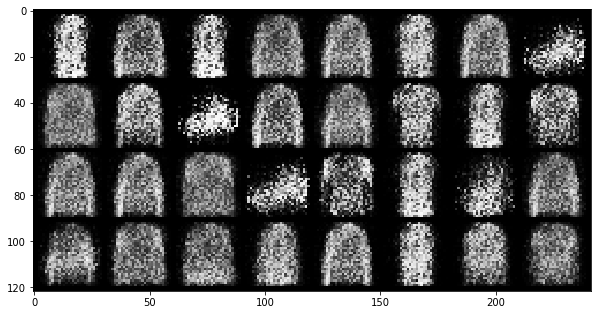

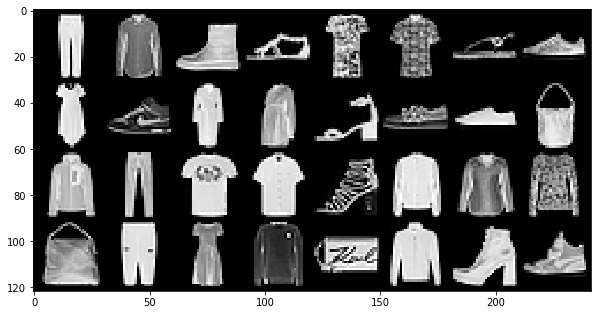

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6500: Generator loss: 1.6793951241970069, discriminator loss: 0.3552090836763382


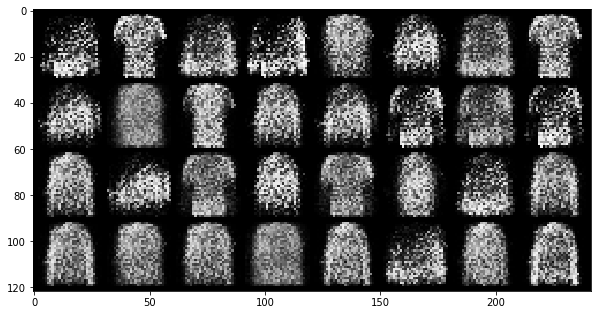

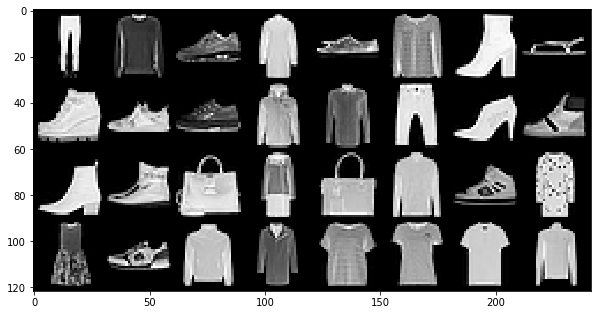

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7000: Generator loss: 1.6676626098155978, discriminator loss: 0.3686124211549761


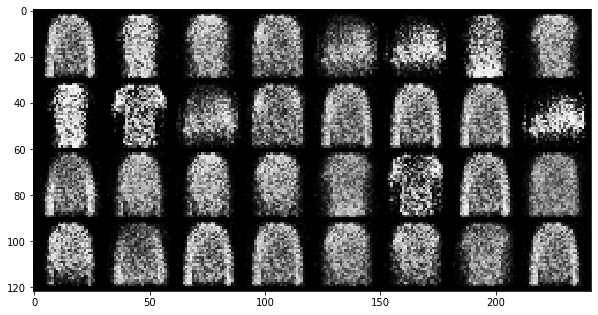

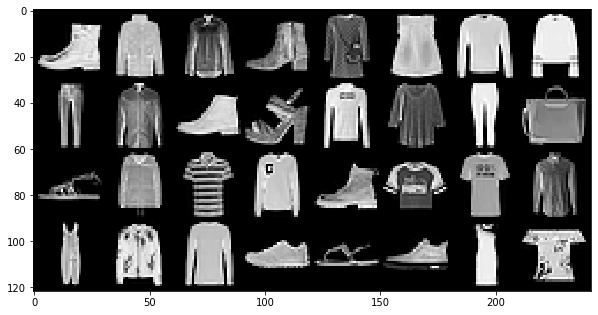

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7500: Generator loss: 1.604377878904344, discriminator loss: 0.36592284792661695


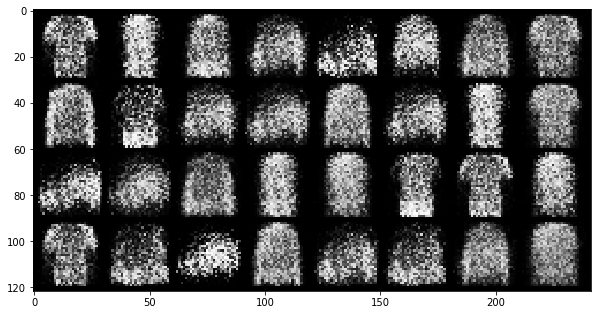

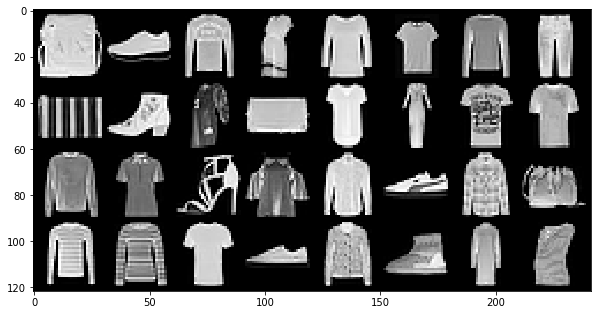

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8000: Generator loss: 1.6731395308971426, discriminator loss: 0.35651740312576324


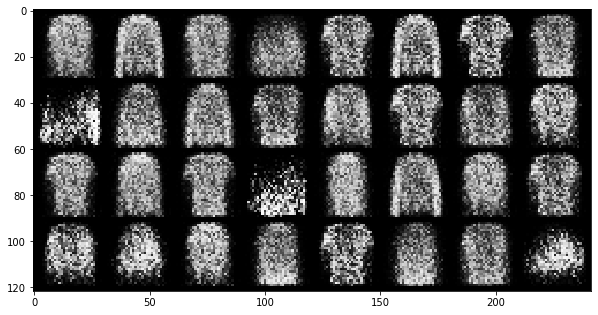

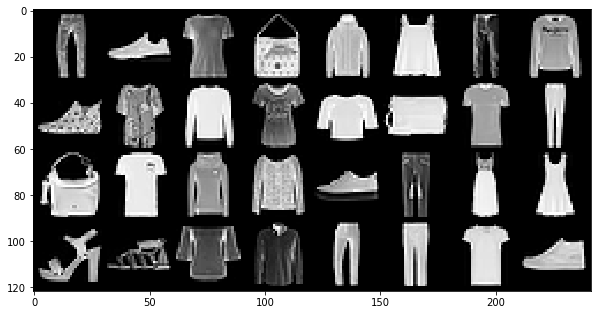

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8500: Generator loss: 1.63205692124367, discriminator loss: 0.3733314997553823


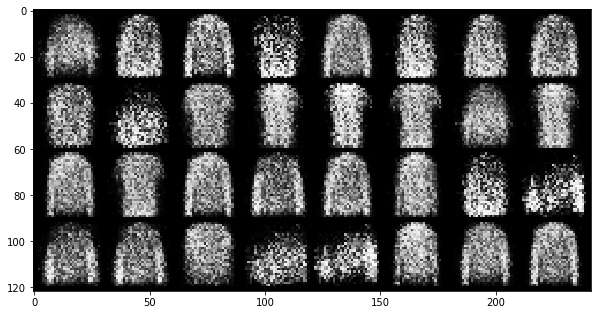

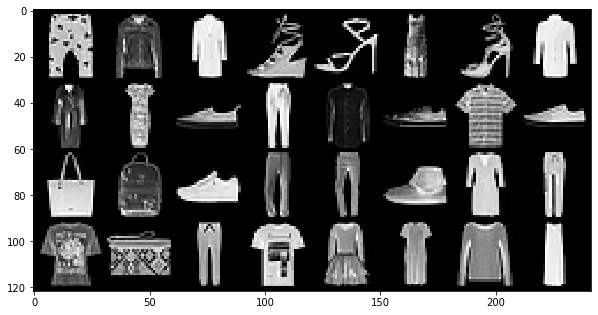

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9000: Generator loss: 1.6382227621078491, discriminator loss: 0.36302497309446313


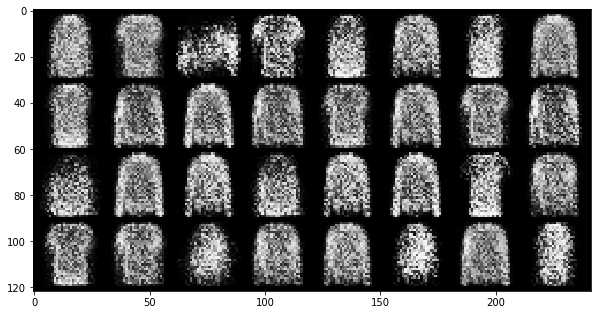

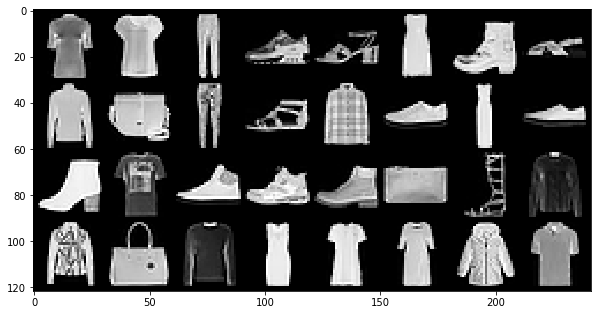

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9500: Generator loss: 1.6726426134109478, discriminator loss: 0.36716022062301673


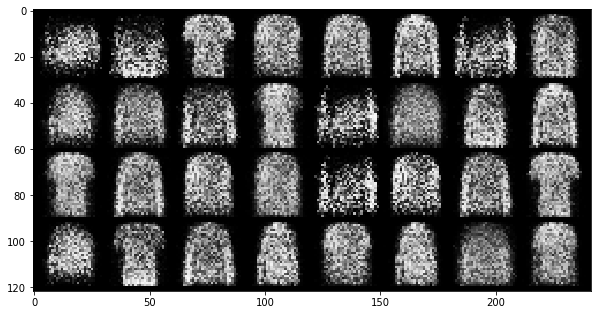

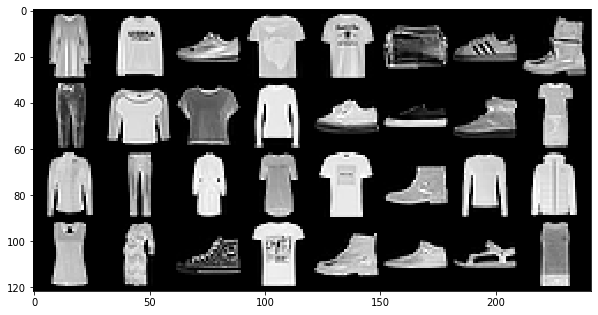

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10000: Generator loss: 1.6569412150382998, discriminator loss: 0.3769732153415684


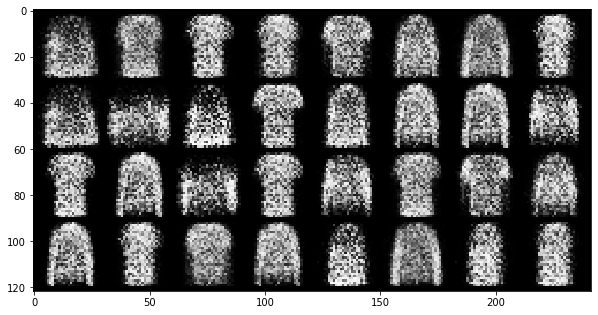

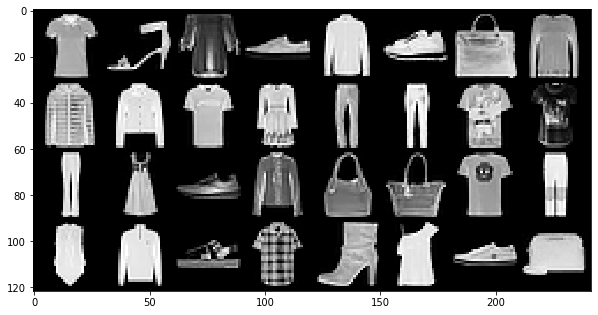

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10500: Generator loss: 1.5854464445114147, discriminator loss: 0.3827050120234489


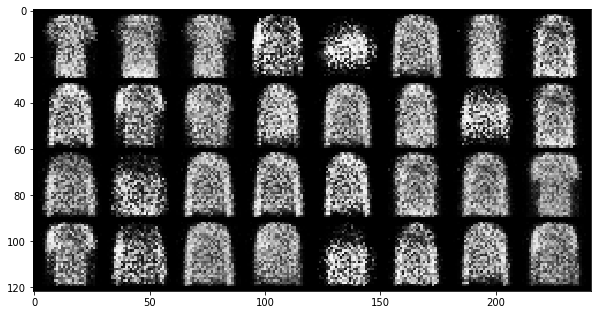

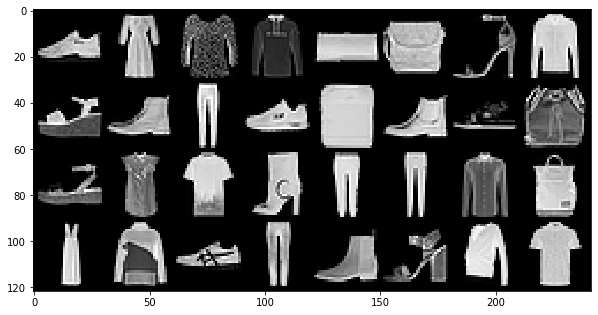

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11000: Generator loss: 1.5977515025138869, discriminator loss: 0.3933453119397168


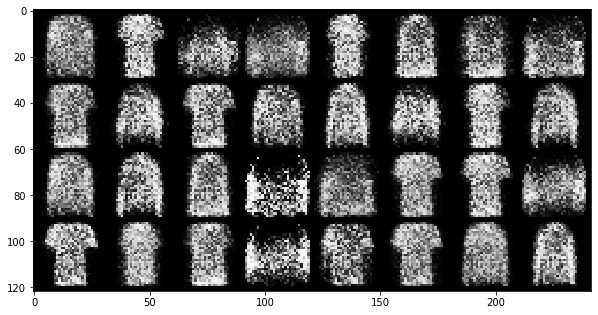

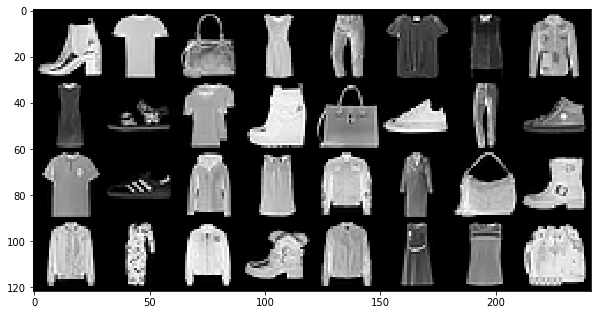

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11500: Generator loss: 1.6014146900177002, discriminator loss: 0.38646452587842894


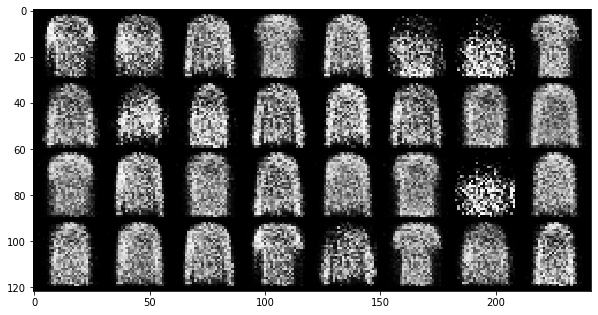

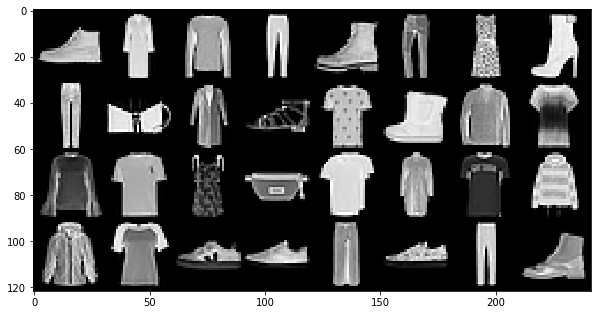

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12000: Generator loss: 1.6417039129734055, discriminator loss: 0.37323124265670776


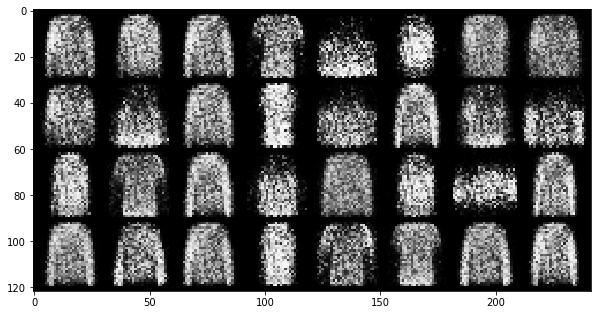

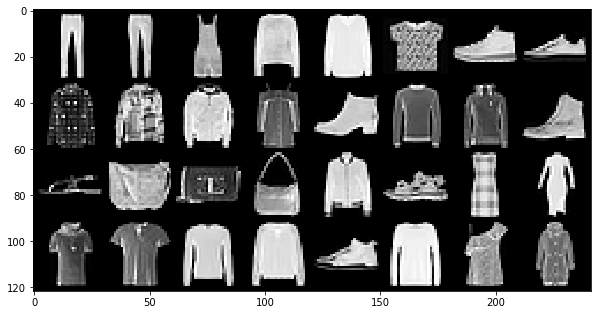

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12500: Generator loss: 1.5546442968845358, discriminator loss: 0.3998612985610961


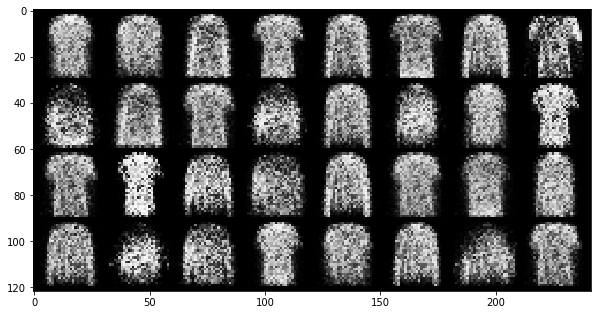

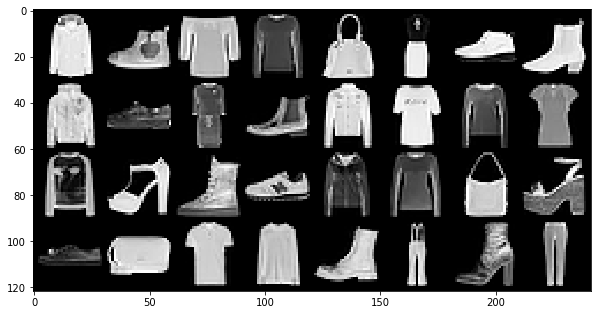

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13000: Generator loss: 1.5553470153808595, discriminator loss: 0.41017620670795474


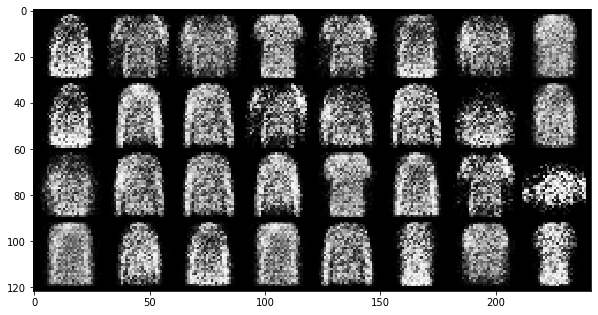

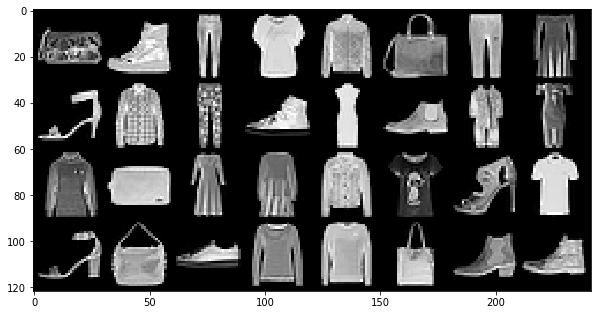

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13500: Generator loss: 1.4950228843688977, discriminator loss: 0.41433376598358185


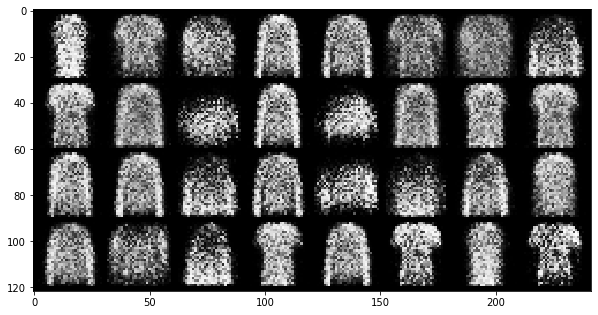

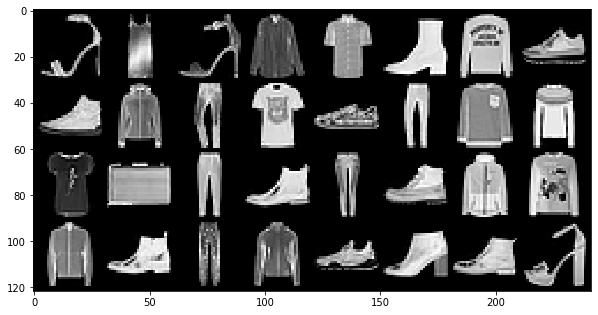

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14000: Generator loss: 1.54925041627884, discriminator loss: 0.4071744734644888


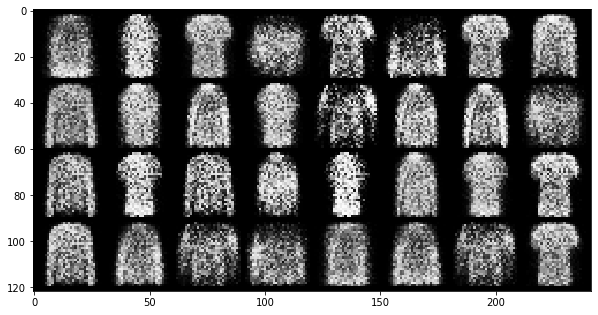

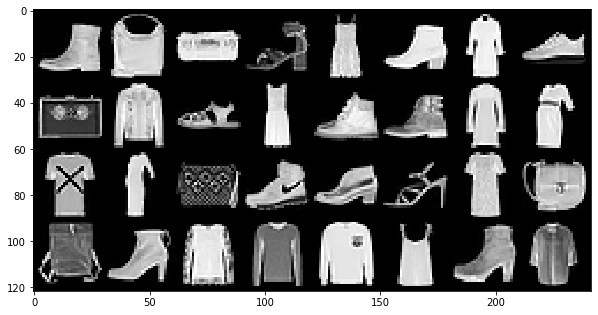

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14500: Generator loss: 1.6095695235729226, discriminator loss: 0.3976468690633772


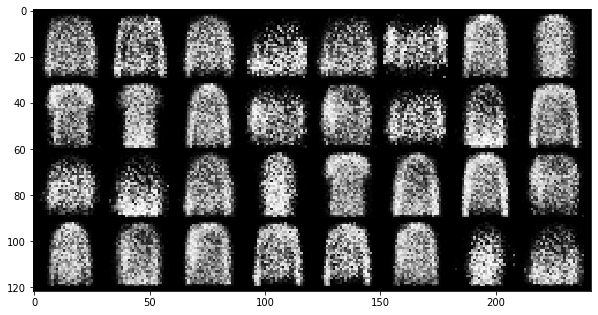

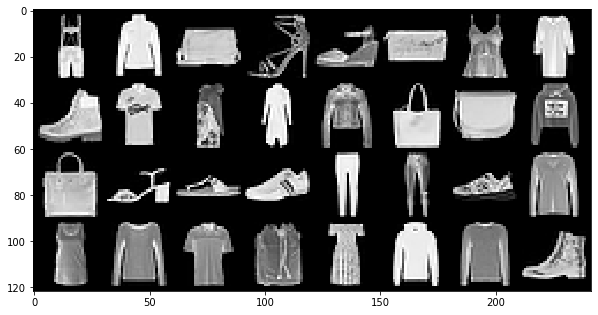

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15000: Generator loss: 1.5198464591503138, discriminator loss: 0.4070244834423063


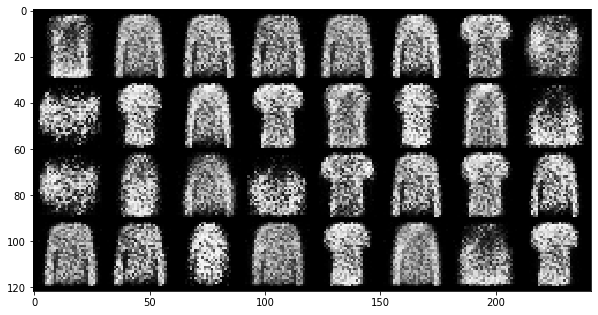

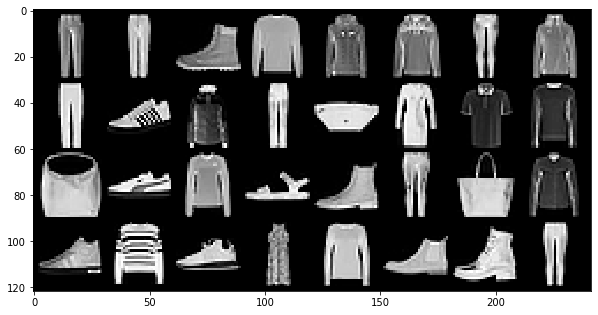

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15500: Generator loss: 1.5643259646892547, discriminator loss: 0.4018899261951451


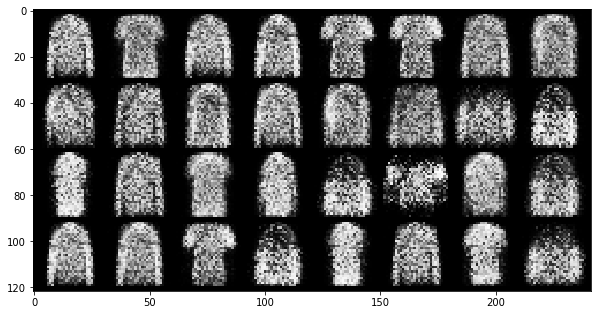

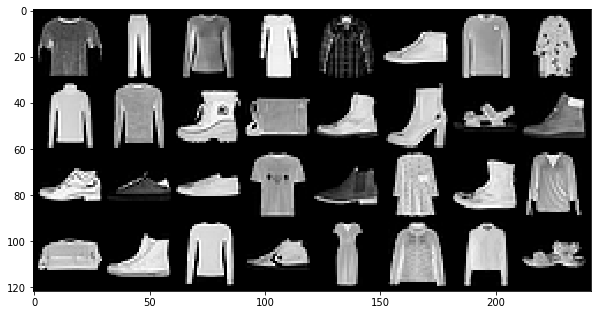

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16000: Generator loss: 1.5404768054485327, discriminator loss: 0.40427270734310156


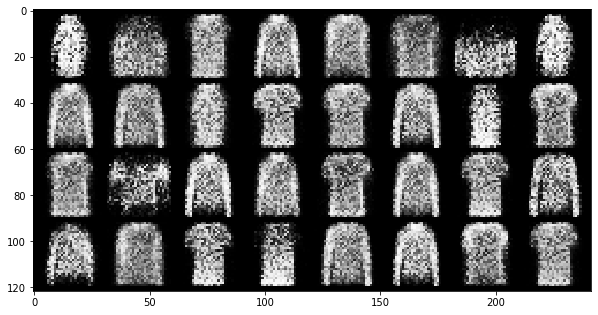

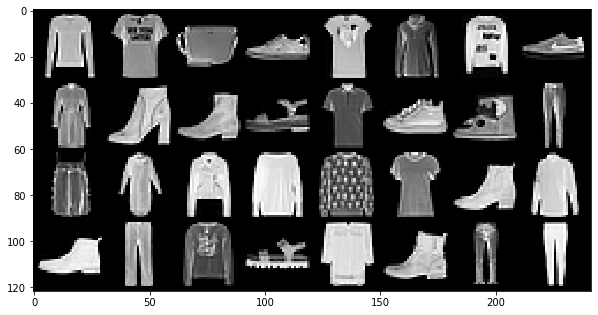

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16500: Generator loss: 1.451993517160415, discriminator loss: 0.4266936419010159


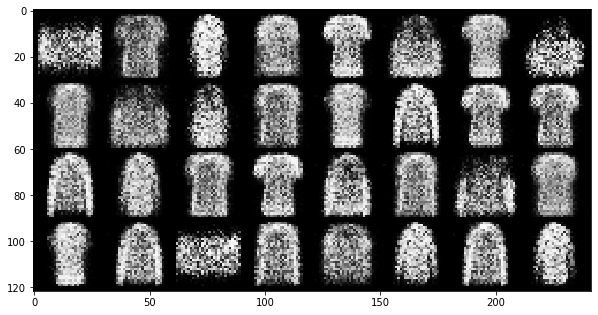

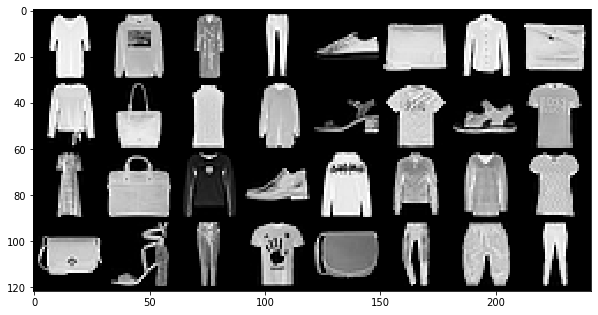

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17000: Generator loss: 1.4831164941787711, discriminator loss: 0.42249665790796254


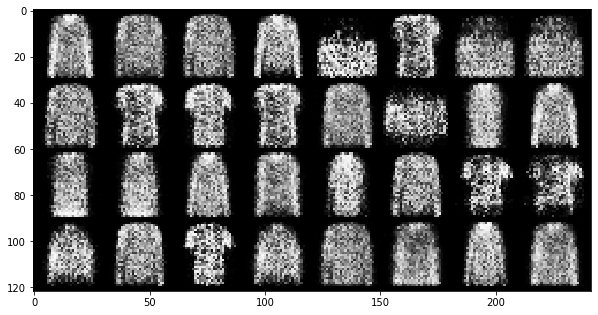

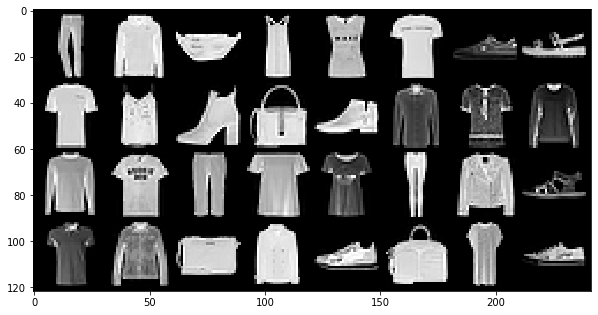

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17500: Generator loss: 1.4422213261127481, discriminator loss: 0.43575051122903863


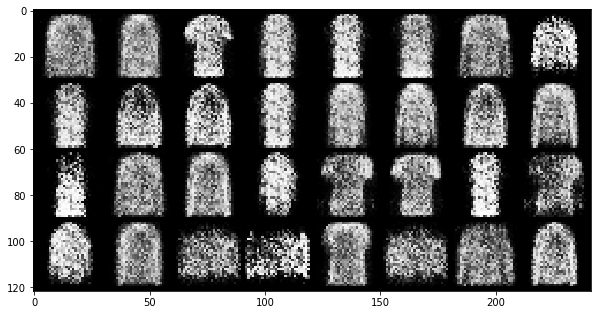

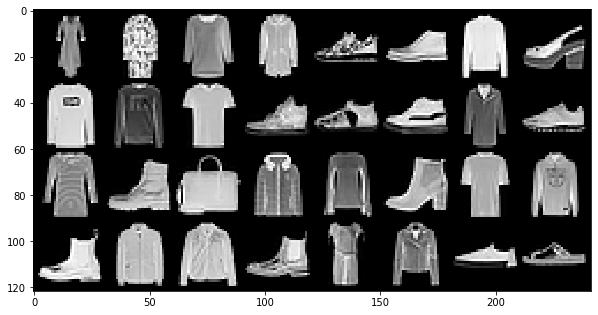

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18000: Generator loss: 1.4116542263031029, discriminator loss: 0.43963725775480256


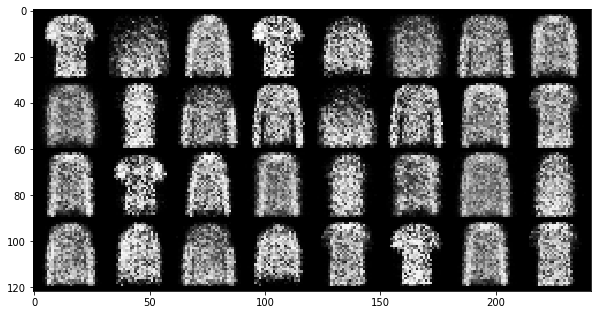

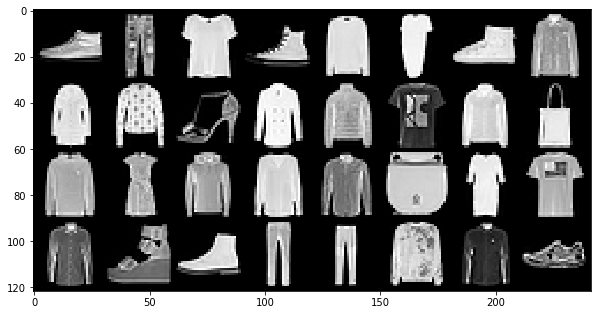

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18500: Generator loss: 1.4051270022392277, discriminator loss: 0.43963121598959


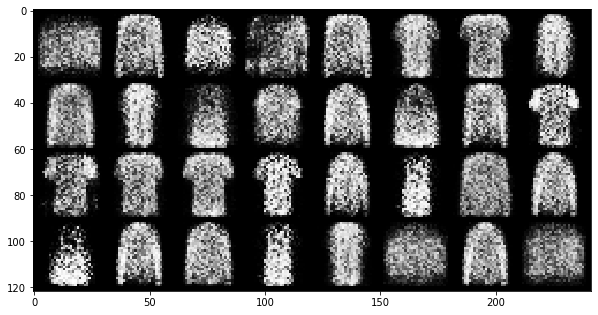

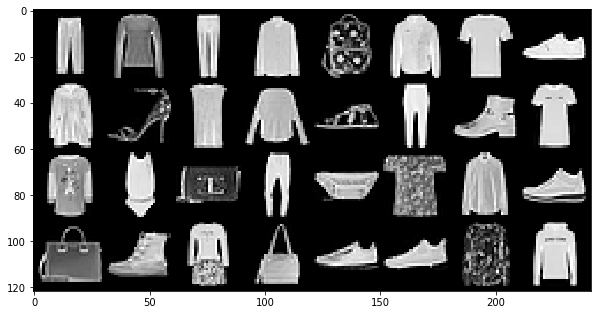

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19000: Generator loss: 1.44416202378273, discriminator loss: 0.44316095101833347


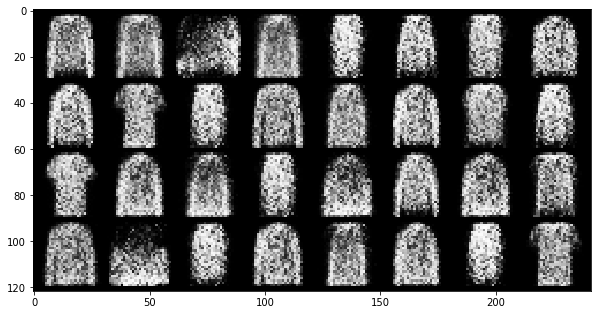

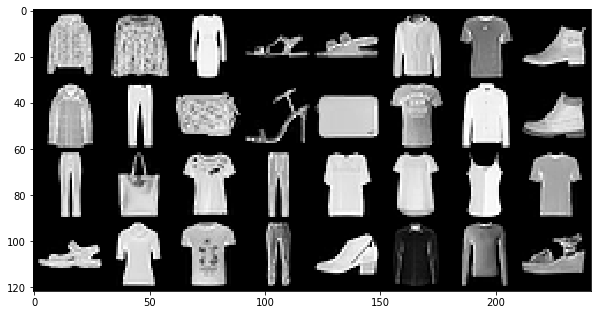

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19500: Generator loss: 1.3426068351268776, discriminator loss: 0.4582123764157297


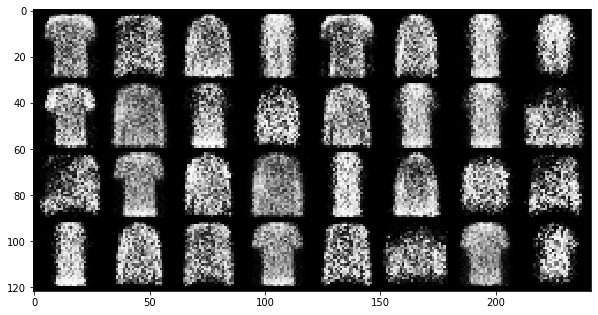

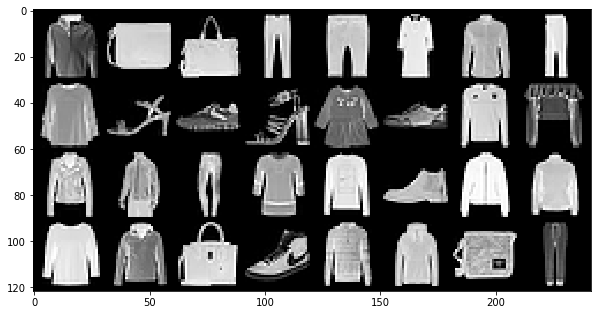

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20000: Generator loss: 1.314937975168229, discriminator loss: 0.46506109374761534


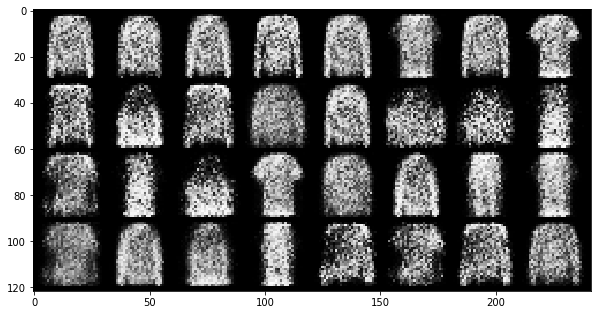

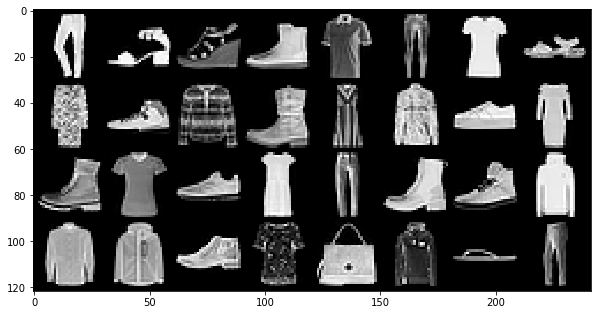

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20500: Generator loss: 1.3982693092823033, discriminator loss: 0.43218281936645486


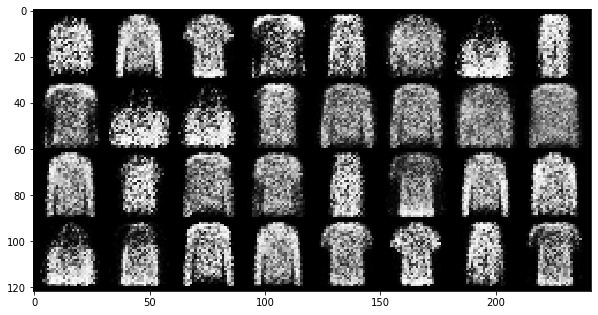

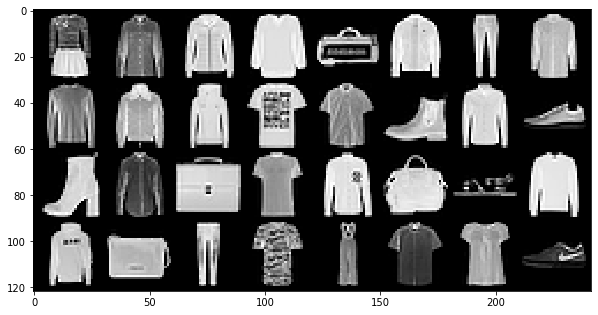

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21000: Generator loss: 1.3403322293758384, discriminator loss: 0.4539916186332705


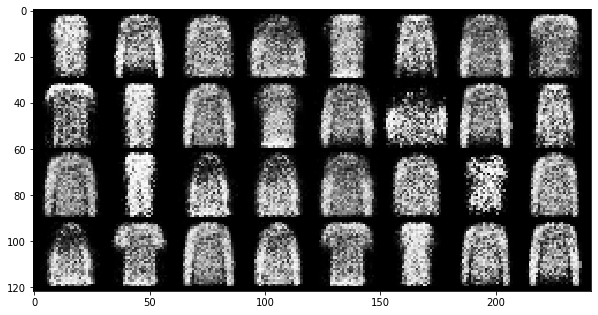

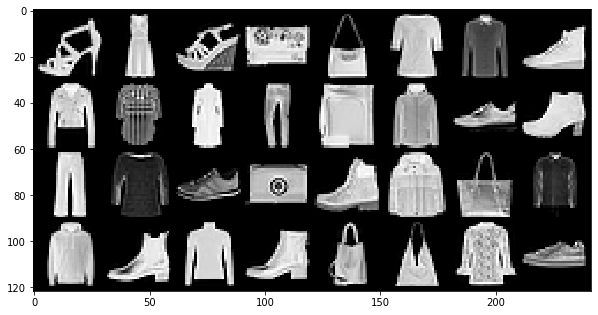

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21500: Generator loss: 1.3925406651496883, discriminator loss: 0.45084596043825115


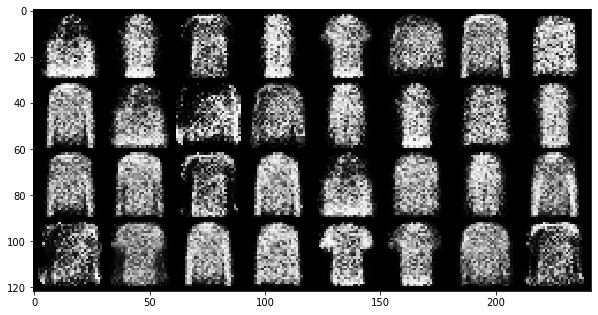

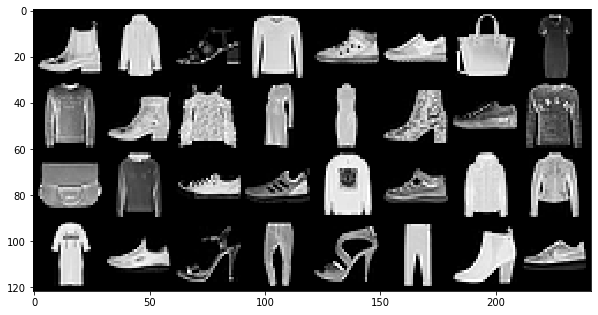

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22000: Generator loss: 1.3557034597396846, discriminator loss: 0.4538228390216827


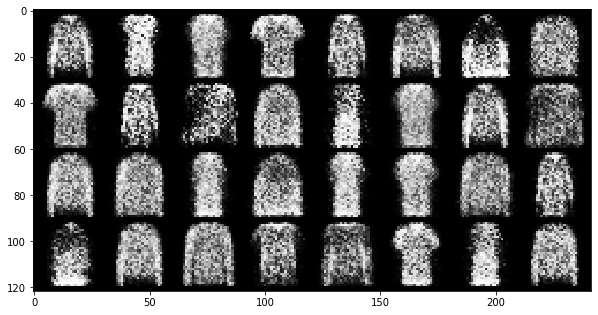

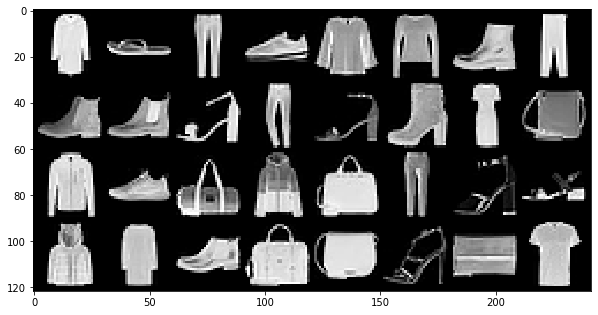

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22500: Generator loss: 1.3133924117088323, discriminator loss: 0.45862501221895163


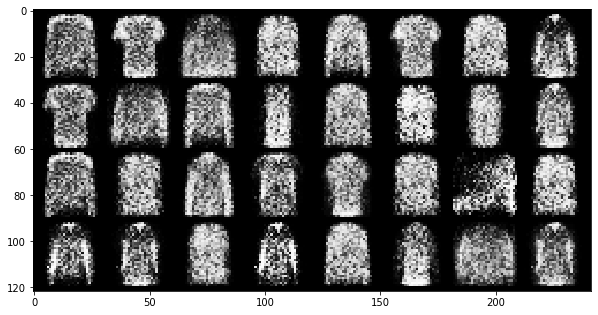

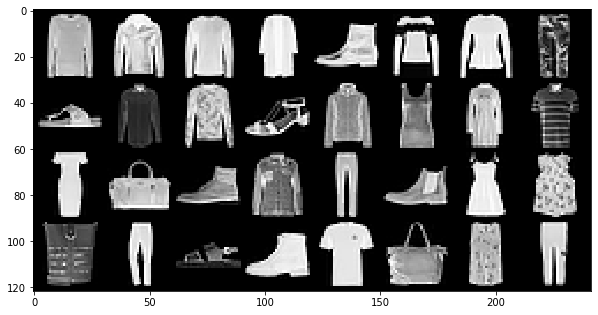

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23000: Generator loss: 1.369431787014008, discriminator loss: 0.4426092402935029


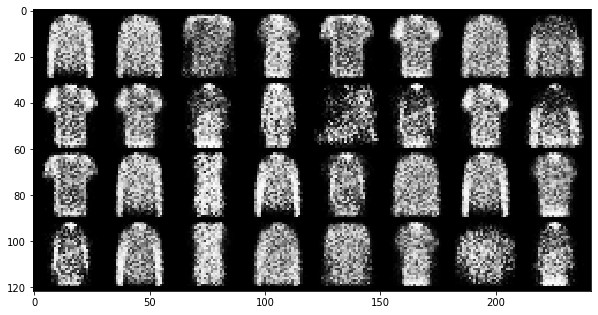

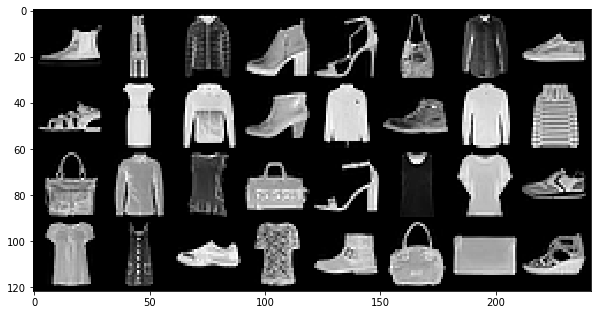

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23500: Generator loss: 1.3517225615978232, discriminator loss: 0.45135957235097873


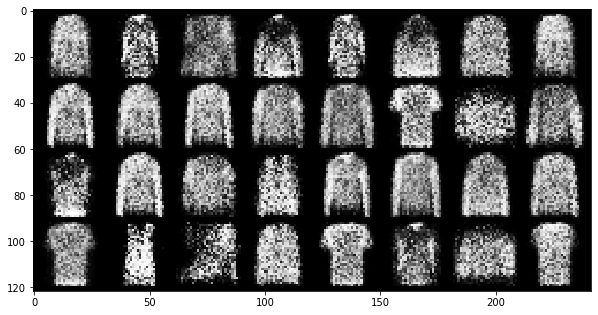

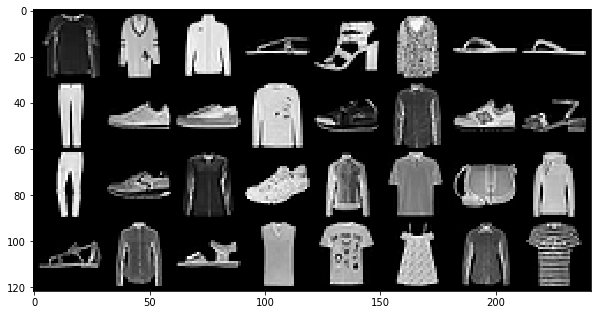

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24000: Generator loss: 1.366605893611909, discriminator loss: 0.4302093794941905


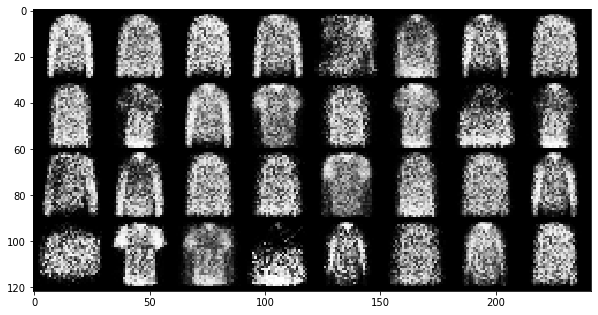

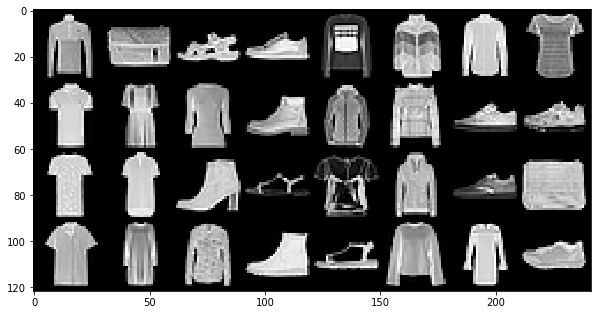

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24500: Generator loss: 1.3475028760433208, discriminator loss: 0.44154138743877386


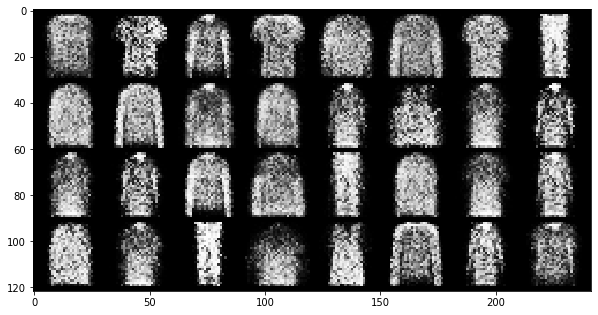

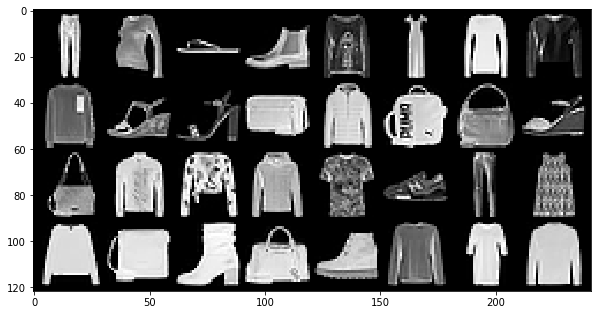

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25000: Generator loss: 1.334783920288086, discriminator loss: 0.4409738087058066


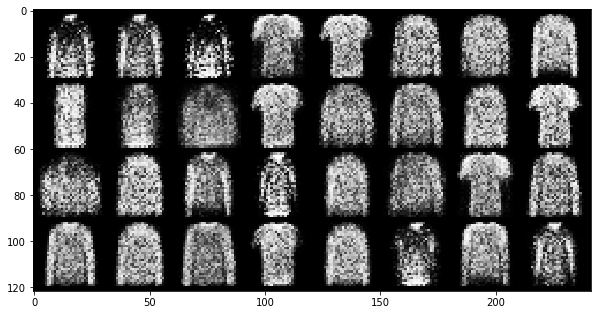

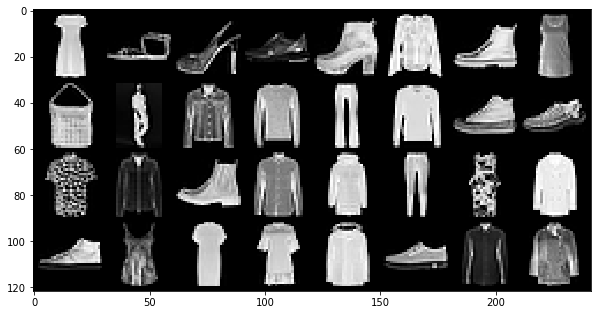

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25500: Generator loss: 1.3700419561862924, discriminator loss: 0.43327072447538356


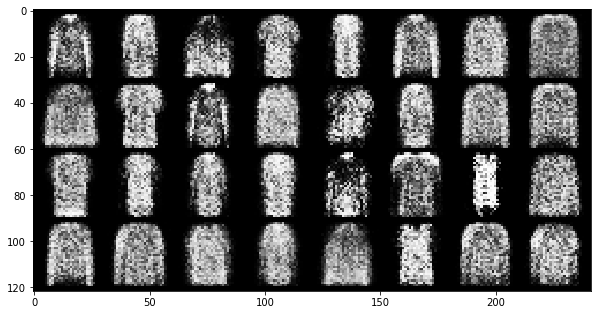

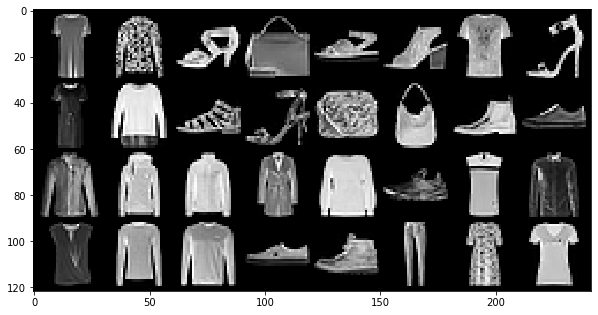

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26000: Generator loss: 1.3051091985702516, discriminator loss: 0.4483458587527279


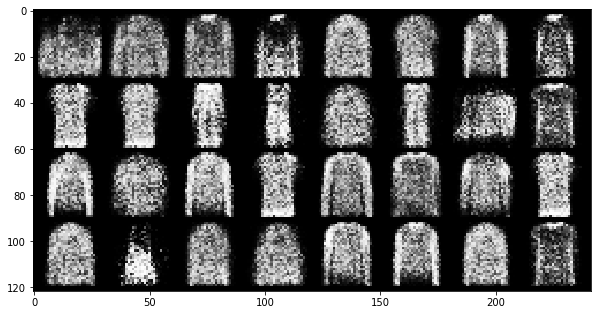

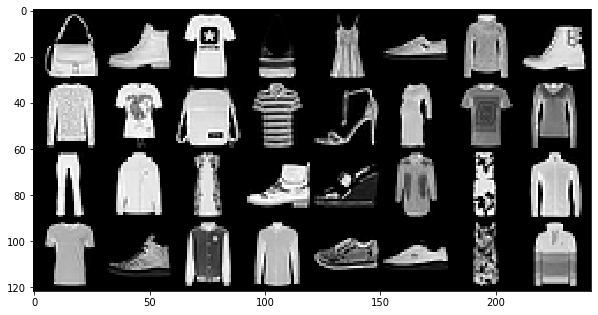

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26500: Generator loss: 1.3568179035186765, discriminator loss: 0.4388482071757318


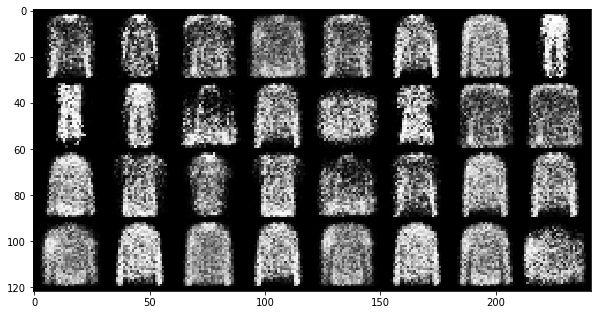

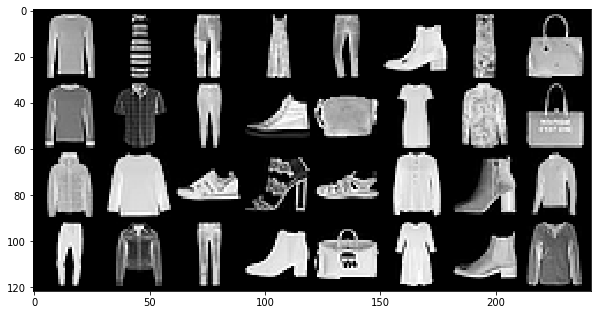

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27000: Generator loss: 1.323198318719863, discriminator loss: 0.44510501819848985


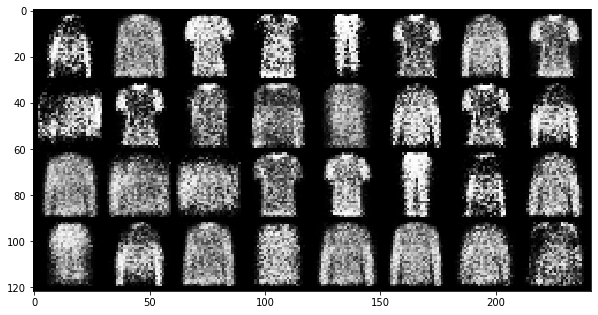

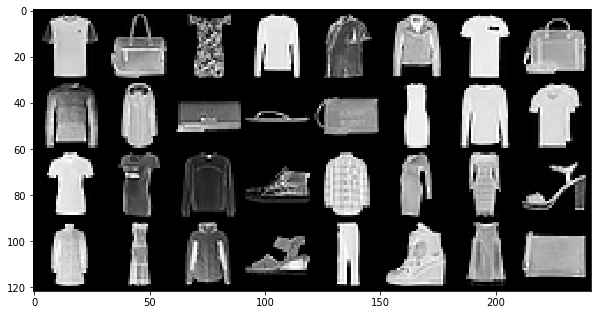

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27500: Generator loss: 1.3325744576454155, discriminator loss: 0.4404492331147189


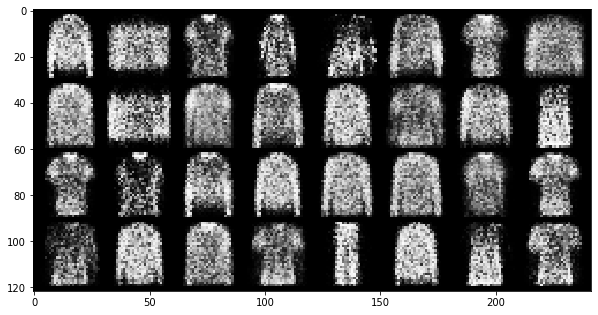

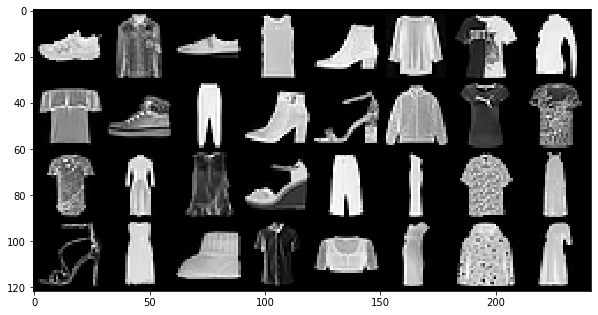

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28000: Generator loss: 1.2754085257053378, discriminator loss: 0.45647650164365783


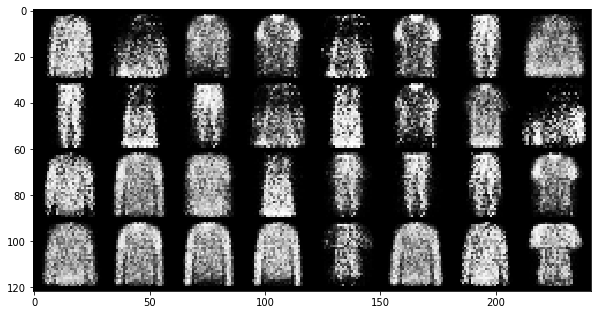

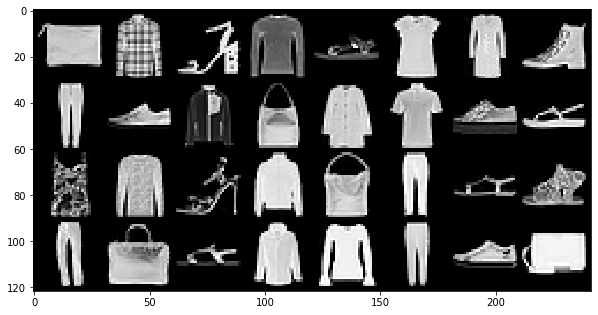

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28500: Generator loss: 1.3191472451686854, discriminator loss: 0.4361858423948291


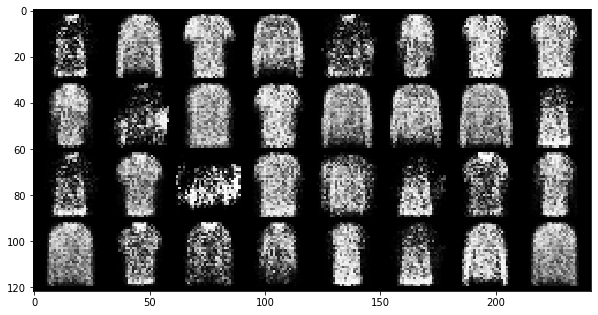

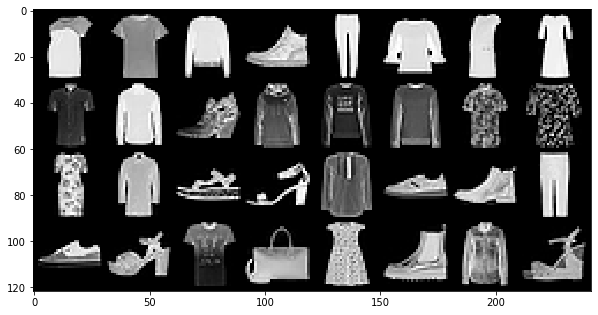

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29000: Generator loss: 1.322622083425523, discriminator loss: 0.4402894383072854


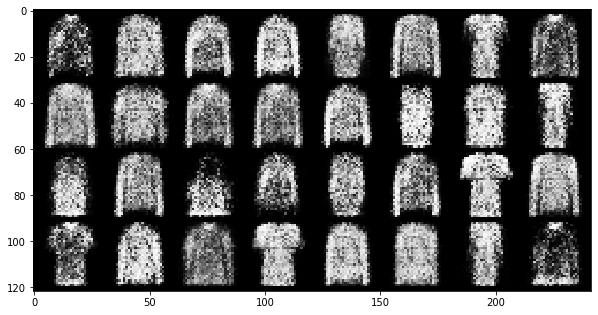

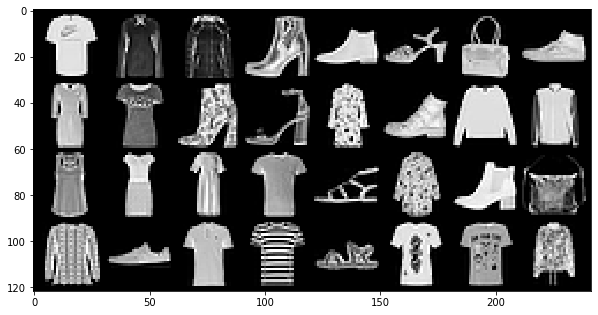

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29500: Generator loss: 1.2765695905685415, discriminator loss: 0.45911470347642896


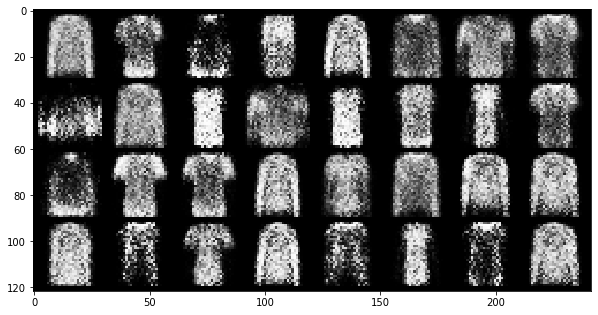

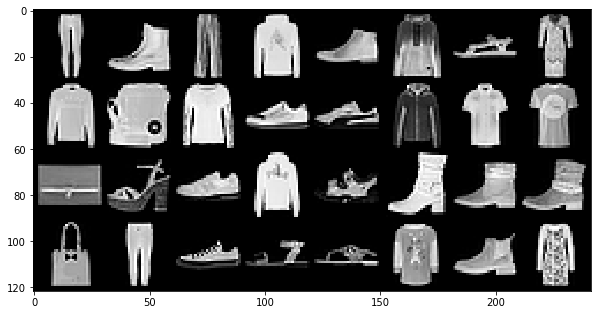

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30000: Generator loss: 1.1914746546745303, discriminator loss: 0.48777597326040323


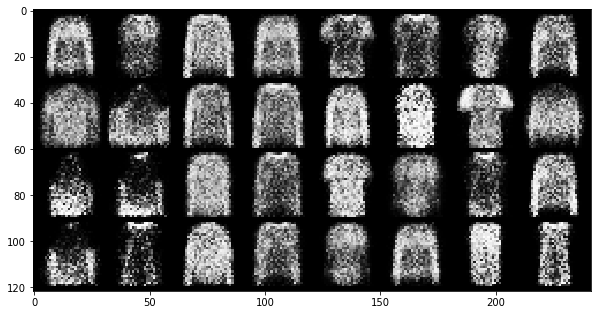

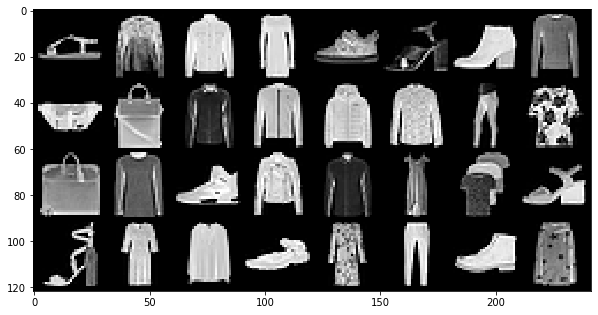

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30500: Generator loss: 1.197475291728975, discriminator loss: 0.48431908559799214


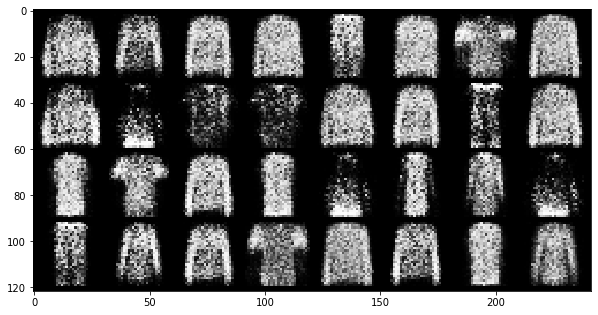

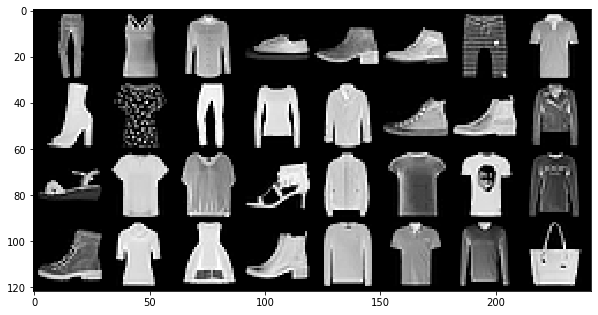

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31000: Generator loss: 1.1735298318862915, discriminator loss: 0.48418225693702704


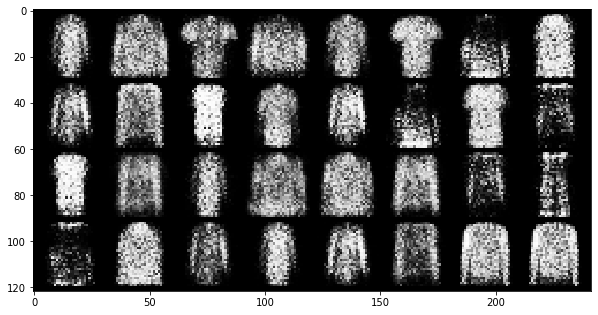

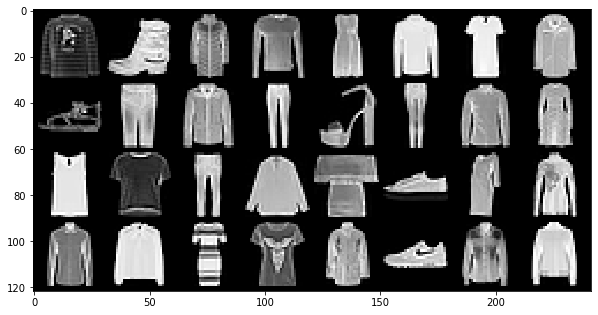

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31500: Generator loss: 1.1447328159809118, discriminator loss: 0.4775144637227062


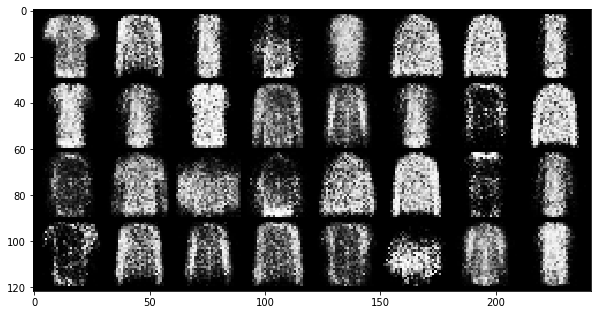

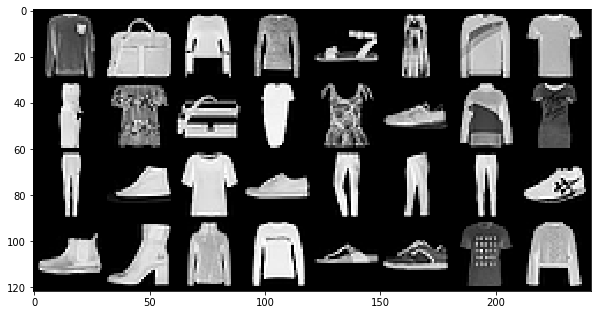

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32000: Generator loss: 1.177259389638901, discriminator loss: 0.47181284928321826


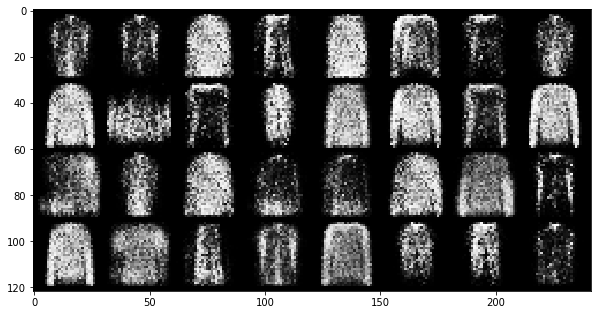

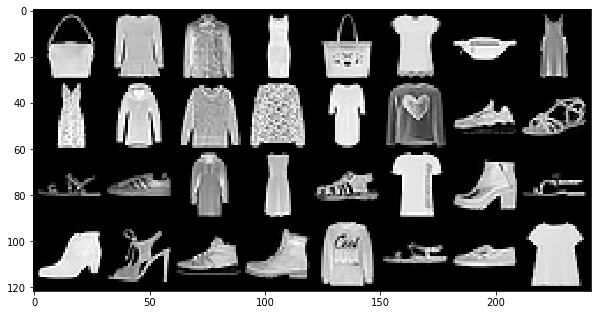

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32500: Generator loss: 1.1025234456062307, discriminator loss: 0.5033369277715686


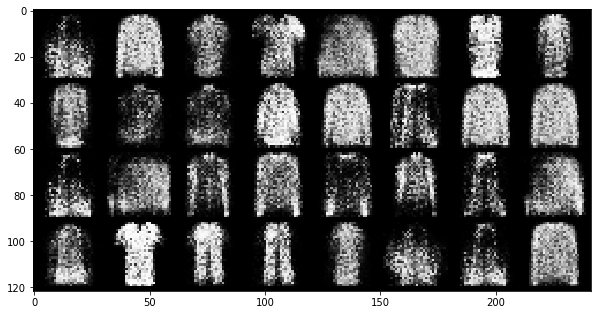

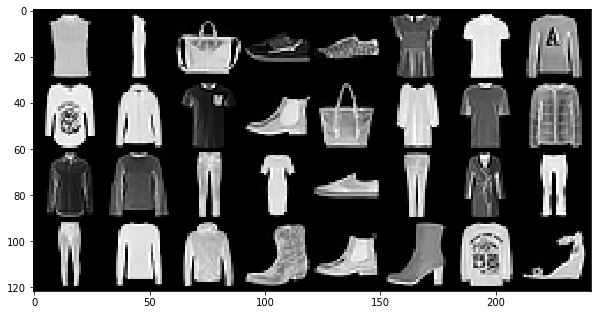

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33000: Generator loss: 1.107482253551482, discriminator loss: 0.5044953196048737


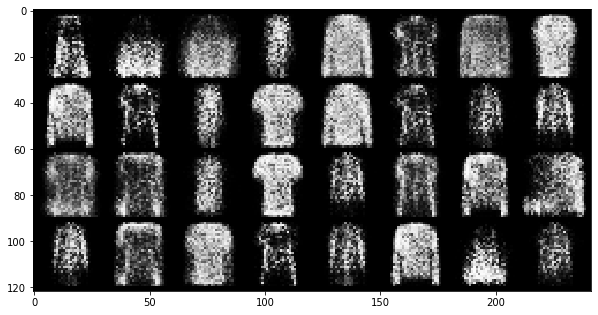

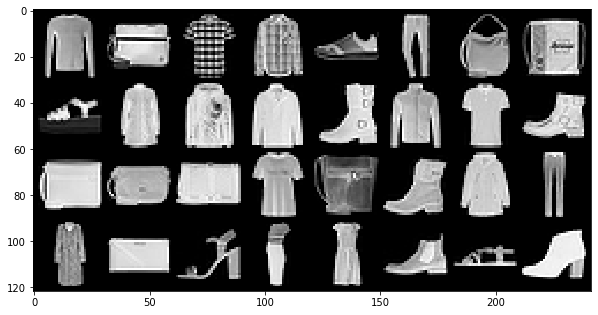

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33500: Generator loss: 1.0918392992019668, discriminator loss: 0.5007253245711326


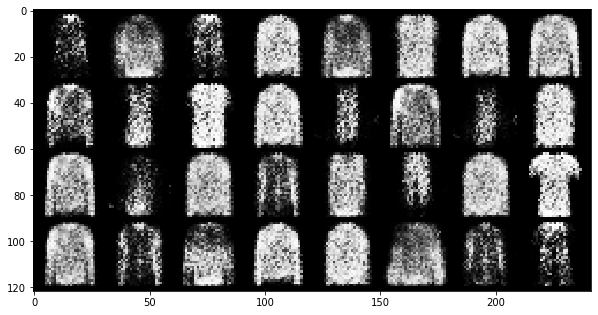

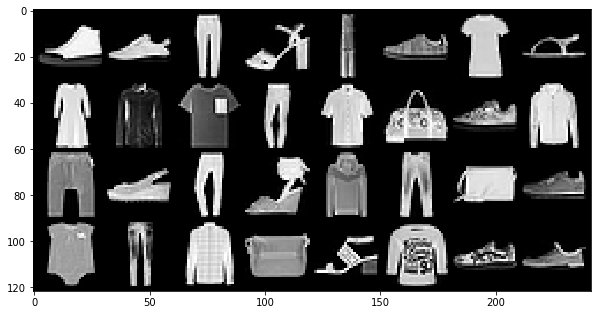

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34000: Generator loss: 1.0607579480409628, discriminator loss: 0.5166598917245863


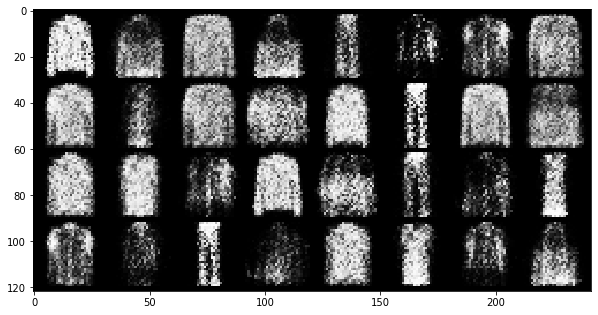

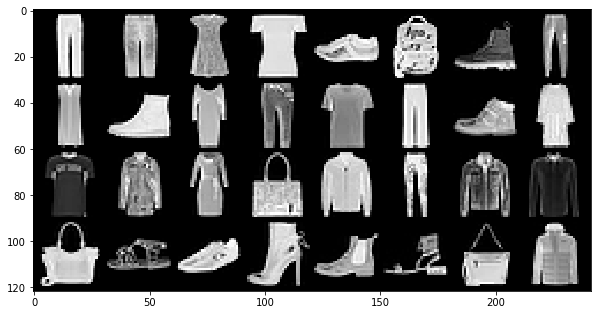

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34500: Generator loss: 1.035871332168579, discriminator loss: 0.5311351443529132


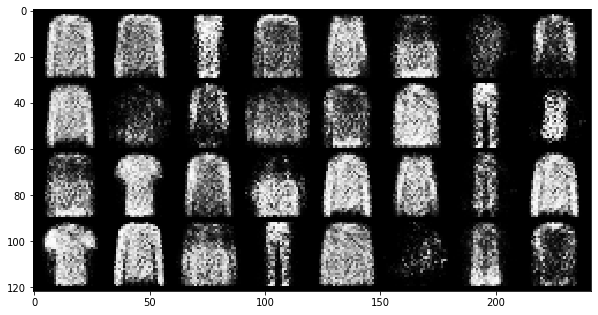

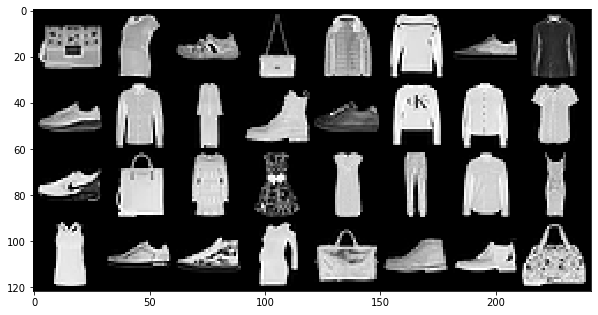

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35000: Generator loss: 1.0086284000873567, discriminator loss: 0.5382374020218851


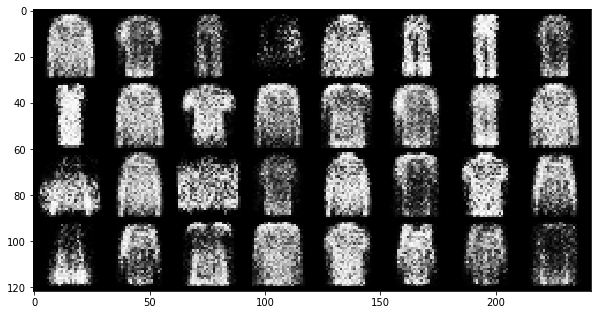

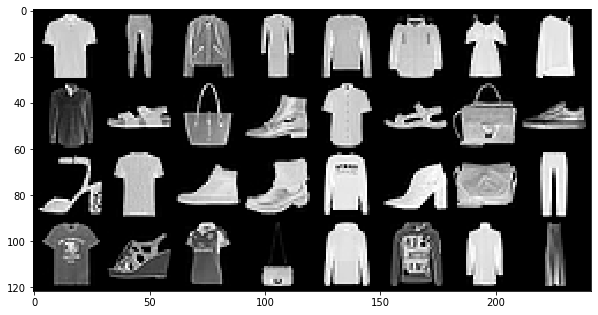

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35500: Generator loss: 1.0423320682048807, discriminator loss: 0.5300006846189503


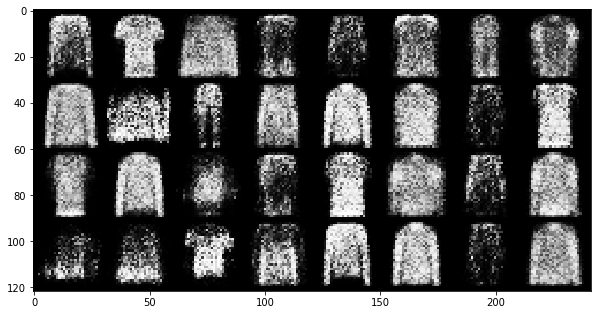

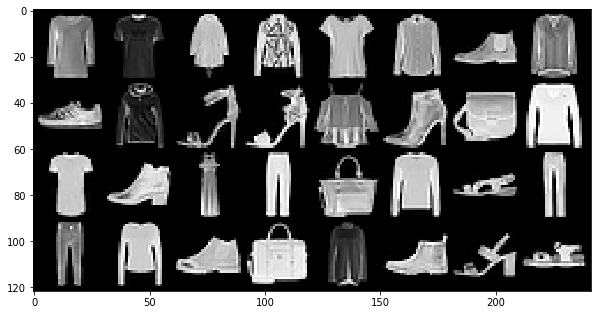

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36000: Generator loss: 1.0242904686927796, discriminator loss: 0.5389131776690483


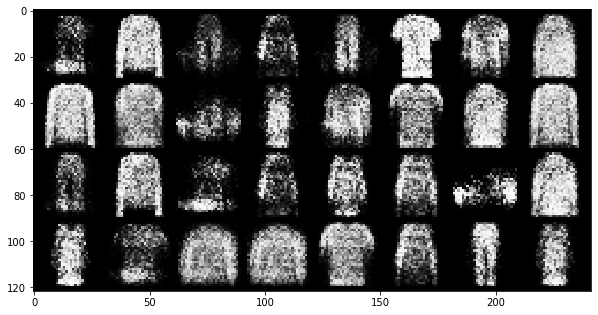

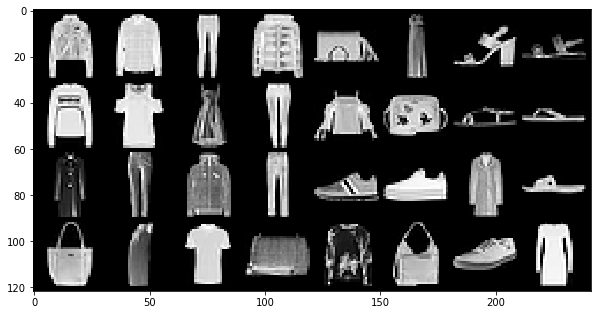

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36500: Generator loss: 0.9914004883766173, discriminator loss: 0.5509945884346968


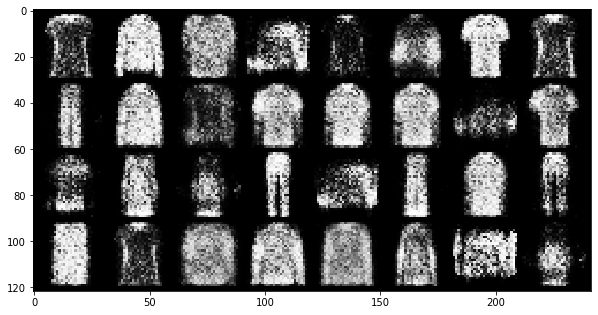

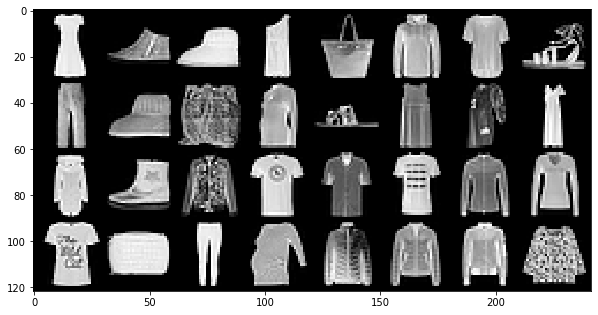

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37000: Generator loss: 1.0005684970617292, discriminator loss: 0.5522344982028006


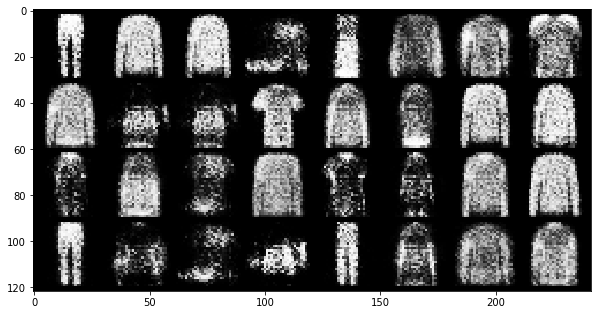

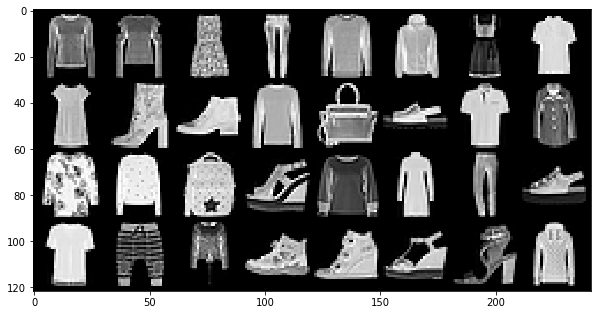

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37500: Generator loss: 0.9818630084991459, discriminator loss: 0.5526788366436961


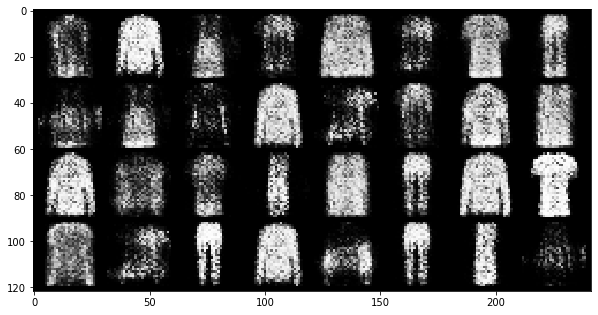

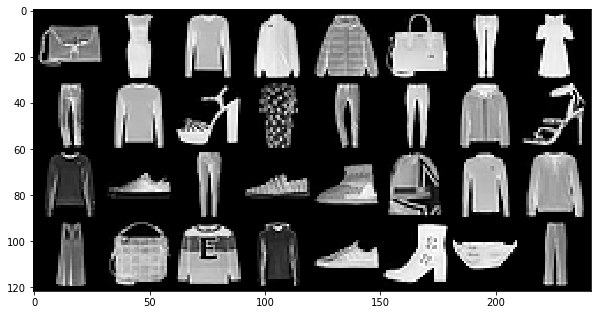

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38000: Generator loss: 0.9949035832881922, discriminator loss: 0.5433348901867863


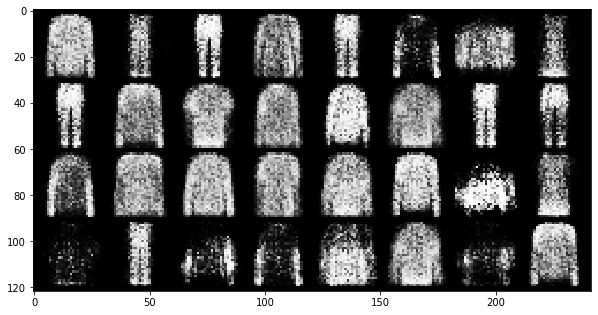

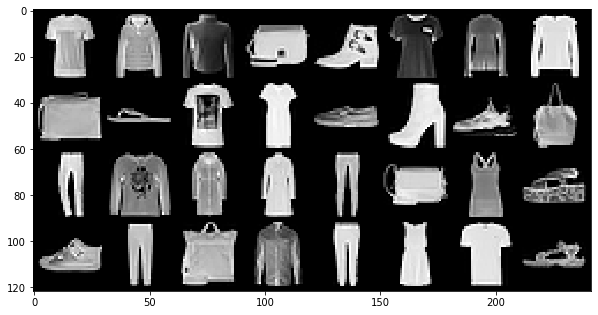

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38500: Generator loss: 0.9713802747726431, discriminator loss: 0.5493925677537919


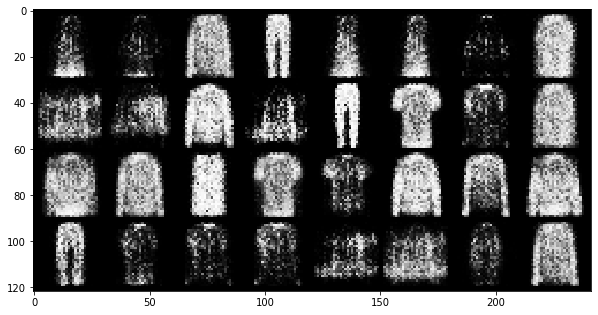

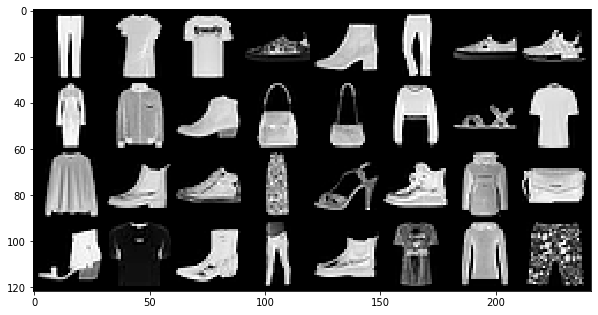

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39000: Generator loss: 0.9628451867103571, discriminator loss: 0.5541524873375899


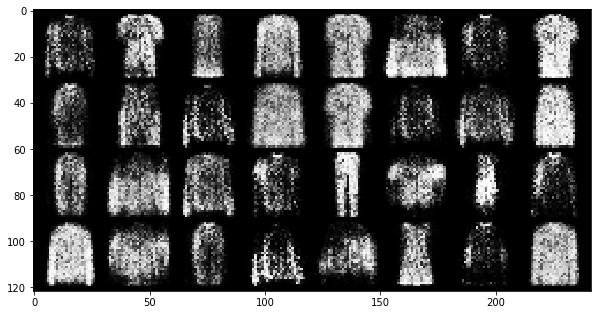

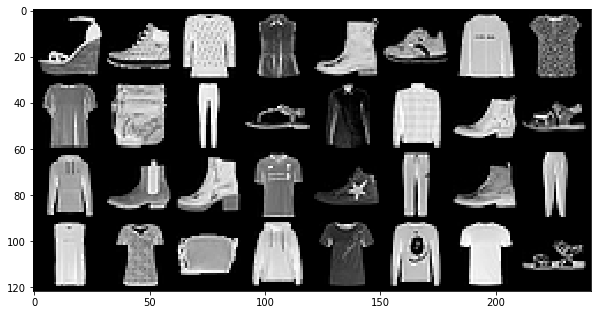

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39500: Generator loss: 0.999631766200066, discriminator loss: 0.5444207981228819


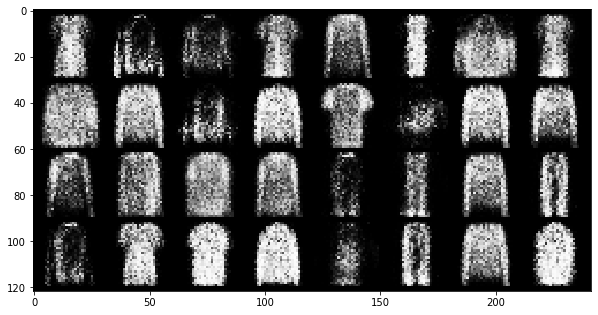

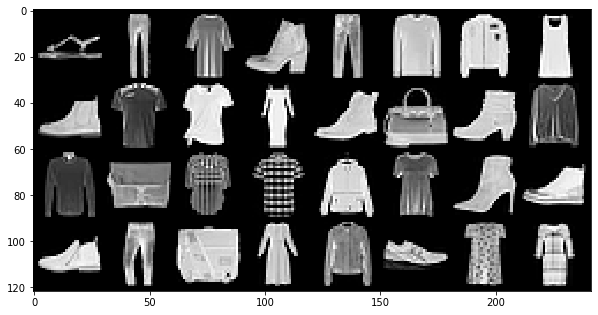

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40000: Generator loss: 0.9408344187736508, discriminator loss: 0.5601739610433579


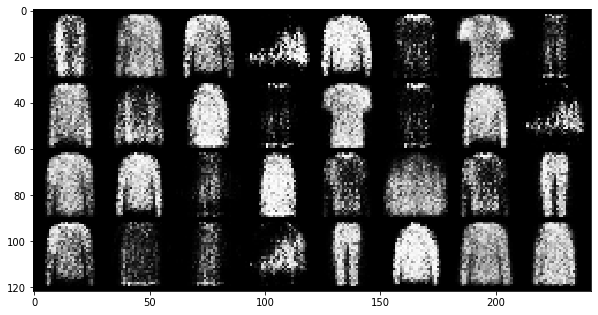

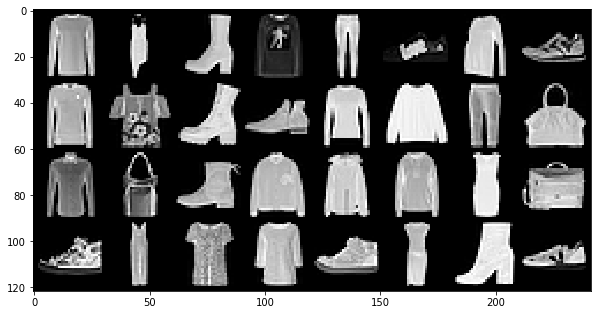

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40500: Generator loss: 0.9950791847705842, discriminator loss: 0.5587792747020719


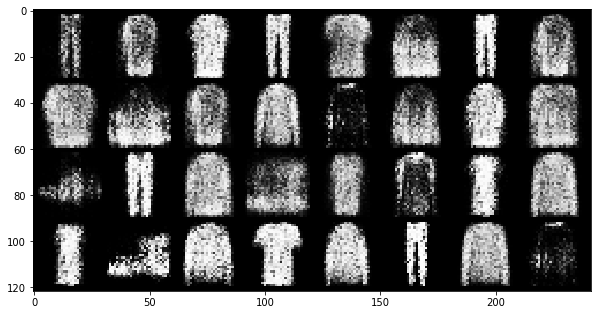

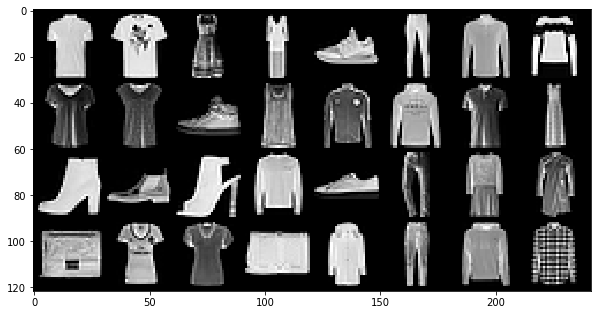

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41000: Generator loss: 0.9123584355115898, discriminator loss: 0.5778210877180094


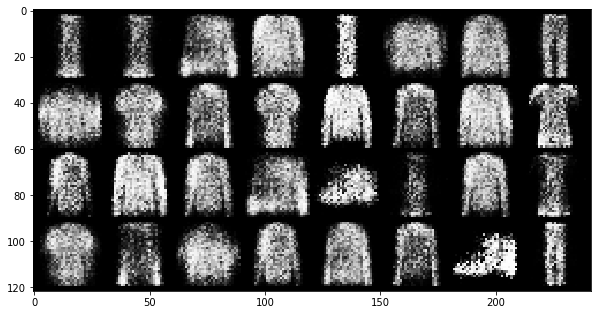

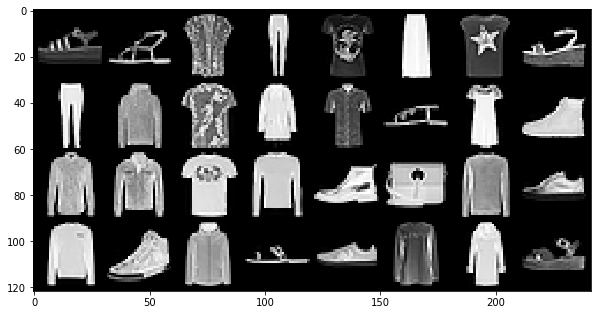

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41500: Generator loss: 0.9790967552661893, discriminator loss: 0.5733910395503042


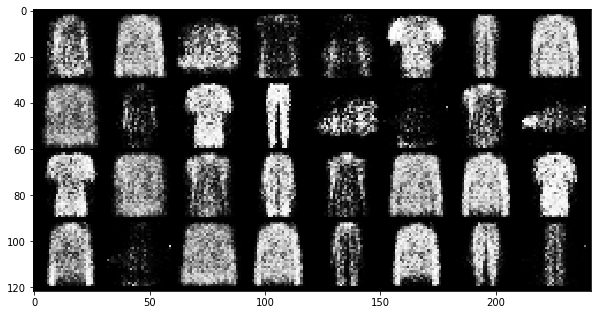

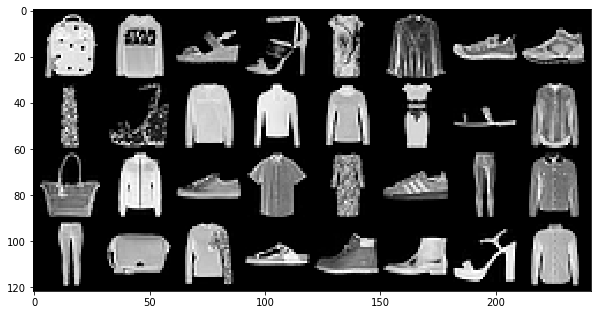

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42000: Generator loss: 0.8968319796323779, discriminator loss: 0.5733691128492353


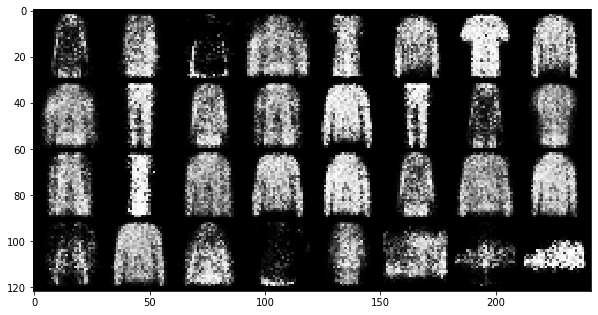

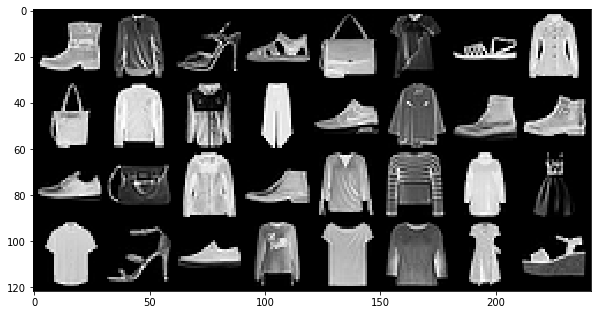

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42500: Generator loss: 0.9272197183370599, discriminator loss: 0.5844141438007359


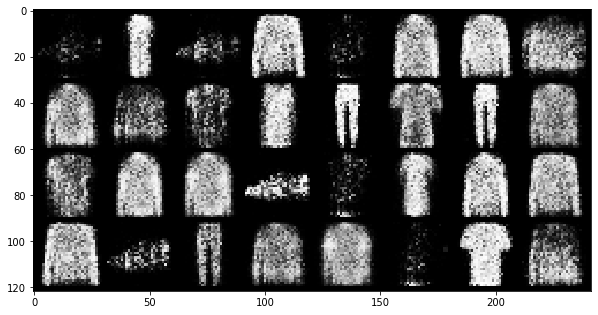

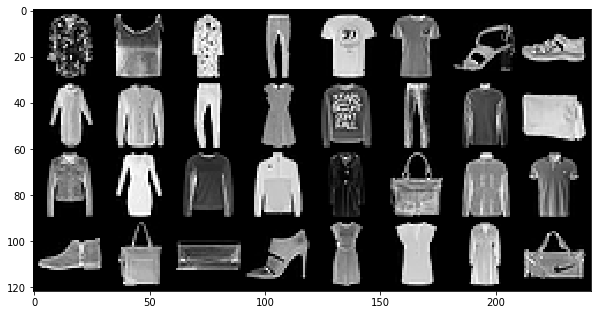

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43000: Generator loss: 0.9231388492584222, discriminator loss: 0.5636103189587591


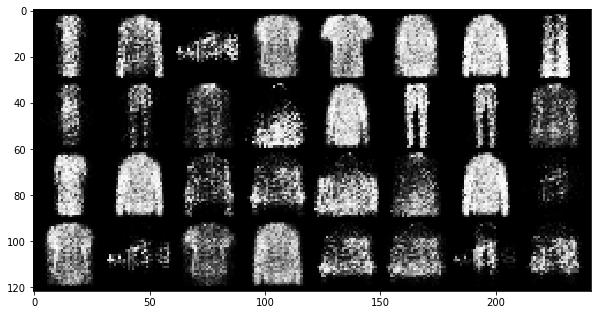

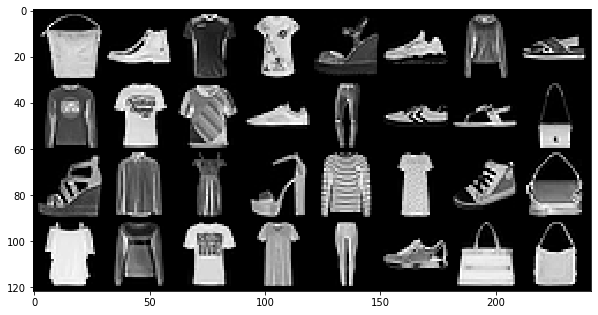

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43500: Generator loss: 0.843674603700638, discriminator loss: 0.6020939669609076


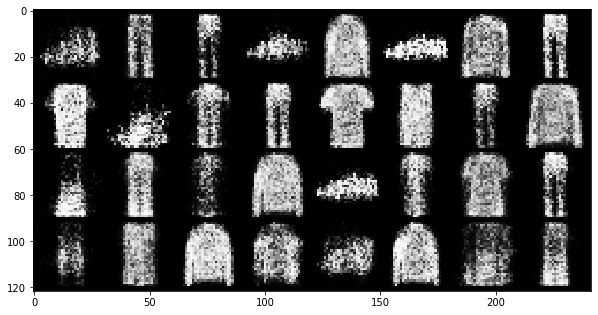

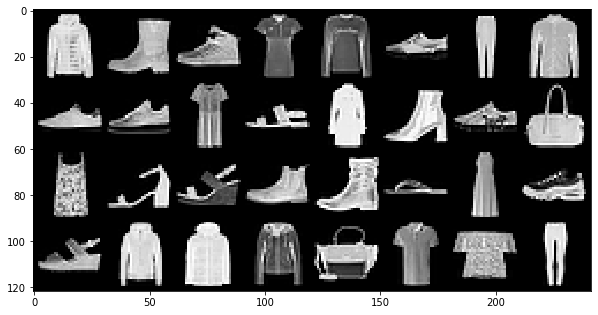

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44000: Generator loss: 0.8965523216724403, discriminator loss: 0.6141764701604842


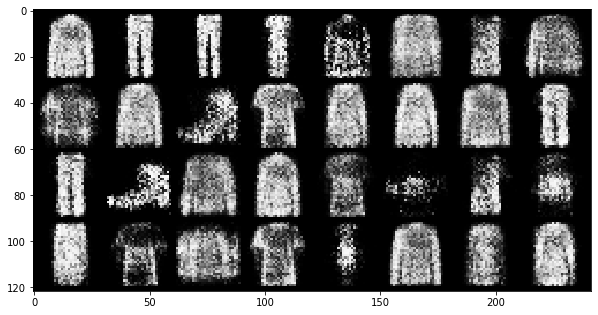

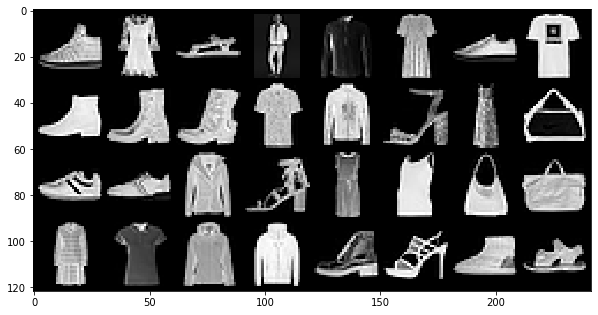

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44500: Generator loss: 0.9619668563604352, discriminator loss: 0.5891846721172335


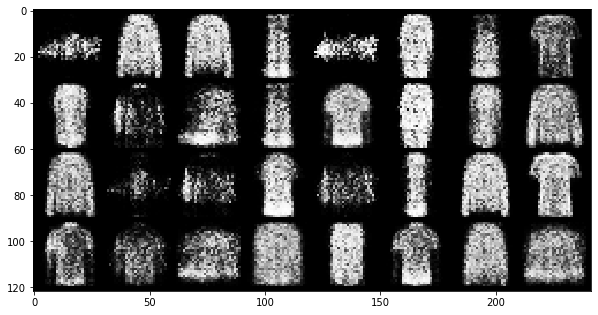

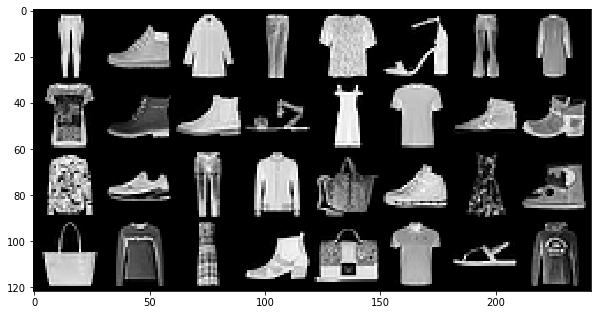

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45000: Generator loss: 0.9240733062028891, discriminator loss: 0.5931458688974388


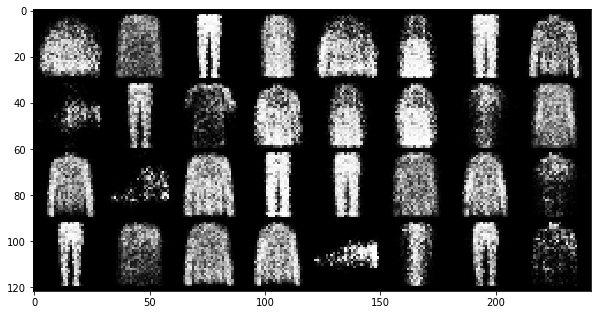

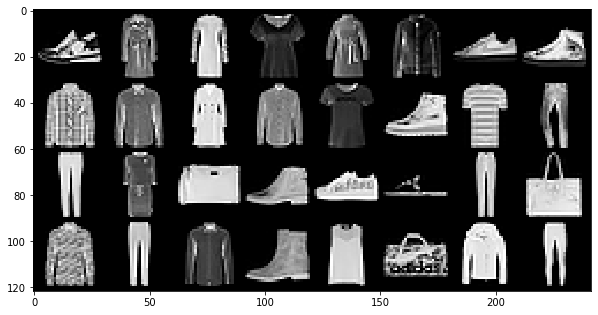

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45500: Generator loss: 0.8491382274627692, discriminator loss: 0.5907883627414698


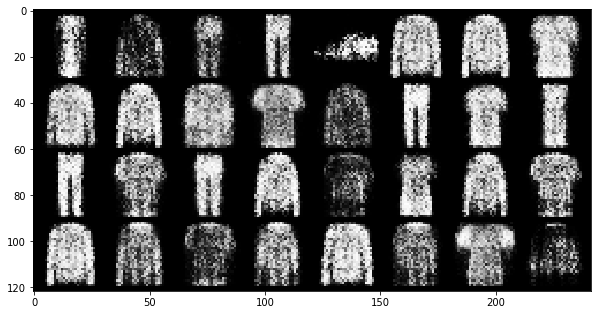

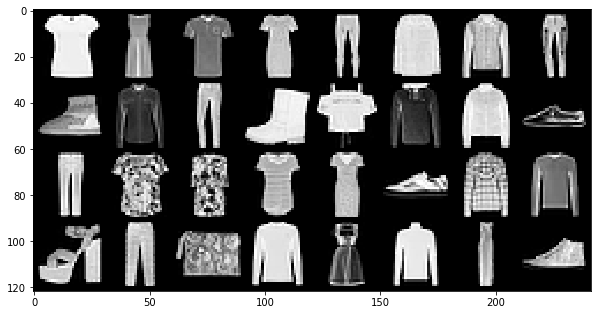

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46000: Generator loss: 1.0262680110931401, discriminator loss: 0.5557756136655805


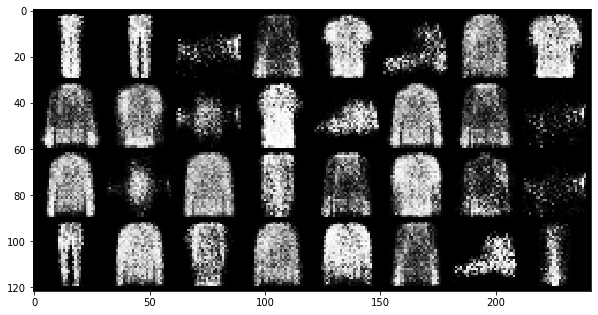

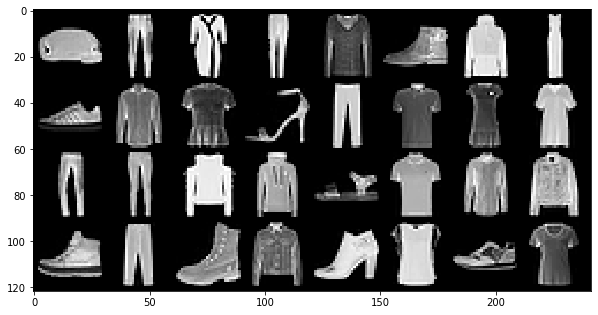

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46500: Generator loss: 0.8950311621427536, discriminator loss: 0.573268814742565


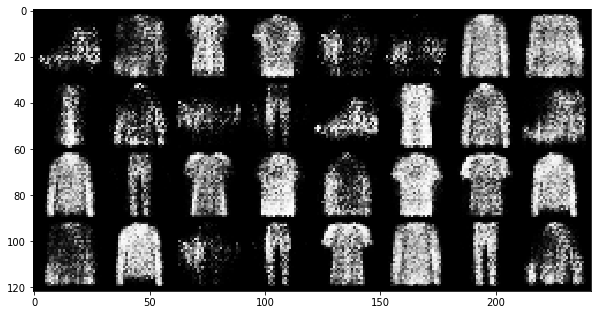

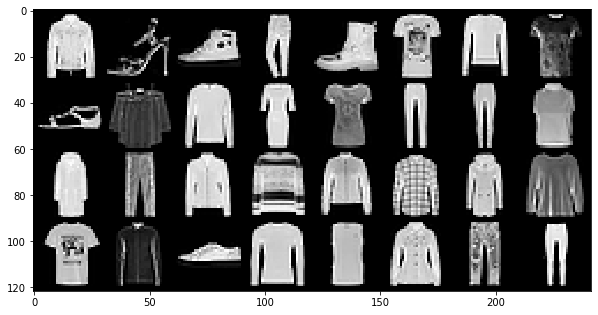

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47000: Generator loss: 0.9359368095397941, discriminator loss: 0.5835188035964961


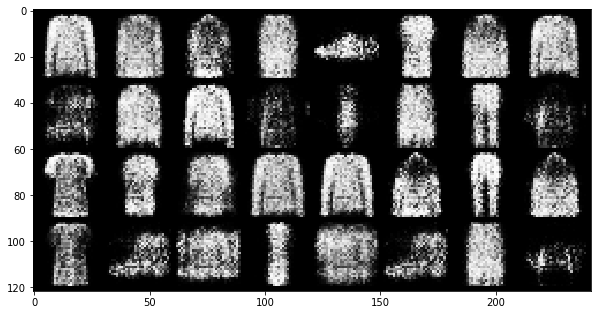

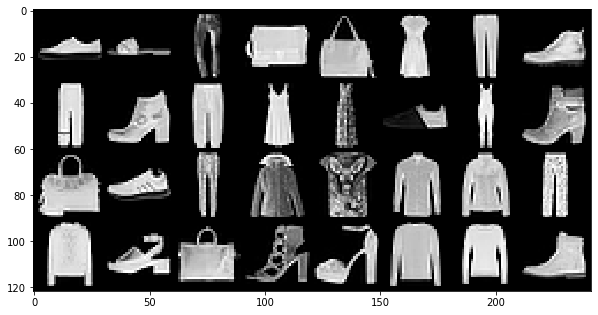

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47500: Generator loss: 0.9601799263954157, discriminator loss: 0.5772469527125357


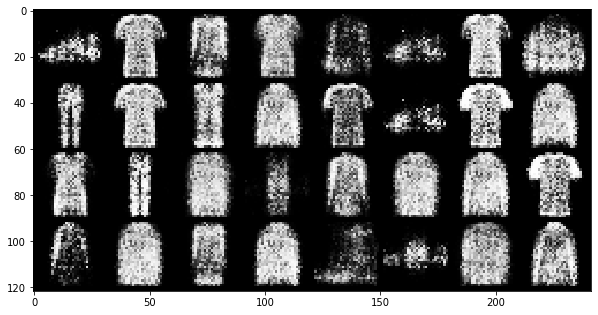

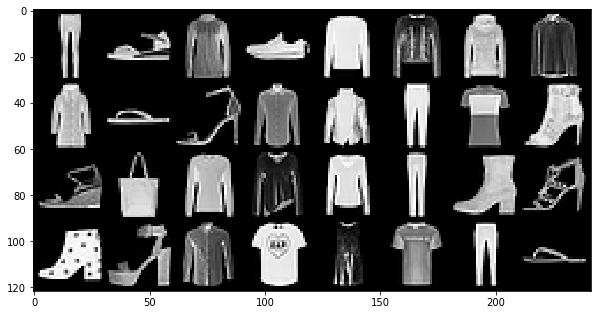

  0%|          | 0/469 [00:00<?, ?it/s]

Step 48000: Generator loss: 0.954473479628564, discriminator loss: 0.5807032579183589


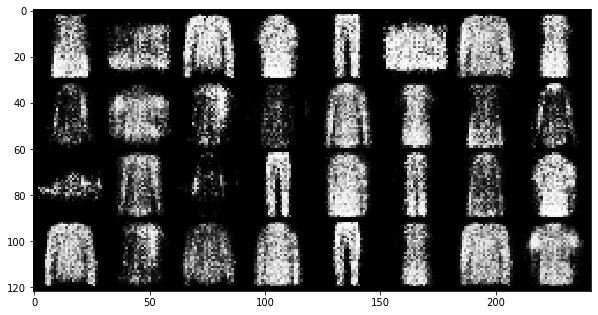

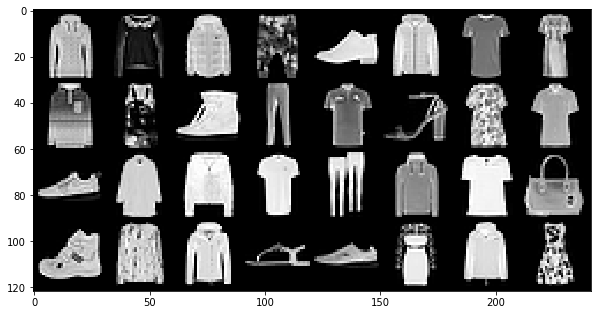

  0%|          | 0/469 [00:00<?, ?it/s]

Step 48500: Generator loss: 0.9223637416362763, discriminator loss: 0.6046804407835008


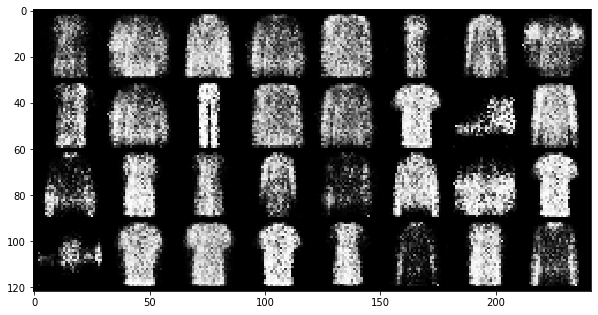

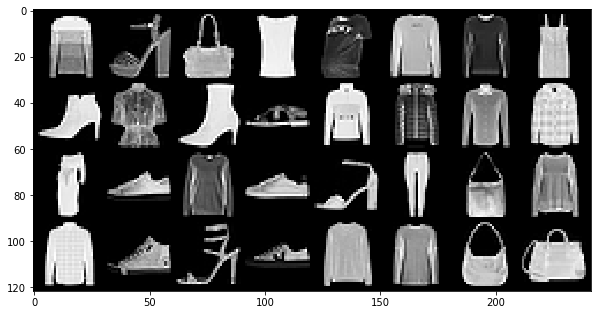

  0%|          | 0/469 [00:00<?, ?it/s]

Step 49000: Generator loss: 0.8777490671873094, discriminator loss: 0.5990808683633799


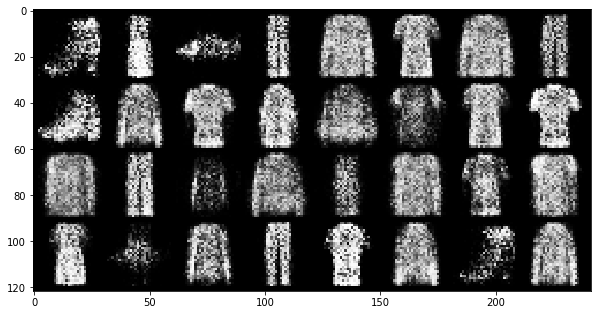

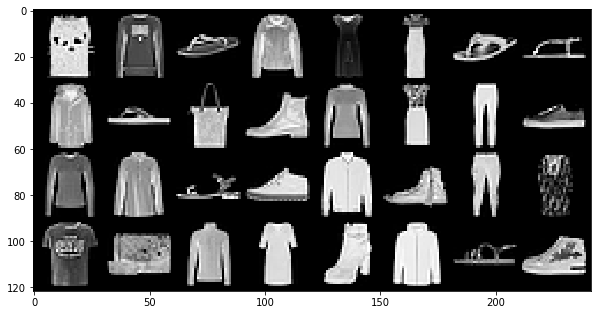

  0%|          | 0/469 [00:00<?, ?it/s]

Step 49500: Generator loss: 0.9934544600248342, discriminator loss: 0.6101563981771471


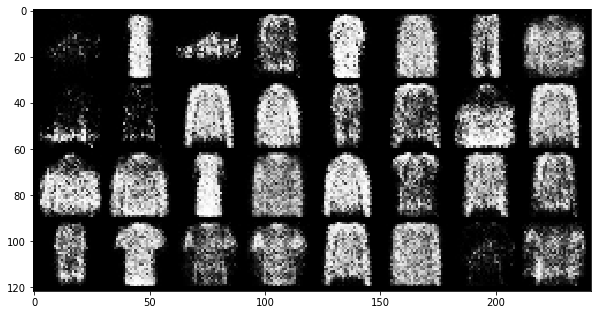

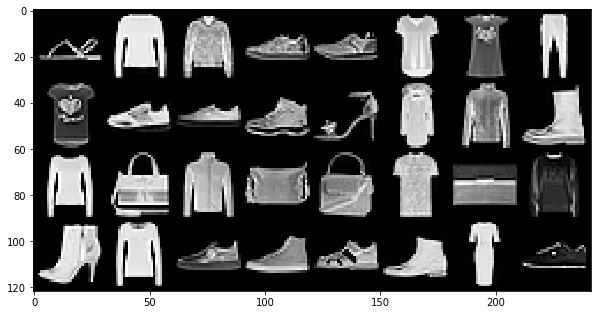

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50000: Generator loss: 0.8890647815465923, discriminator loss: 0.5692054336071015


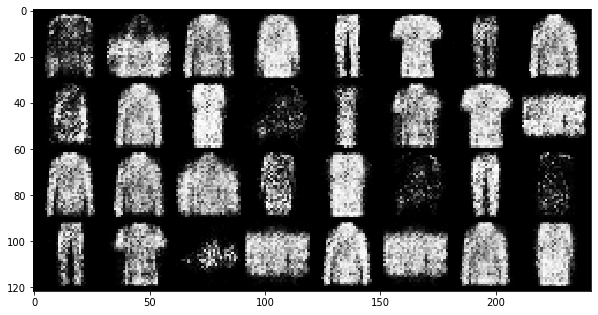

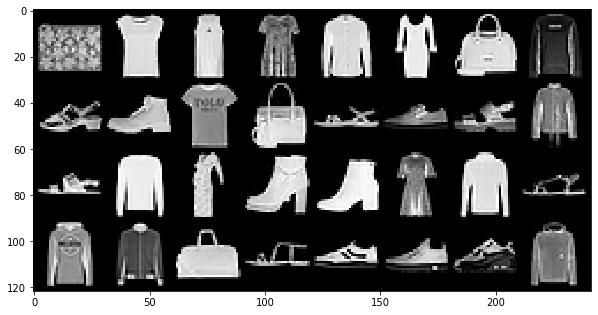

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50500: Generator loss: 0.9166239843368531, discriminator loss: 0.6047352157831191


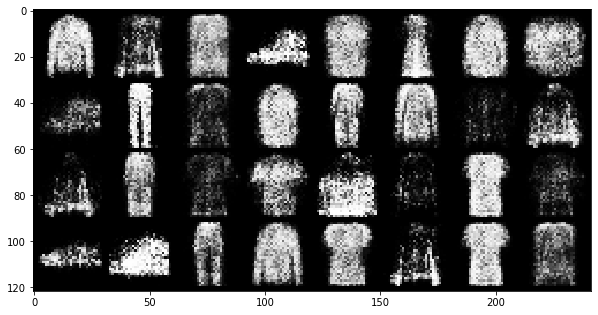

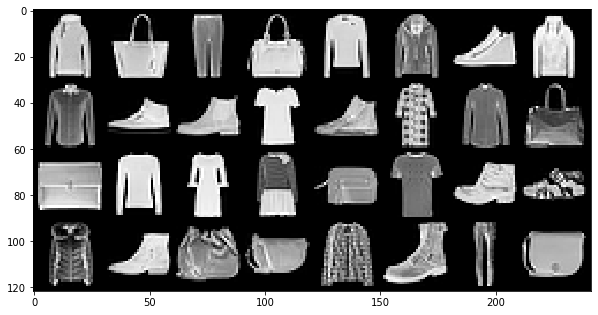

  0%|          | 0/469 [00:00<?, ?it/s]

Step 51000: Generator loss: 0.8954226123094569, discriminator loss: 0.57930415135622


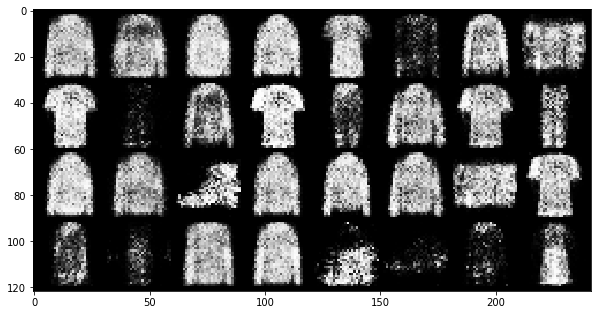

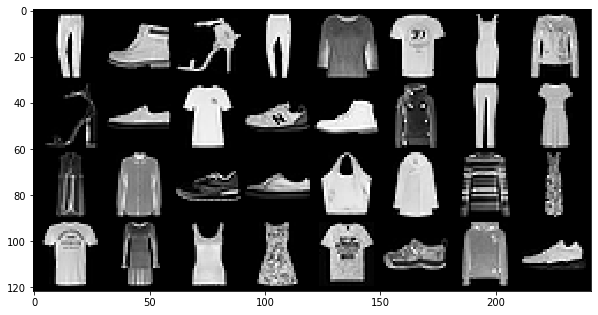

  0%|          | 0/469 [00:00<?, ?it/s]

Step 51500: Generator loss: 0.8911532906293883, discriminator loss: 0.6077357280254368


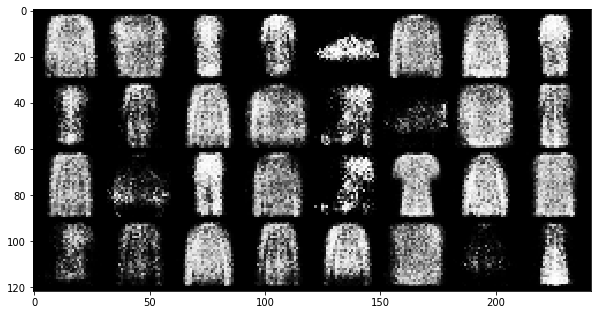

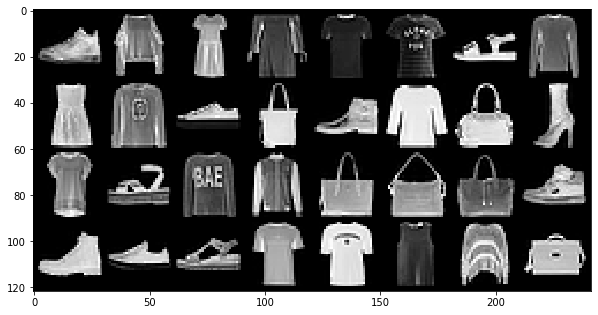

  0%|          | 0/469 [00:00<?, ?it/s]

Step 52000: Generator loss: 0.8799391046762459, discriminator loss: 0.6147948132753374


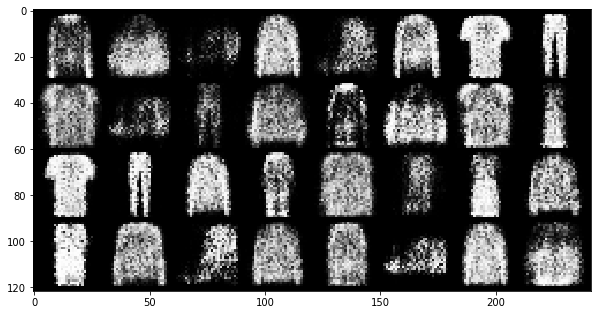

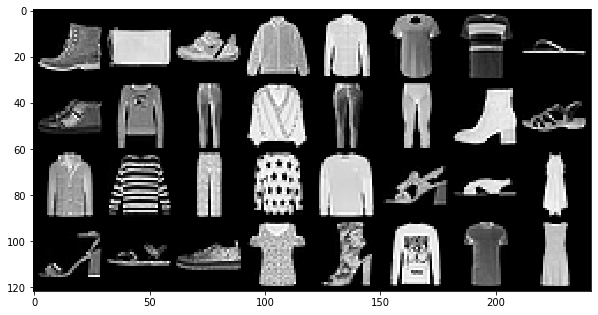

  0%|          | 0/469 [00:00<?, ?it/s]

Step 52500: Generator loss: 0.8422220697402951, discriminator loss: 0.6183038690090178


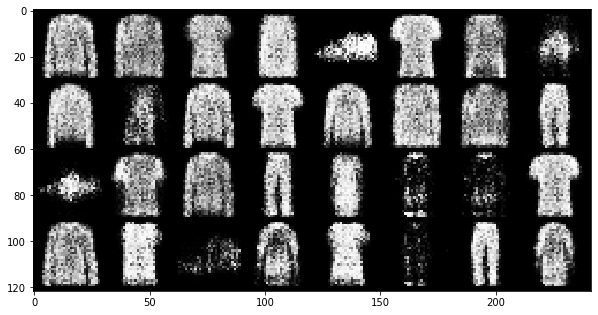

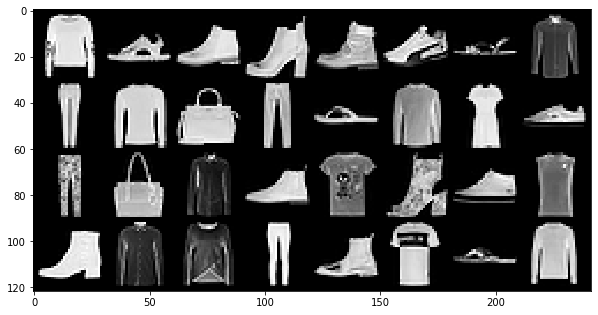

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53000: Generator loss: 0.8646532835960382, discriminator loss: 0.6199992824792866


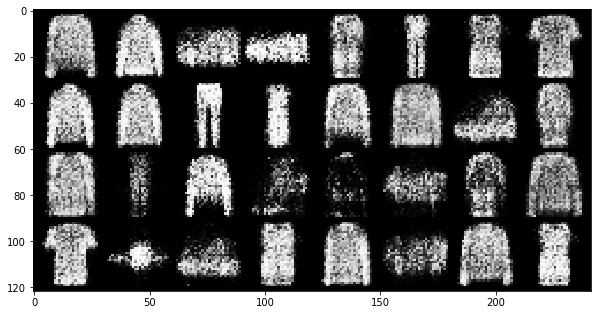

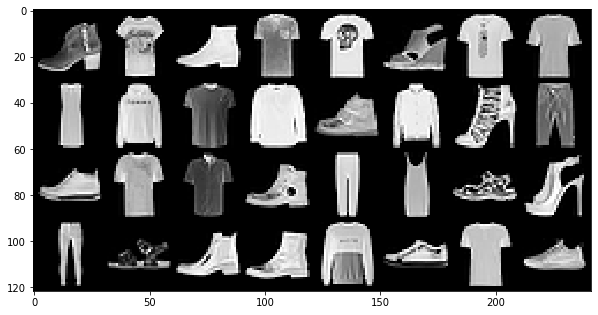

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53500: Generator loss: 0.8821268686056138, discriminator loss: 0.6154724355936051


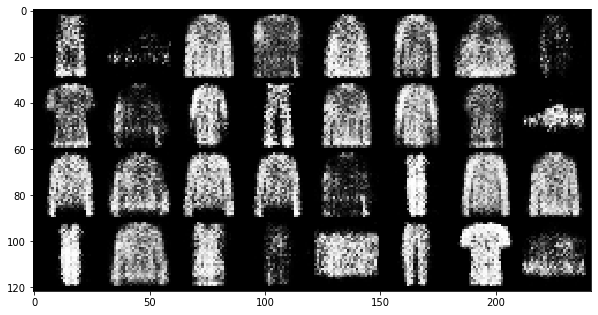

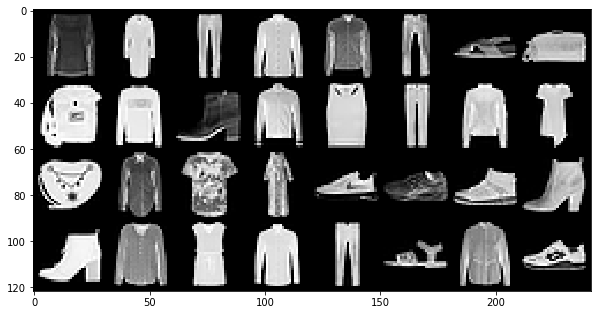

  0%|          | 0/469 [00:00<?, ?it/s]

Step 54000: Generator loss: 0.850757766366005, discriminator loss: 0.6180737071037299


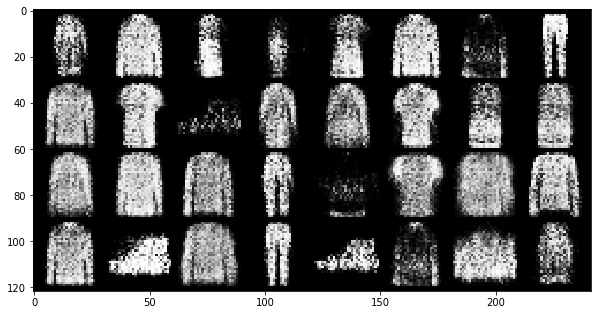

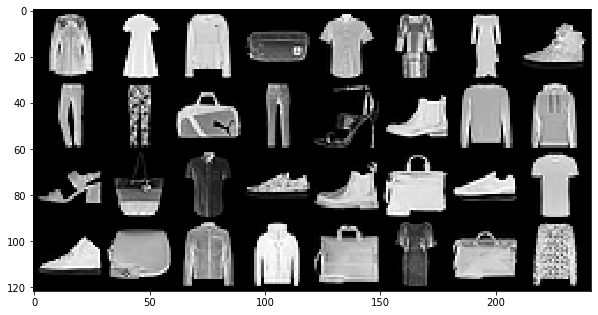

  0%|          | 0/469 [00:00<?, ?it/s]

Step 54500: Generator loss: 0.8782595503330224, discriminator loss: 0.6131192024946212


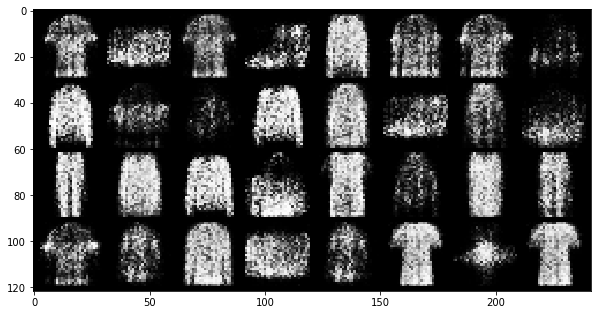

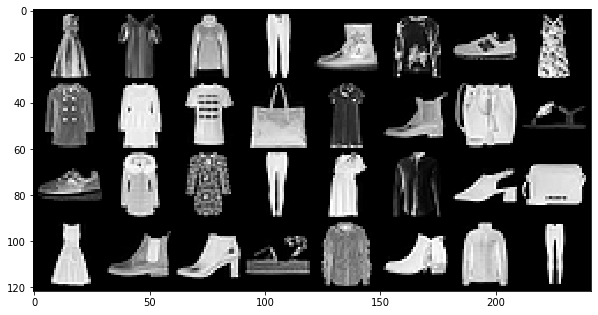

  0%|          | 0/469 [00:00<?, ?it/s]

Step 55000: Generator loss: 0.9111424773931507, discriminator loss: 0.6112574372291565


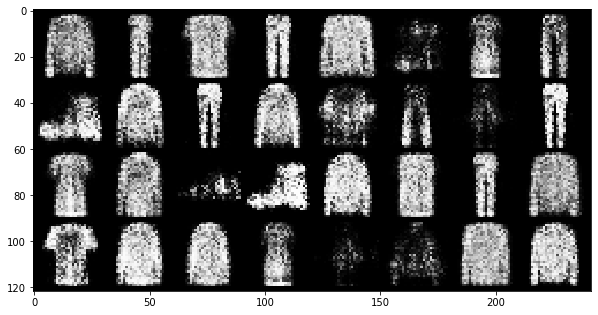

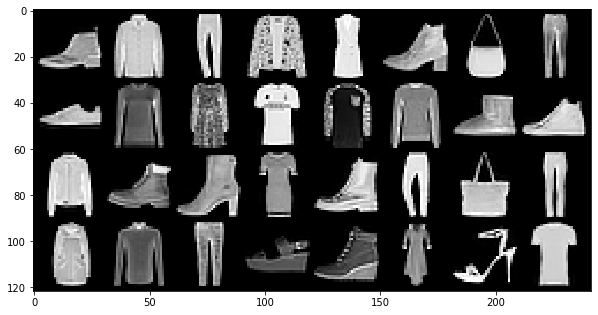

  0%|          | 0/469 [00:00<?, ?it/s]

Step 55500: Generator loss: 0.8258923983573921, discriminator loss: 0.6264640847444538


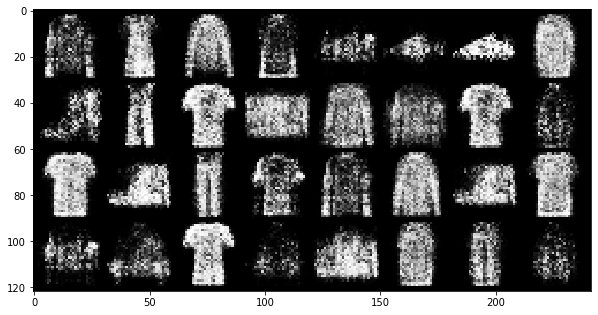

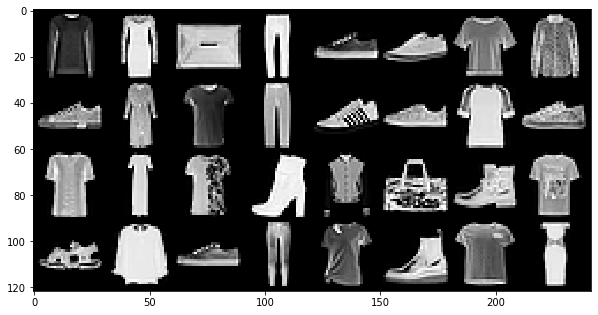

  0%|          | 0/469 [00:00<?, ?it/s]

Step 56000: Generator loss: 0.9276028096675873, discriminator loss: 0.6160600429773327


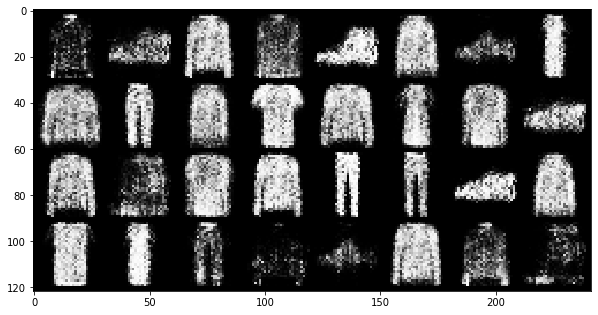

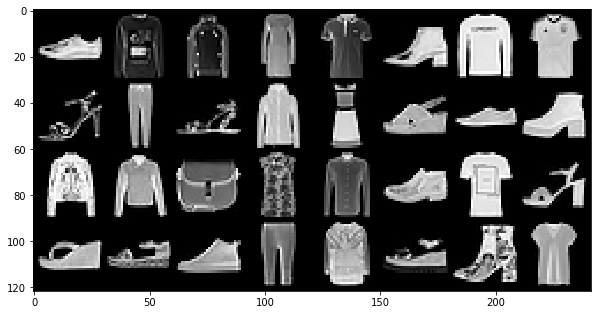

  0%|          | 0/469 [00:00<?, ?it/s]

Step 56500: Generator loss: 0.8399204921722406, discriminator loss: 0.6130769413709637


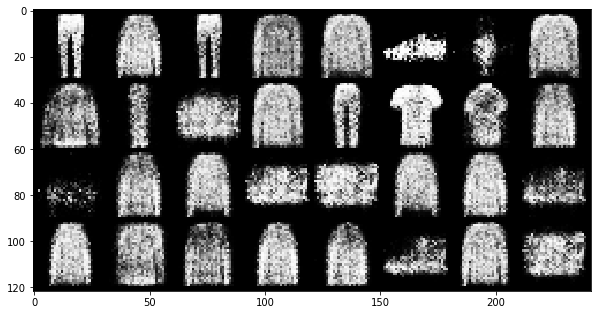

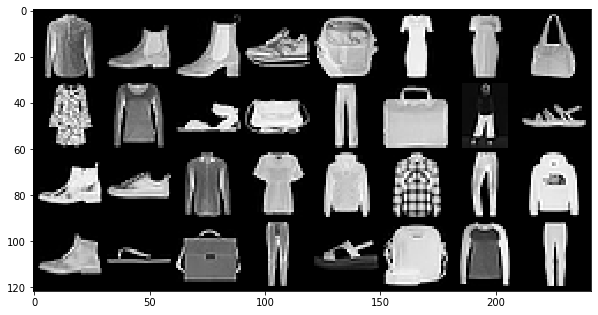

  0%|          | 0/469 [00:00<?, ?it/s]

Step 57000: Generator loss: 0.8276956559419629, discriminator loss: 0.6327388792037965


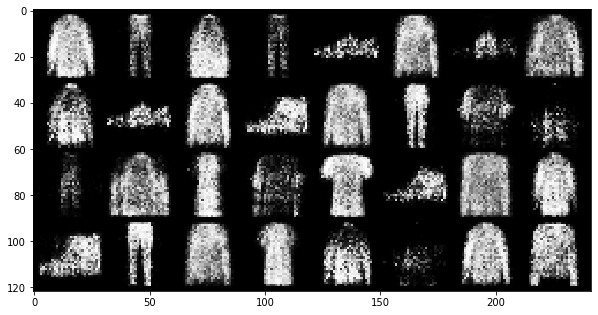

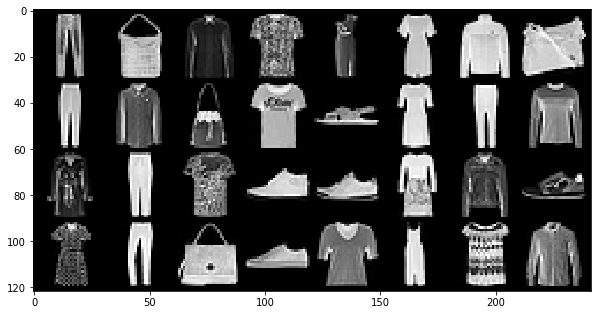

  0%|          | 0/469 [00:00<?, ?it/s]

Step 57500: Generator loss: 0.8793213785886764, discriminator loss: 0.6123854240179063


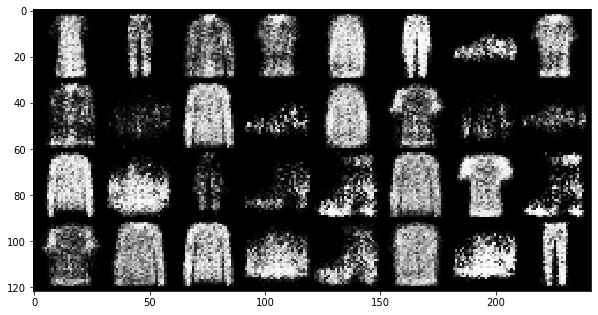

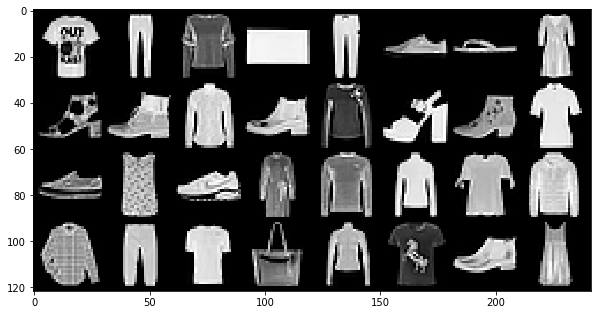

  0%|          | 0/469 [00:00<?, ?it/s]

Step 58000: Generator loss: 0.843407690405846, discriminator loss: 0.6229325098991397


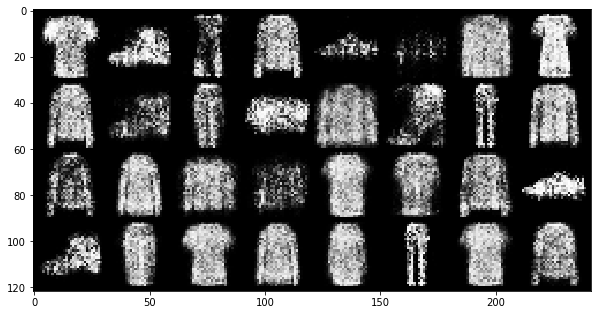

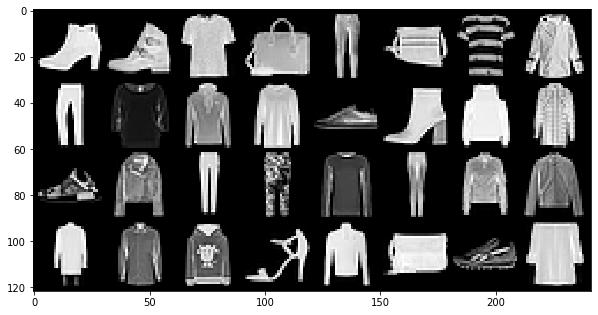

  0%|          | 0/469 [00:00<?, ?it/s]

Step 58500: Generator loss: 0.8519894762039188, discriminator loss: 0.6254267303943638


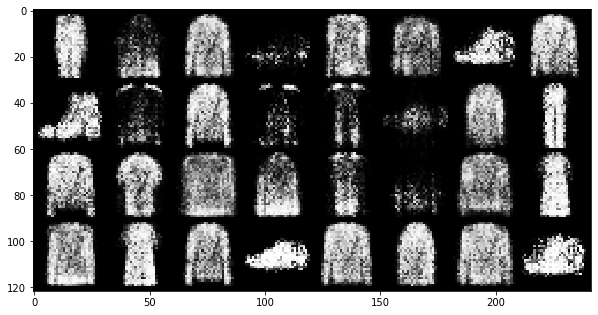

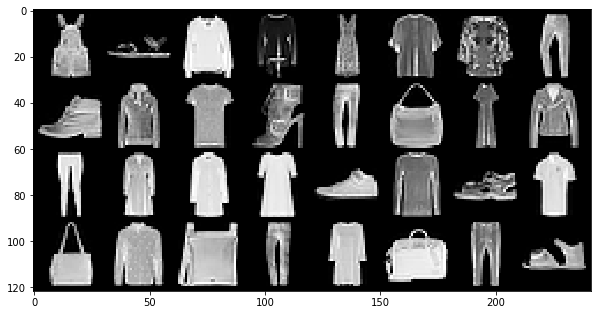

  0%|          | 0/469 [00:00<?, ?it/s]

Step 59000: Generator loss: 0.8770037628412245, discriminator loss: 0.6125179653167717


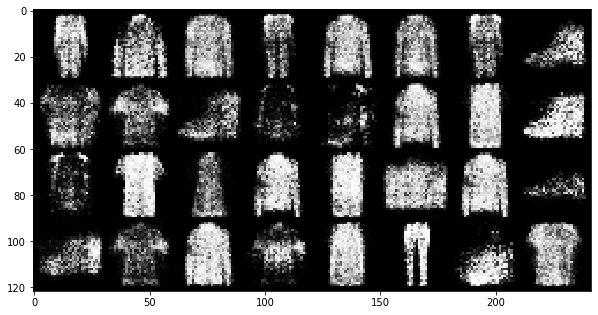

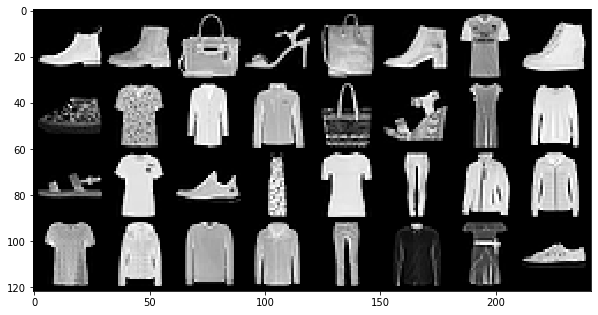

  0%|          | 0/469 [00:00<?, ?it/s]

Step 59500: Generator loss: 0.8544845951795572, discriminator loss: 0.6124567606449134


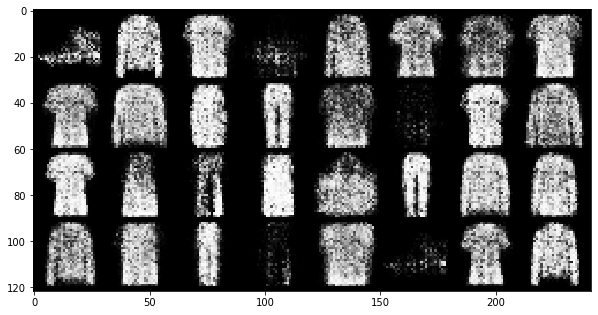

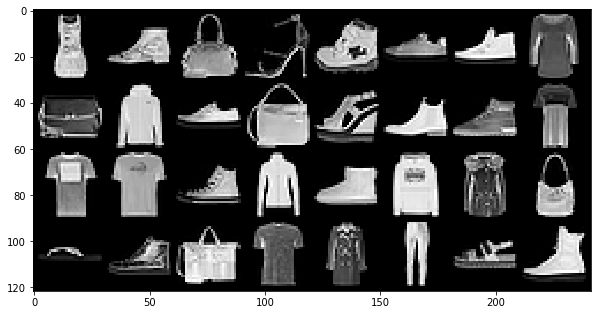

  0%|          | 0/469 [00:00<?, ?it/s]

Step 60000: Generator loss: 0.8807321784496307, discriminator loss: 0.6157196677923199


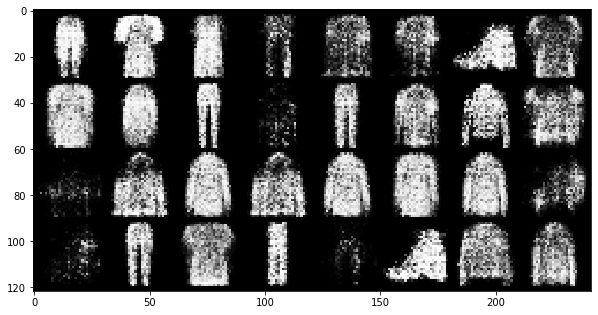

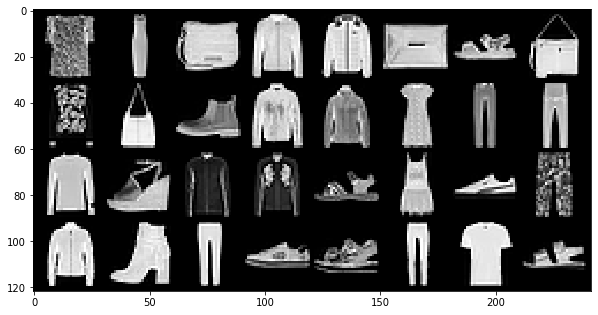

  0%|          | 0/469 [00:00<?, ?it/s]

Step 60500: Generator loss: 0.8324253476858136, discriminator loss: 0.6259626795053478


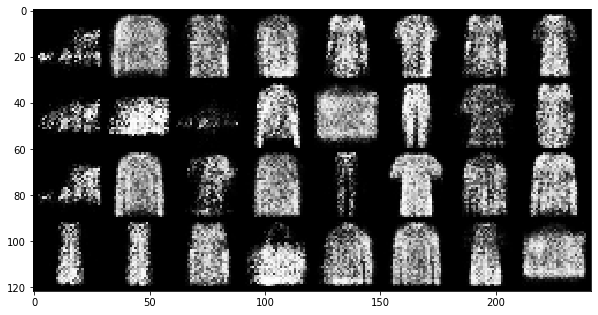

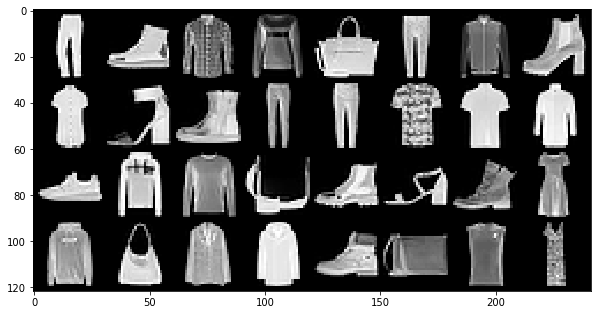

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 61000: Generator loss: 0.8860829170942299, discriminator loss: 0.6276491749286651


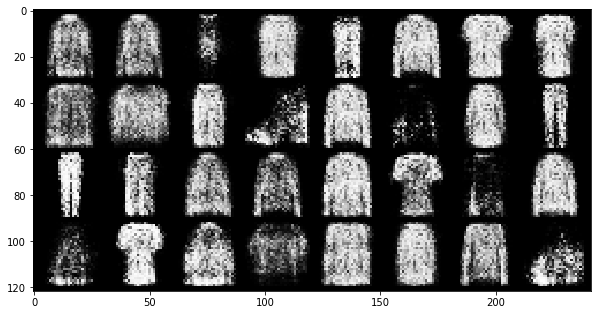

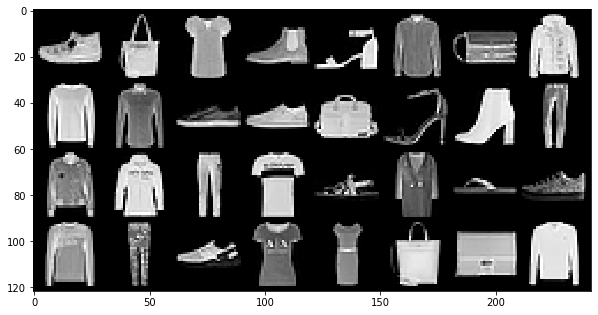

  0%|          | 0/469 [00:00<?, ?it/s]

Step 61500: Generator loss: 0.8269968670606618, discriminator loss: 0.6188051503896717


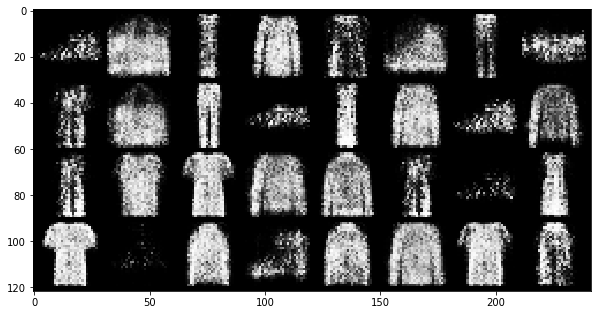

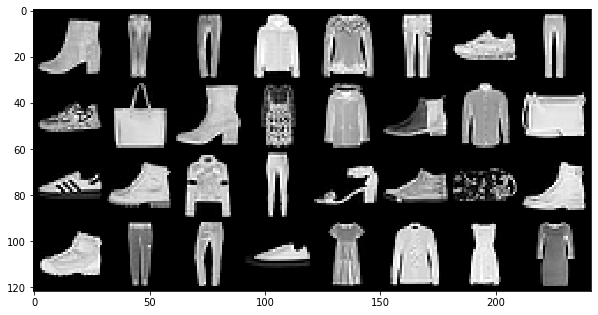

  0%|          | 0/469 [00:00<?, ?it/s]

Step 62000: Generator loss: 0.8604169706106183, discriminator loss: 0.6412824107408513


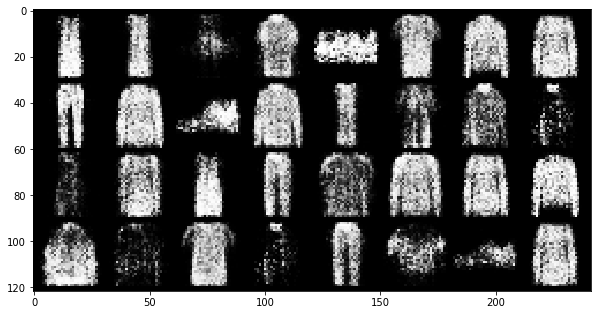

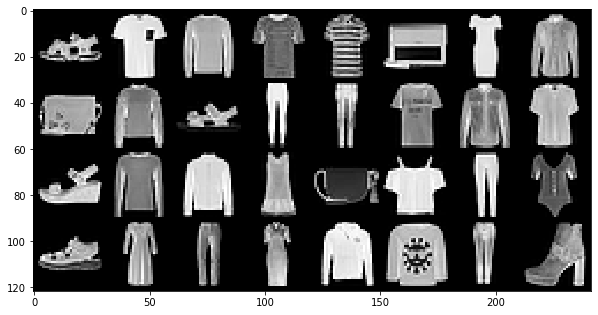

  0%|          | 0/469 [00:00<?, ?it/s]

Step 62500: Generator loss: 0.823608924865723, discriminator loss: 0.6299965772628779


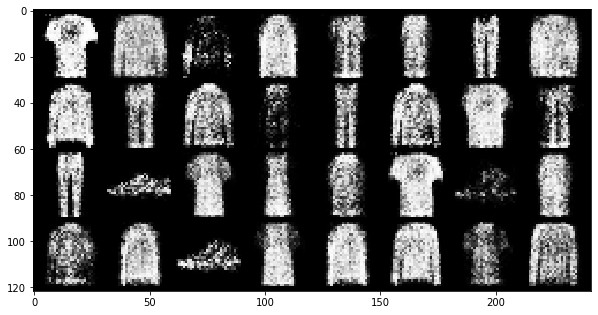

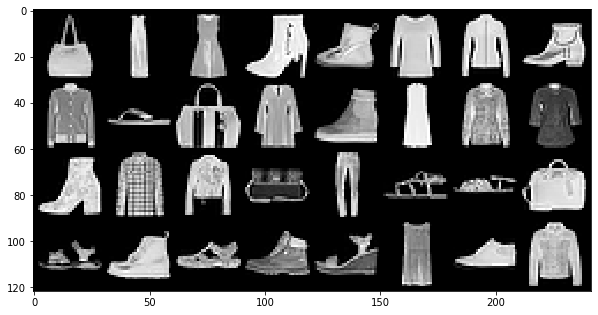

  0%|          | 0/469 [00:00<?, ?it/s]

Step 63000: Generator loss: 0.8132899883985535, discriminator loss: 0.641893008589744


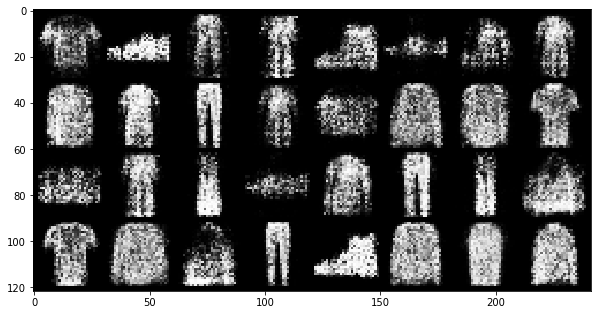

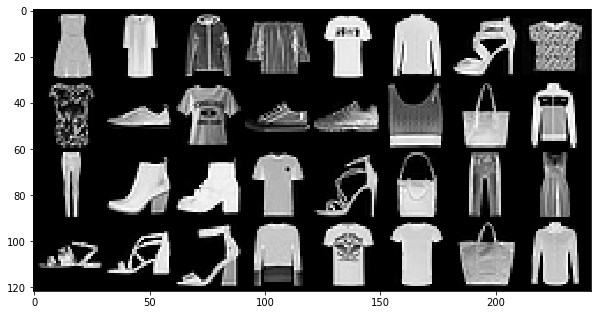

  0%|          | 0/469 [00:00<?, ?it/s]

Step 63500: Generator loss: 0.8268354207277295, discriminator loss: 0.6423230912685395


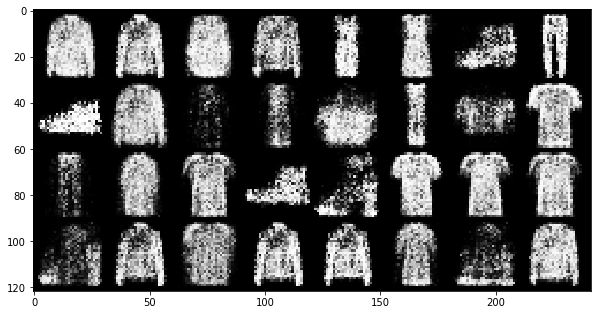

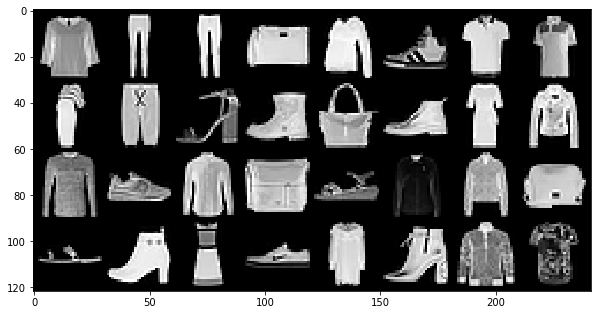

  0%|          | 0/469 [00:00<?, ?it/s]

Step 64000: Generator loss: 0.8234240188598636, discriminator loss: 0.6343807637691505


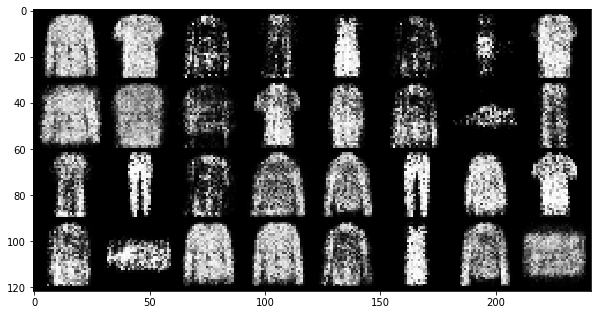

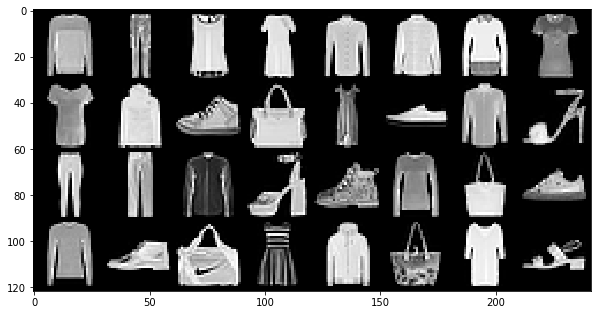

  0%|          | 0/469 [00:00<?, ?it/s]

Step 64500: Generator loss: 0.8296614413261412, discriminator loss: 0.6405981011390682


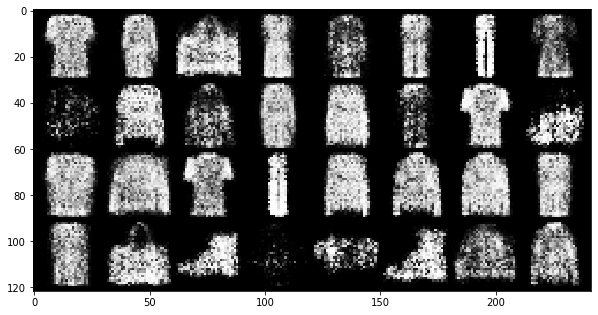

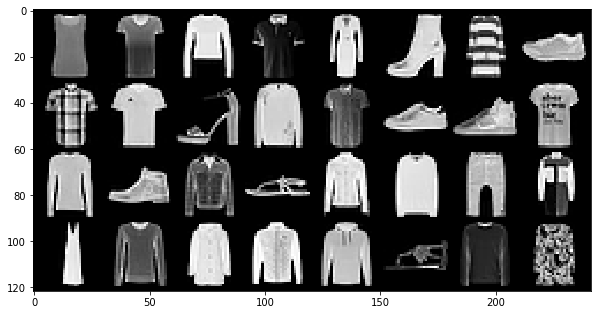

  0%|          | 0/469 [00:00<?, ?it/s]

Step 65000: Generator loss: 0.8367476582527164, discriminator loss: 0.640450566649438


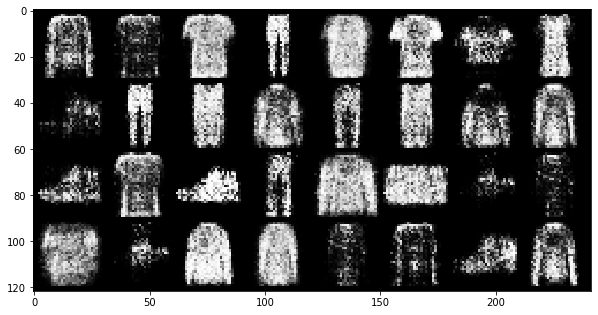

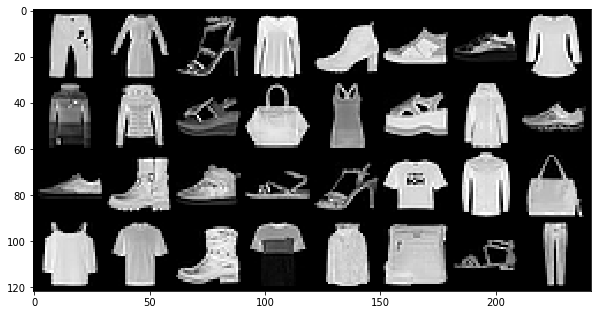

  0%|          | 0/469 [00:00<?, ?it/s]

Step 65500: Generator loss: 0.8170773820877073, discriminator loss: 0.6310799413919445


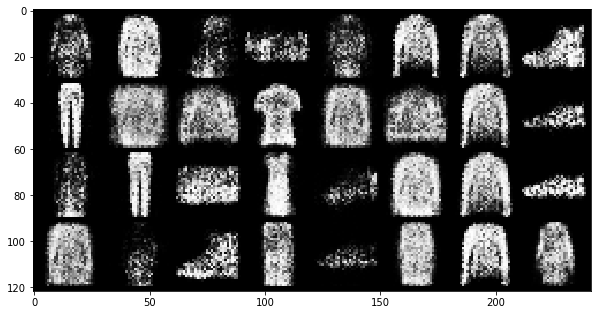

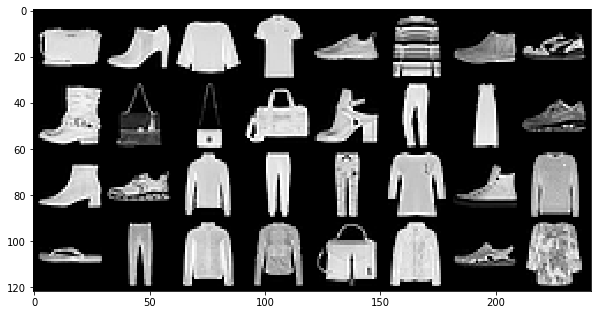

  0%|          | 0/469 [00:00<?, ?it/s]

Step 66000: Generator loss: 0.8466438226699836, discriminator loss: 0.6374114897251127


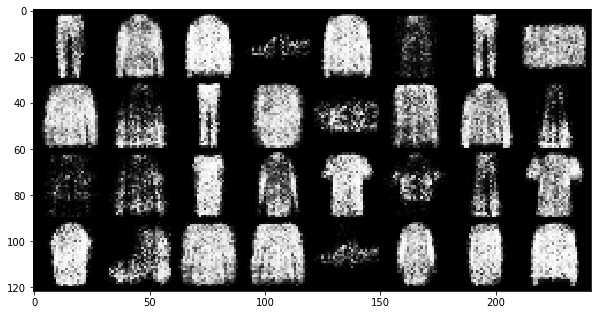

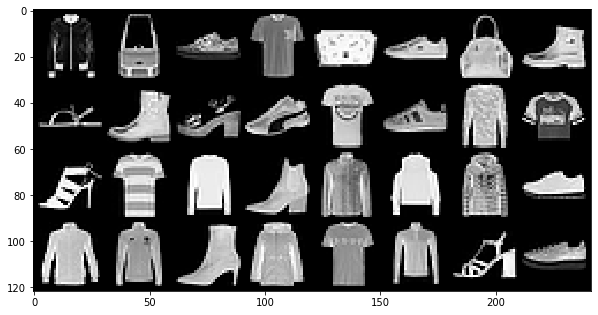

  0%|          | 0/469 [00:00<?, ?it/s]

Step 66500: Generator loss: 0.8019893420934684, discriminator loss: 0.6409329940080647


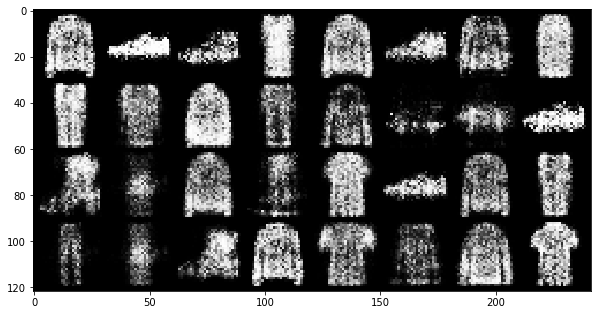

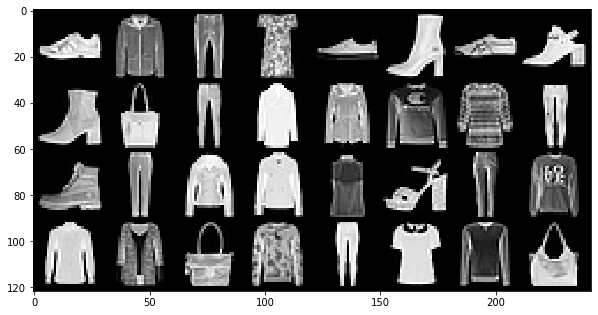

  0%|          | 0/469 [00:00<?, ?it/s]

Step 67000: Generator loss: 0.8628797147274014, discriminator loss: 0.6304598386287686


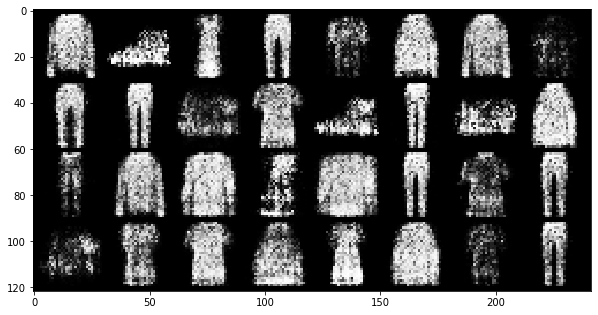

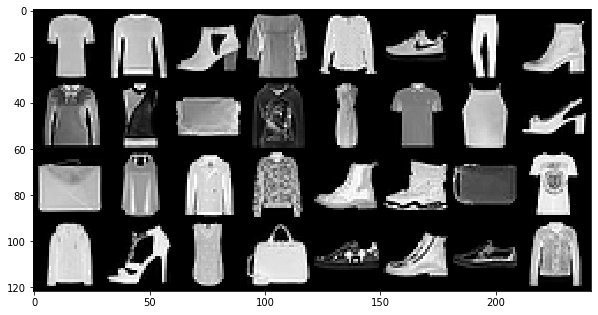

  0%|          | 0/469 [00:00<?, ?it/s]

Step 67500: Generator loss: 0.8079044281244274, discriminator loss: 0.64533929502964


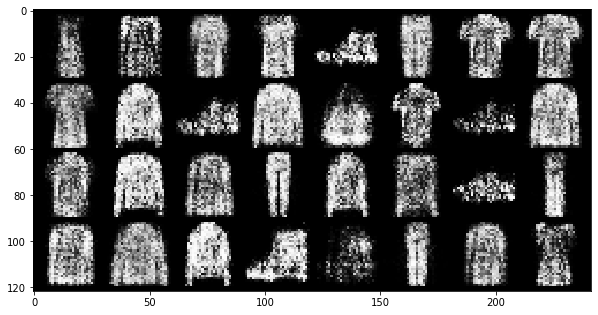

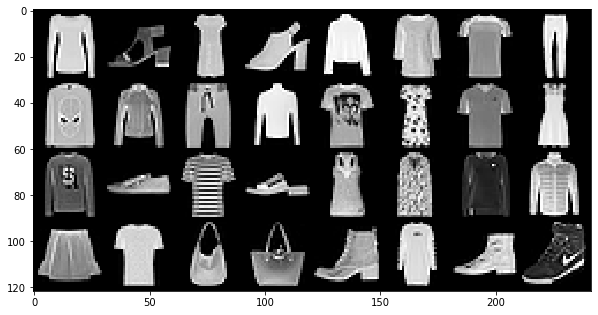

  0%|          | 0/469 [00:00<?, ?it/s]

Step 68000: Generator loss: 0.8752180471420282, discriminator loss: 0.643976703763008


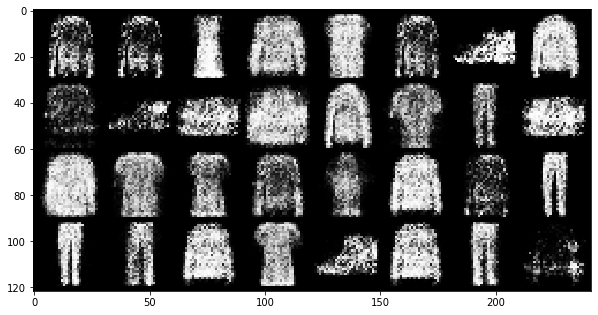

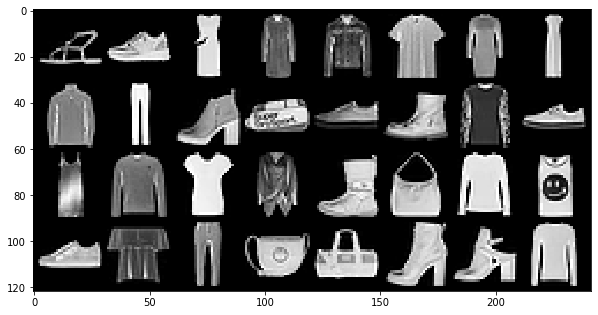

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 68500: Generator loss: 0.8093724635839459, discriminator loss: 0.6346005808115004


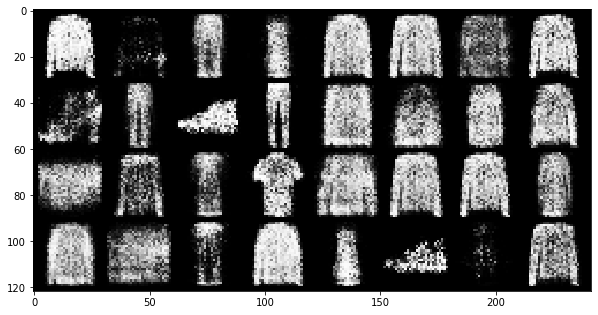

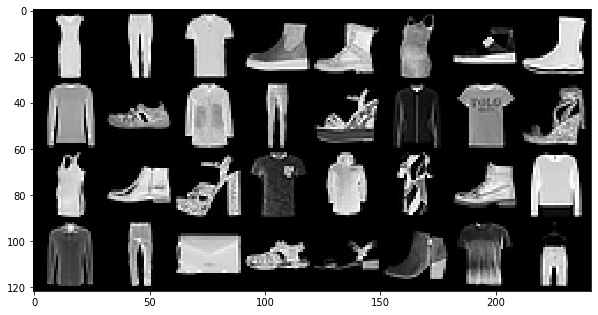

  0%|          | 0/469 [00:00<?, ?it/s]

Step 69000: Generator loss: 0.8026963564157483, discriminator loss: 0.656909101605415


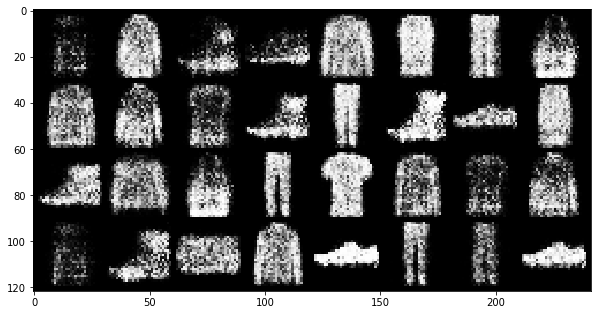

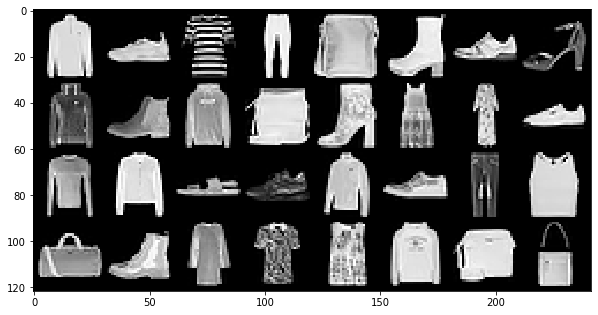

  0%|          | 0/469 [00:00<?, ?it/s]

Step 69500: Generator loss: 0.8095350652933124, discriminator loss: 0.6463441572189339


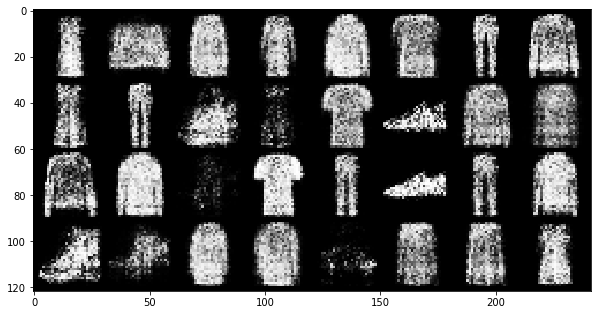

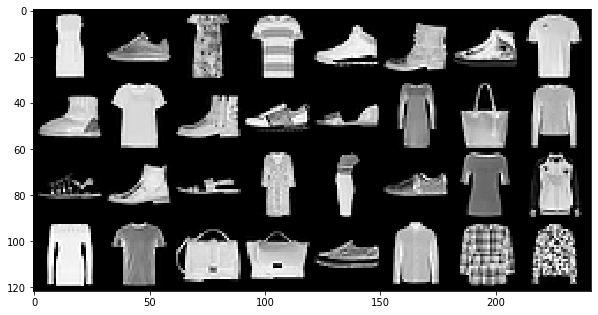

  0%|          | 0/469 [00:00<?, ?it/s]

Step 70000: Generator loss: 0.7862511615753168, discriminator loss: 0.6553188397884376


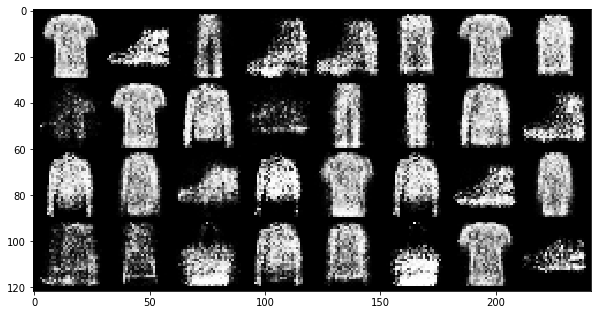

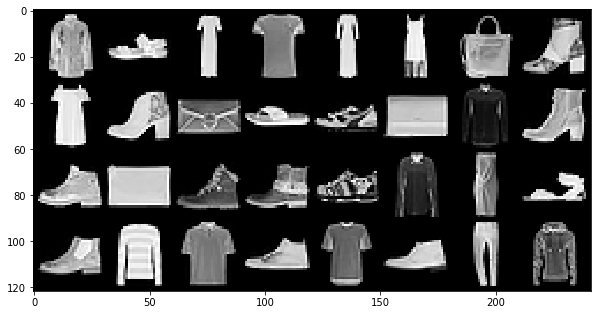

  0%|          | 0/469 [00:00<?, ?it/s]

Step 70500: Generator loss: 0.8201639962196356, discriminator loss: 0.6497118124961849


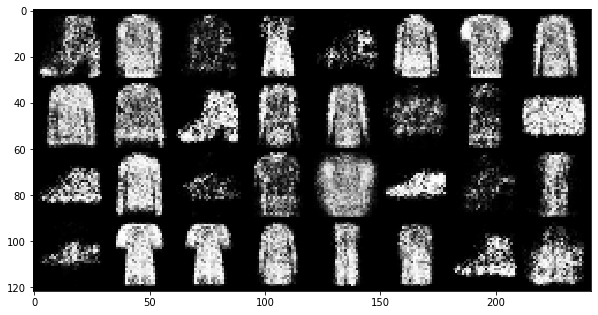

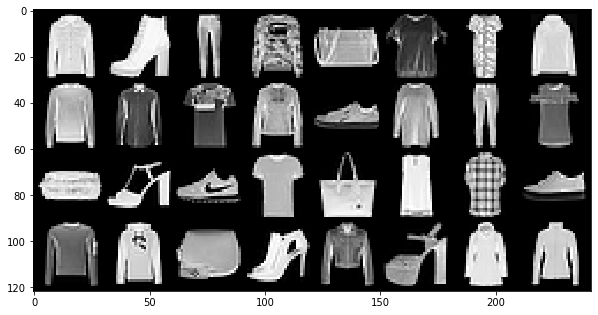

  0%|          | 0/469 [00:00<?, ?it/s]

Step 71000: Generator loss: 0.7902078833580019, discriminator loss: 0.6533585780858995


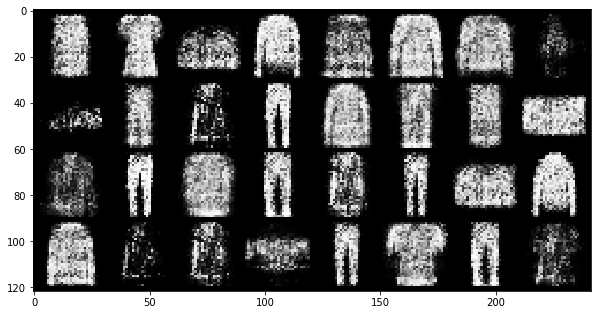

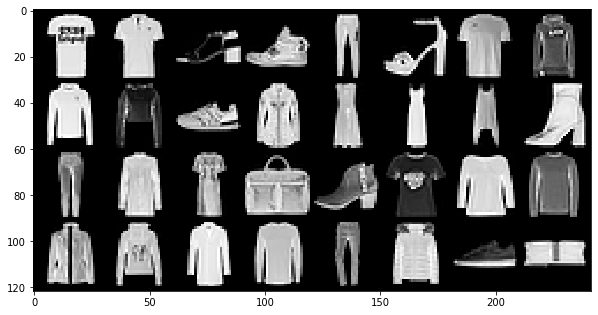

  0%|          | 0/469 [00:00<?, ?it/s]

Step 71500: Generator loss: 0.8110357531309135, discriminator loss: 0.648441863656044


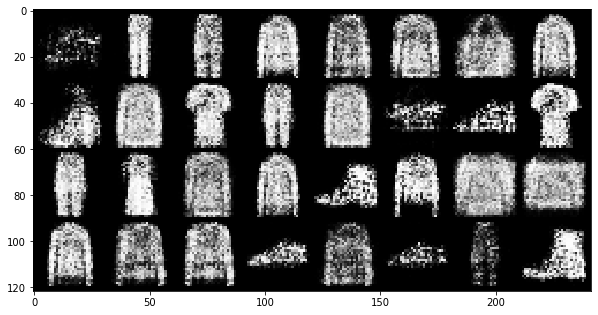

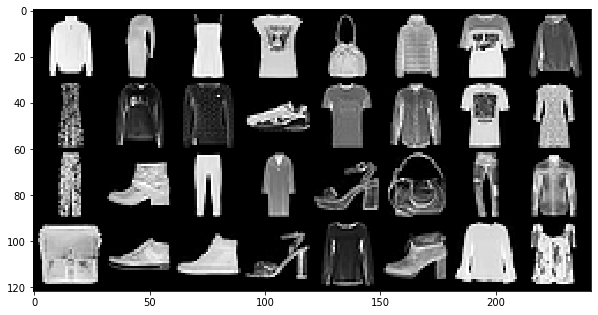

  0%|          | 0/469 [00:00<?, ?it/s]

Step 72000: Generator loss: 0.7918392660617823, discriminator loss: 0.6466700145006171


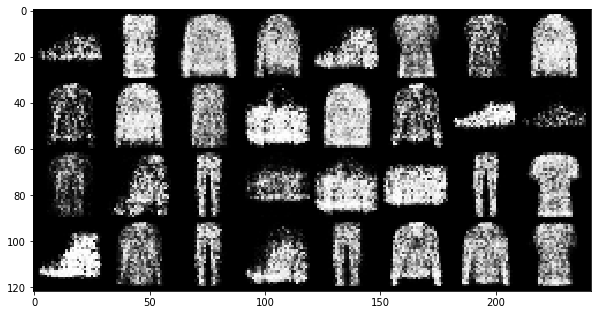

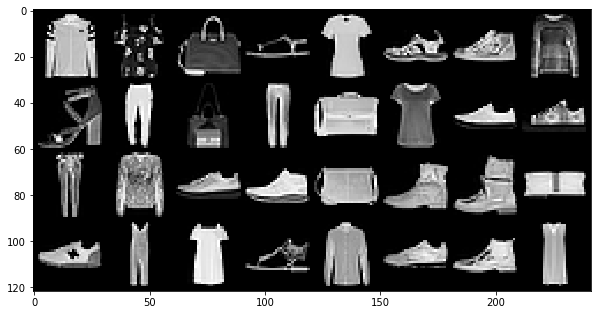

  0%|          | 0/469 [00:00<?, ?it/s]

Step 72500: Generator loss: 0.828128952264786, discriminator loss: 0.6450207864046092


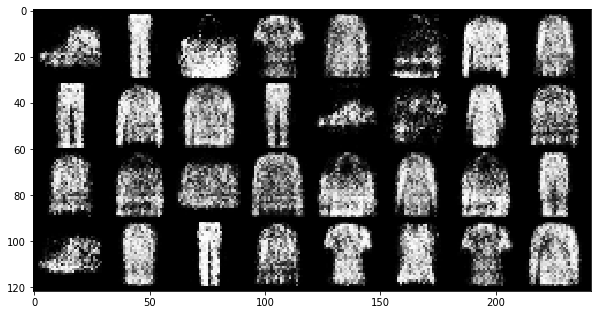

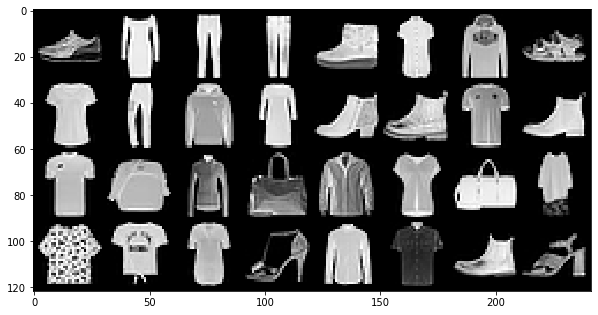

  0%|          | 0/469 [00:00<?, ?it/s]

Step 73000: Generator loss: 0.8030547999143591, discriminator loss: 0.6393076972961432


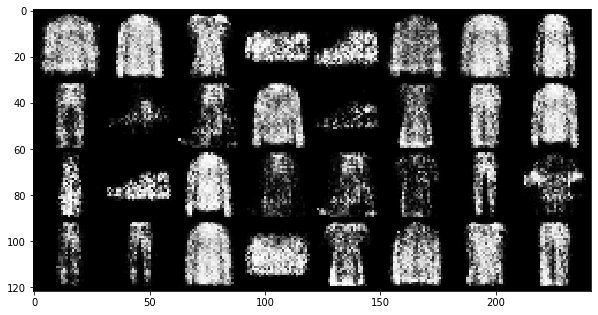

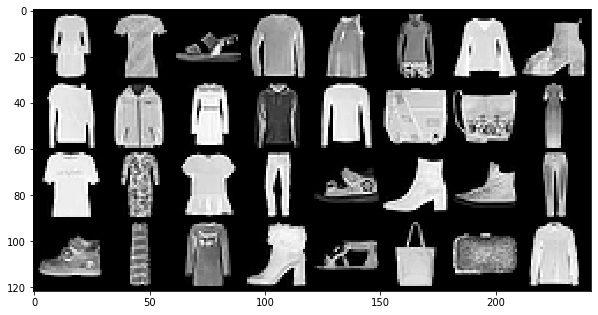

  0%|          | 0/469 [00:00<?, ?it/s]

Step 73500: Generator loss: 0.8141378116607662, discriminator loss: 0.647710039138794


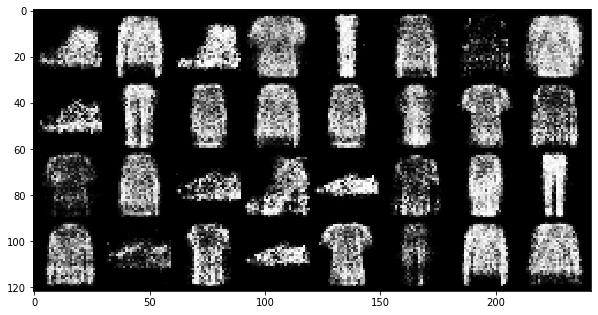

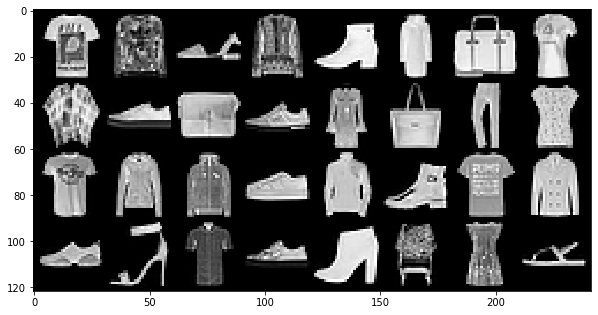

  0%|          | 0/469 [00:00<?, ?it/s]

Step 74000: Generator loss: 0.8111973787546161, discriminator loss: 0.6416085290908811


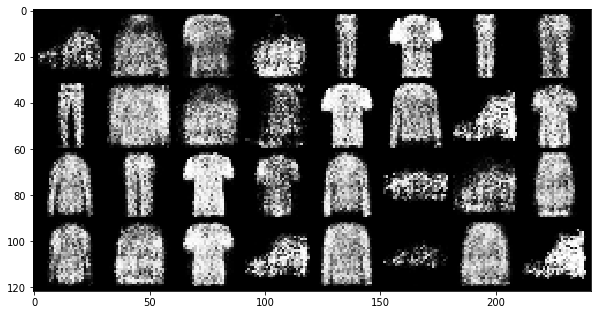

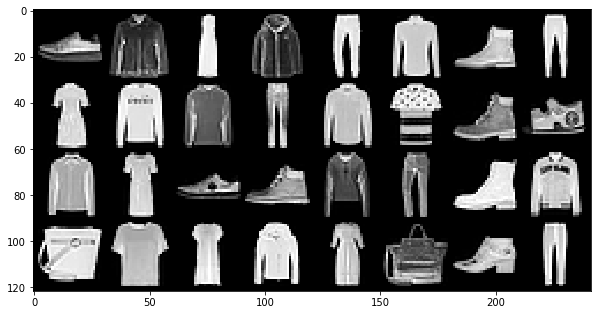

  0%|          | 0/469 [00:00<?, ?it/s]

Step 74500: Generator loss: 0.8297488105297093, discriminator loss: 0.6411797711849213


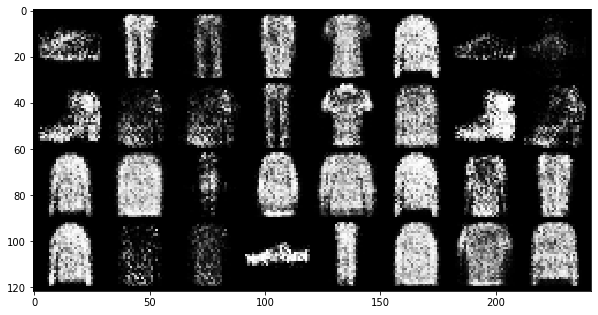

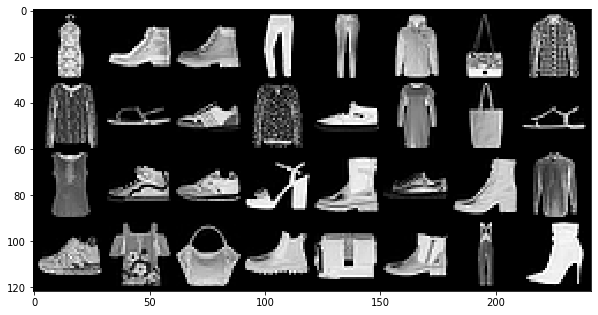

  0%|          | 0/469 [00:00<?, ?it/s]

Step 75000: Generator loss: 0.822095756292343, discriminator loss: 0.6441510680913921


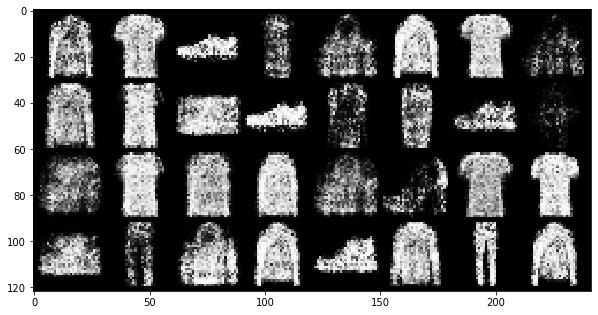

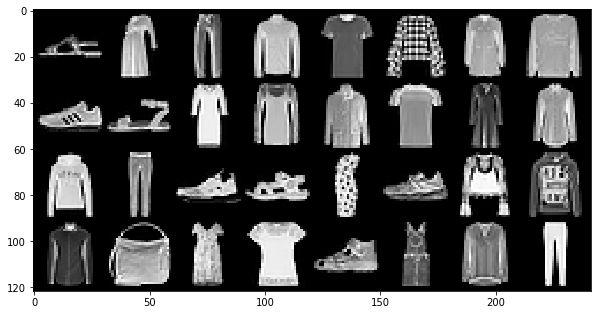

  0%|          | 0/469 [00:00<?, ?it/s]

Step 75500: Generator loss: 0.7968838841915136, discriminator loss: 0.6475911126136785


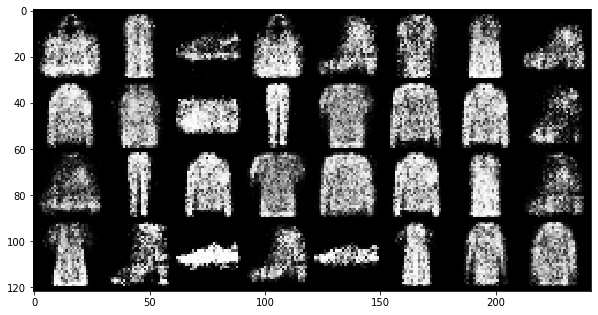

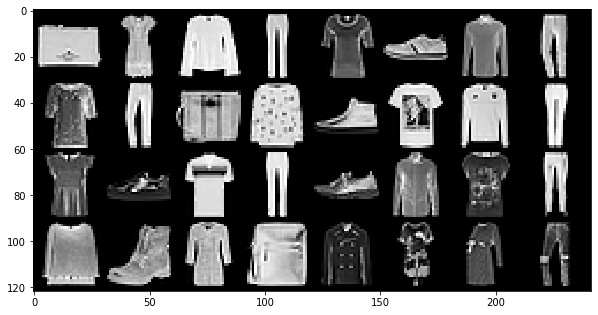

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 76000: Generator loss: 0.8048064019680025, discriminator loss: 0.6482724803686142


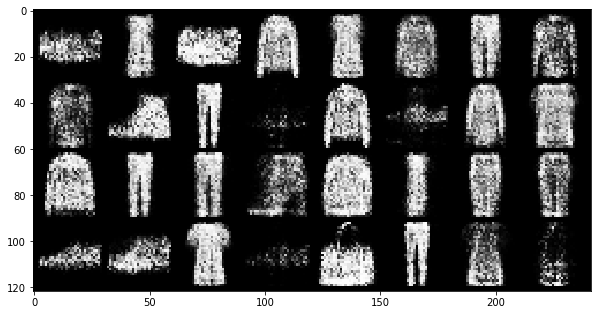

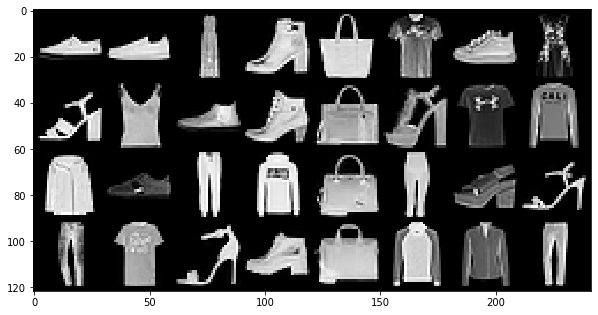

  0%|          | 0/469 [00:00<?, ?it/s]

Step 76500: Generator loss: 0.7917171717882153, discriminator loss: 0.6509793617725366


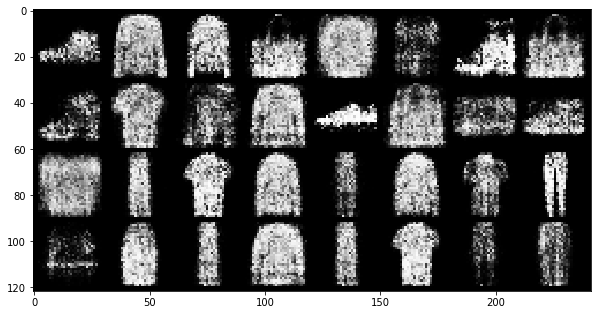

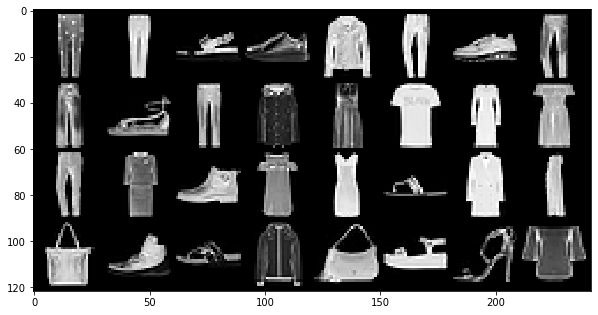

  0%|          | 0/469 [00:00<?, ?it/s]

Step 77000: Generator loss: 0.8066395411491397, discriminator loss: 0.6559395444393159


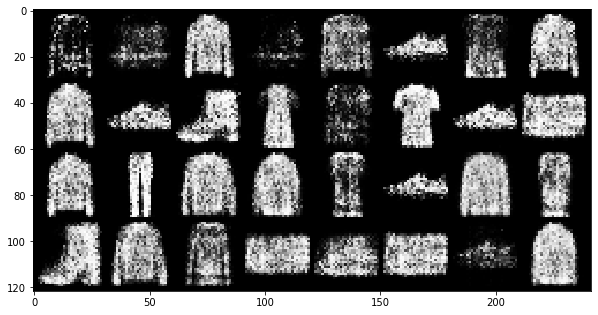

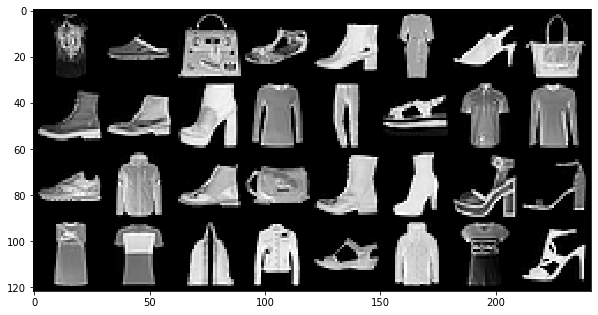

  0%|          | 0/469 [00:00<?, ?it/s]

Step 77500: Generator loss: 0.7799736375808716, discriminator loss: 0.6533377965688706


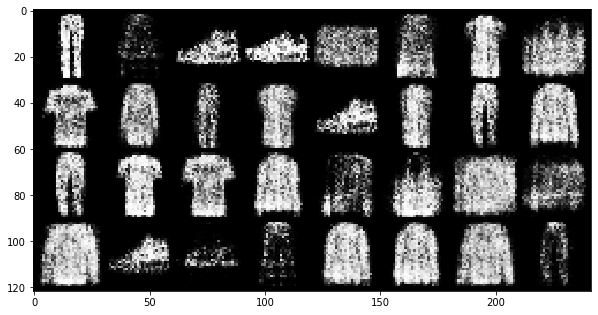

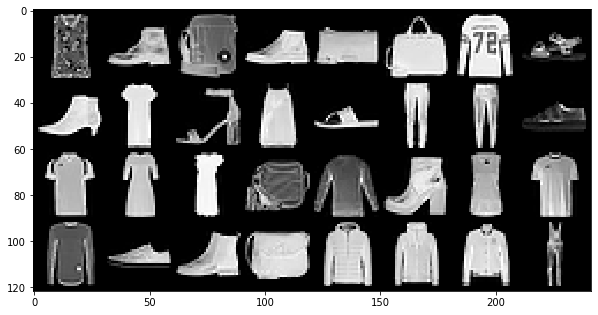

  0%|          | 0/469 [00:00<?, ?it/s]

Step 78000: Generator loss: 0.8157747890949246, discriminator loss: 0.6446258610486981


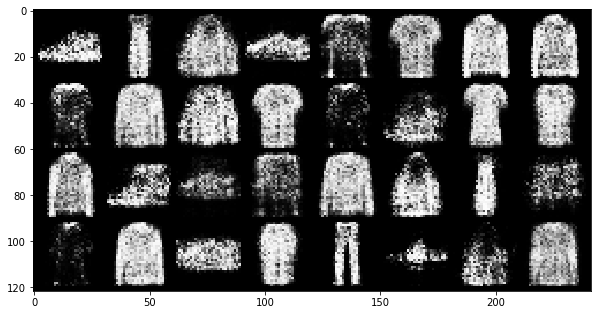

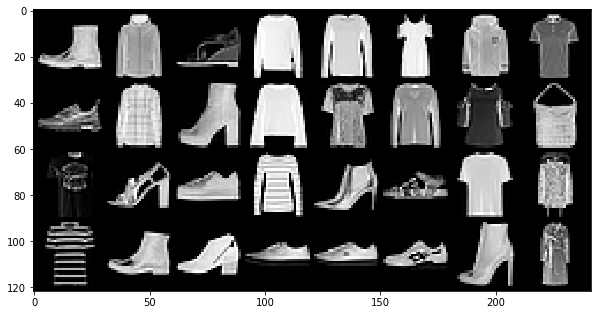

  0%|          | 0/469 [00:00<?, ?it/s]

Step 78500: Generator loss: 0.7970121898651117, discriminator loss: 0.6528580219745639


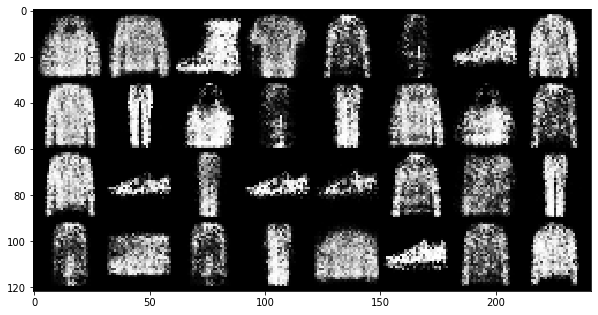

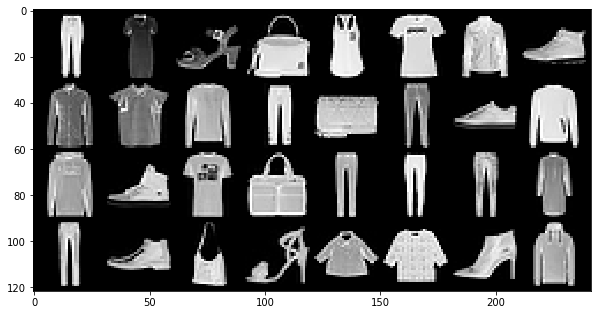

  0%|          | 0/469 [00:00<?, ?it/s]

Step 79000: Generator loss: 0.815314756989479, discriminator loss: 0.6498444172143932


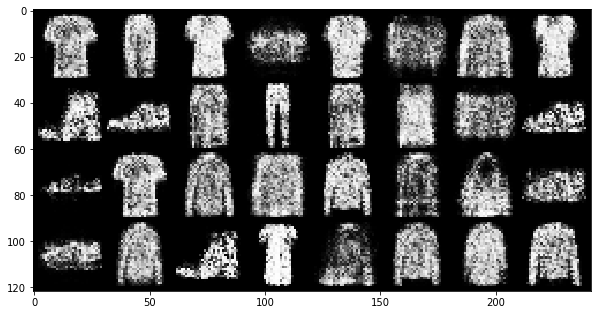

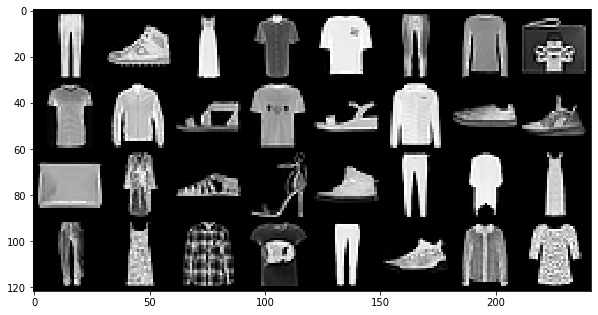

  0%|          | 0/469 [00:00<?, ?it/s]

Step 79500: Generator loss: 0.7860264673233041, discriminator loss: 0.6512750191688533


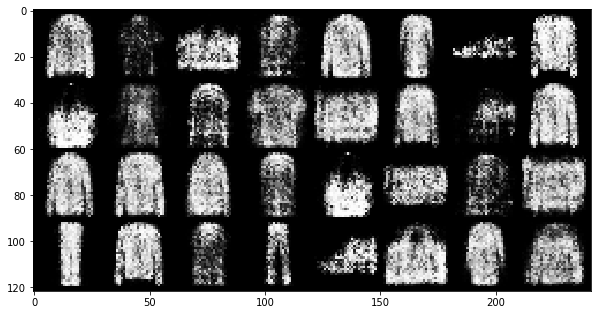

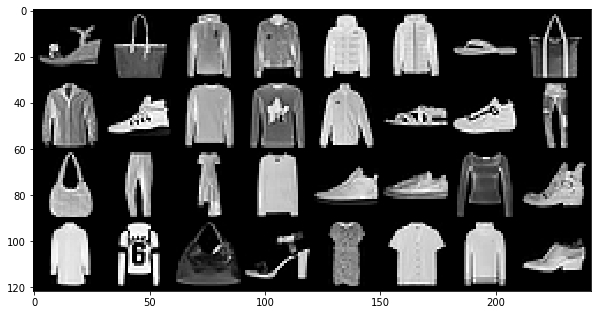

  0%|          | 0/469 [00:00<?, ?it/s]

Step 80000: Generator loss: 0.8142656075954429, discriminator loss: 0.658252321600914


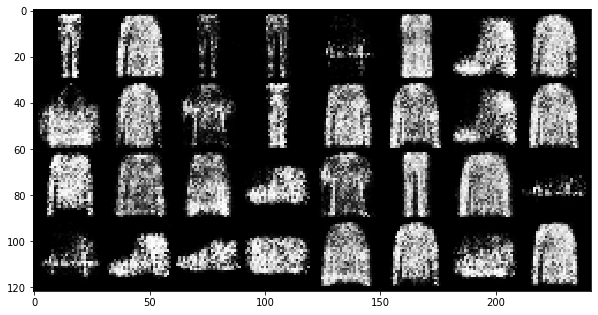

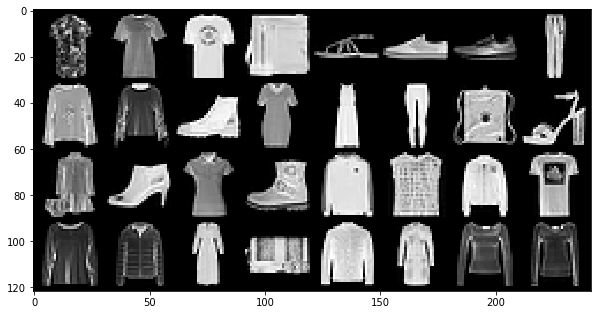

  0%|          | 0/469 [00:00<?, ?it/s]

Step 80500: Generator loss: 0.8032623071670537, discriminator loss: 0.6468854798078535


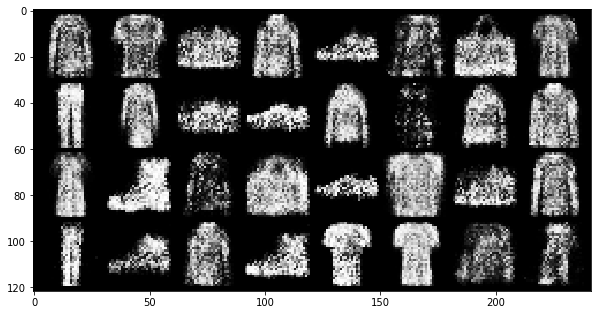

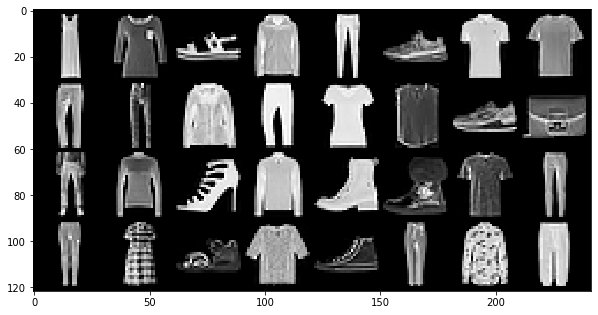

  0%|          | 0/469 [00:00<?, ?it/s]

Step 81000: Generator loss: 0.7980429341793056, discriminator loss: 0.6546910195350649


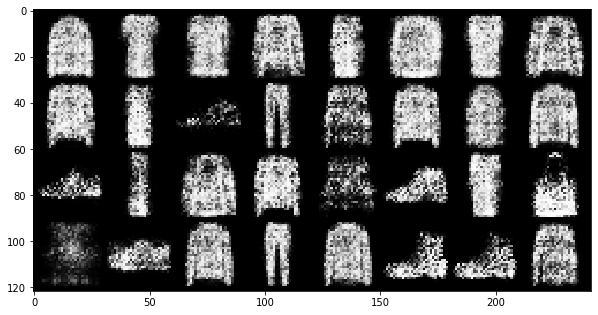

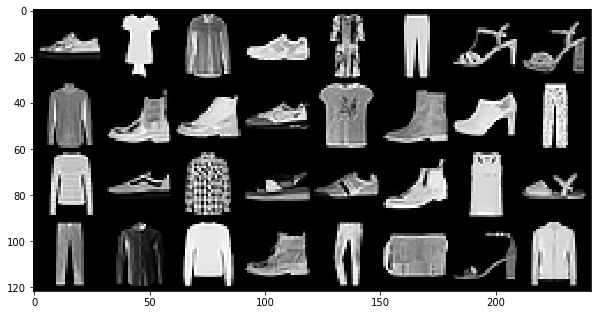

  0%|          | 0/469 [00:00<?, ?it/s]

Step 81500: Generator loss: 0.7873807218074795, discriminator loss: 0.6660884872674946


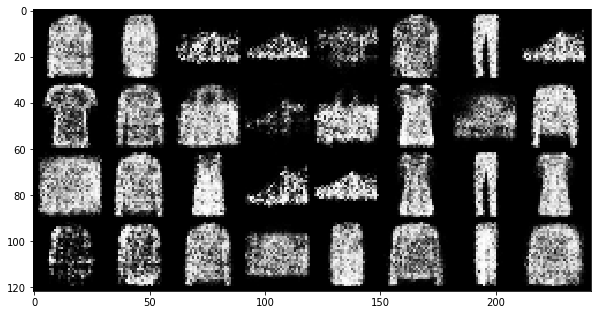

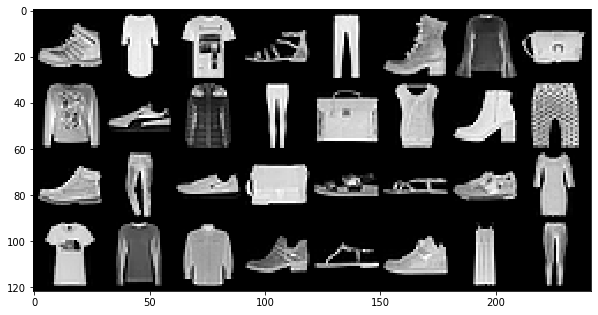

  0%|          | 0/469 [00:00<?, ?it/s]

Step 82000: Generator loss: 0.783012221574783, discriminator loss: 0.6648128131628032


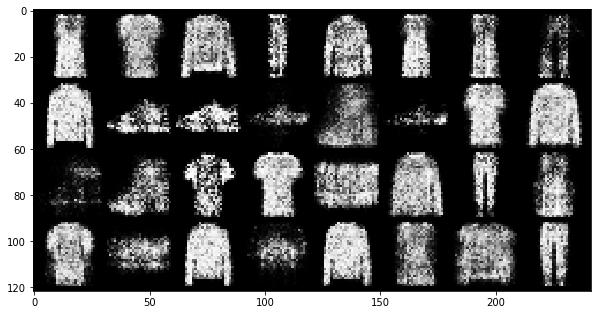

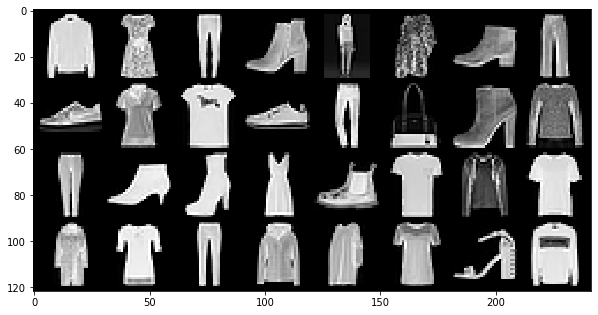

  0%|          | 0/469 [00:00<?, ?it/s]

Step 82500: Generator loss: 0.7810349253416056, discriminator loss: 0.6652566854953774


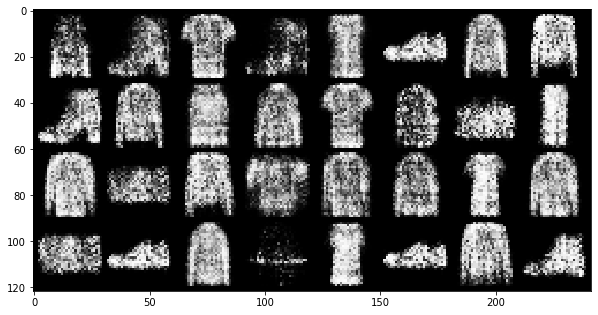

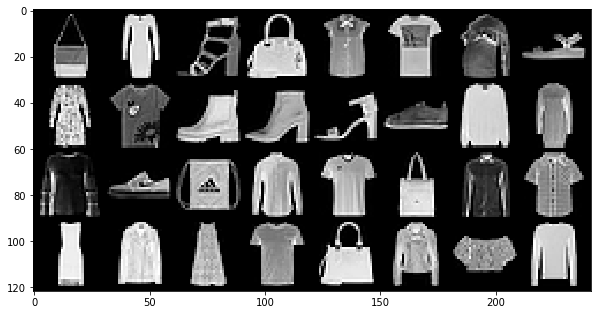

  0%|          | 0/469 [00:00<?, ?it/s]

Step 83000: Generator loss: 0.7876173453330994, discriminator loss: 0.6678978264331815


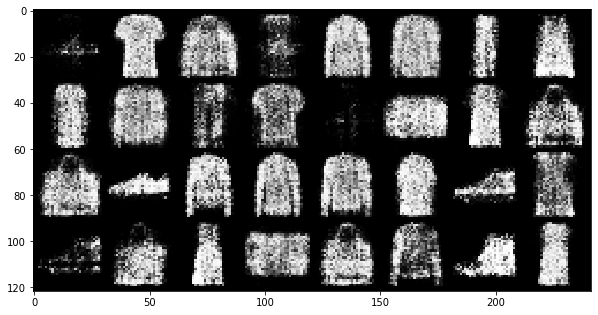

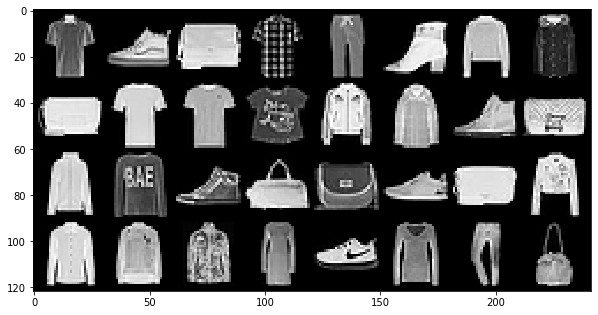

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 83500: Generator loss: 0.7798176252841943, discriminator loss: 0.6616197571754451


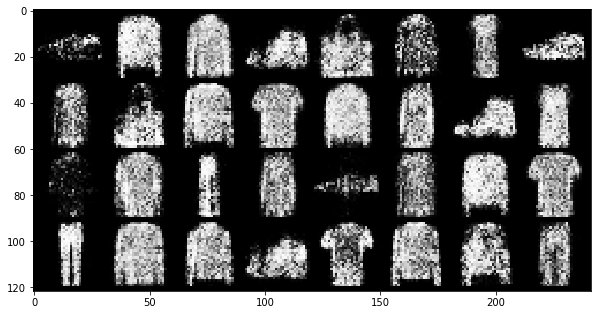

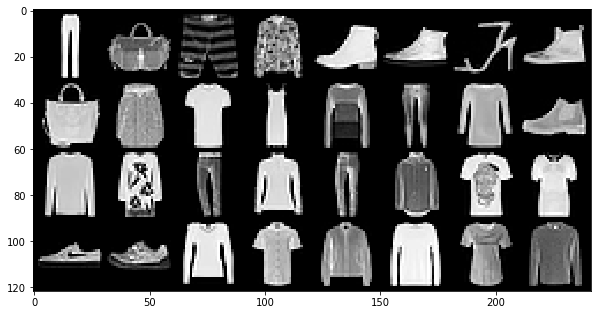

  0%|          | 0/469 [00:00<?, ?it/s]

Step 84000: Generator loss: 0.773931626439095, discriminator loss: 0.6667009772062301


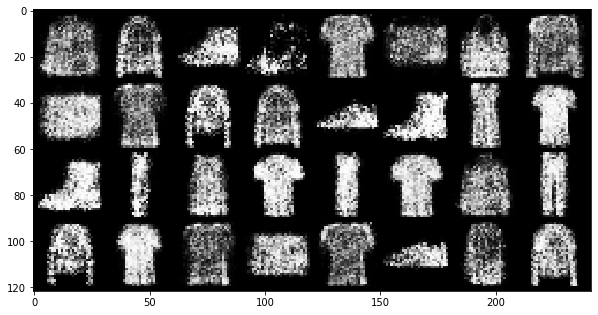

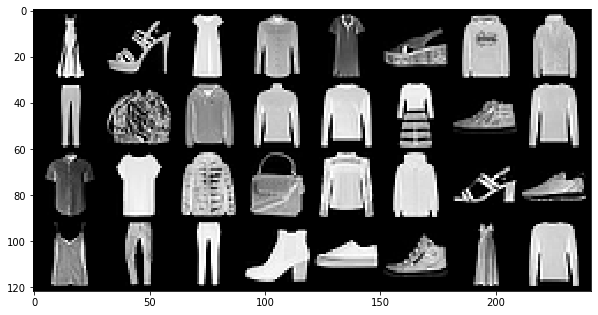

  0%|          | 0/469 [00:00<?, ?it/s]

Step 84500: Generator loss: 0.774008763670922, discriminator loss: 0.6686453262567519


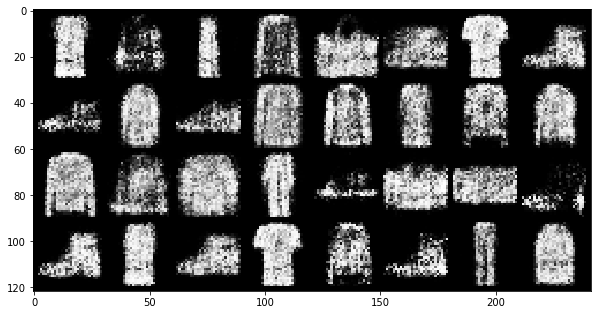

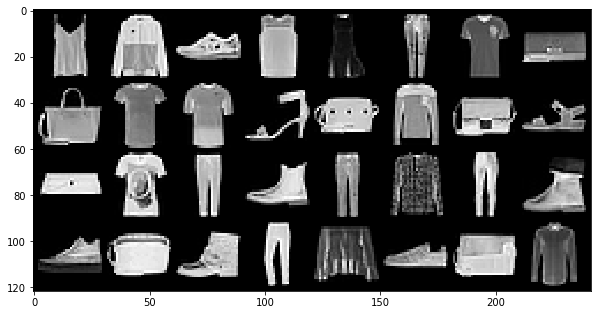

  0%|          | 0/469 [00:00<?, ?it/s]

Step 85000: Generator loss: 0.764696450710297, discriminator loss: 0.6757523155212399


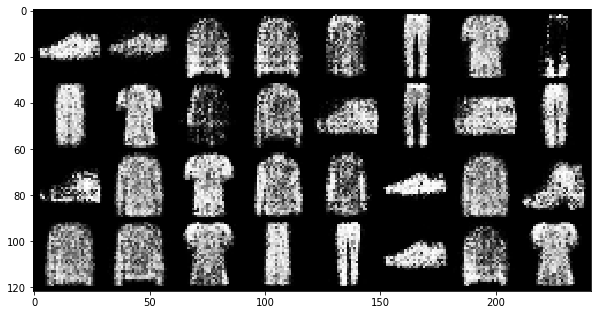

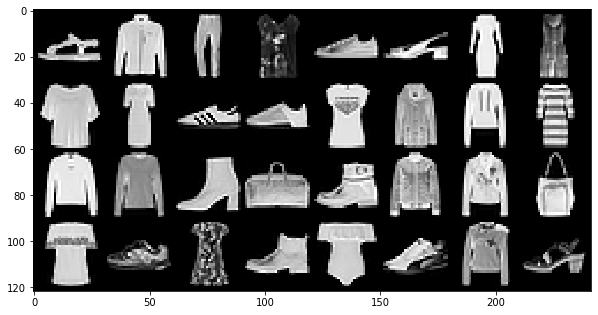

  0%|          | 0/469 [00:00<?, ?it/s]

Step 85500: Generator loss: 0.7534101752042771, discriminator loss: 0.669586446166039


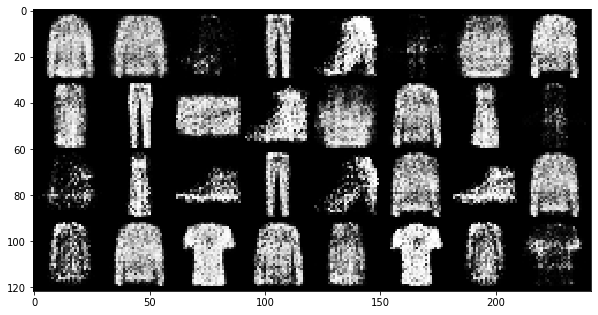

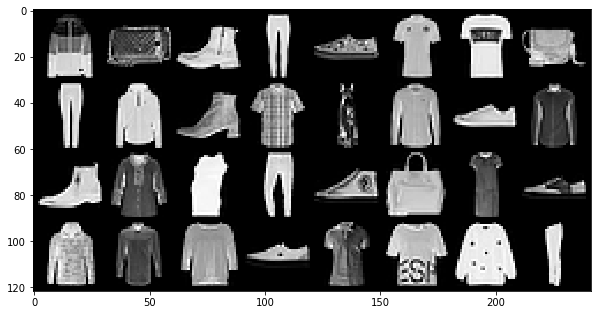

  0%|          | 0/469 [00:00<?, ?it/s]

Step 86000: Generator loss: 0.7771656559705734, discriminator loss: 0.6614162642955785


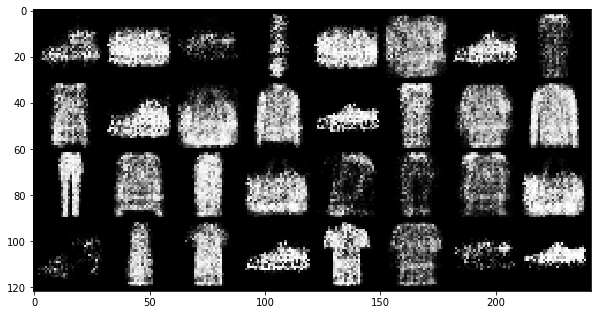

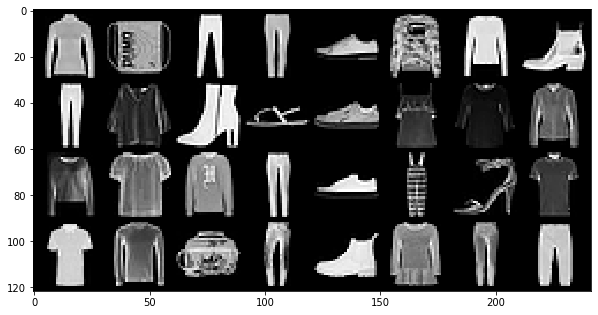

  0%|          | 0/469 [00:00<?, ?it/s]

Step 86500: Generator loss: 0.7561815313100818, discriminator loss: 0.6732813756465909


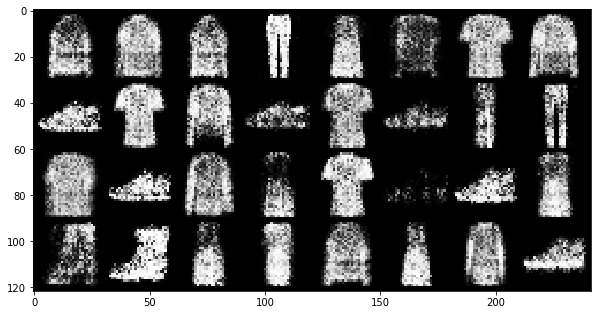

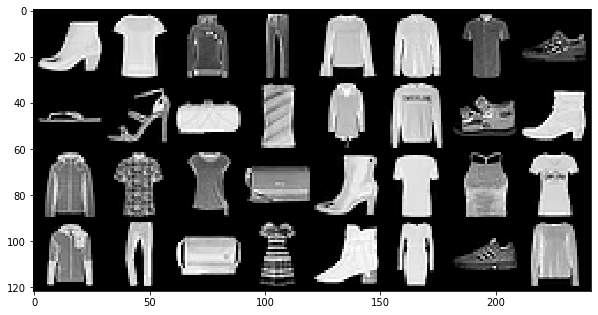

  0%|          | 0/469 [00:00<?, ?it/s]

Step 87000: Generator loss: 0.7754353791475301, discriminator loss: 0.6636834909915925


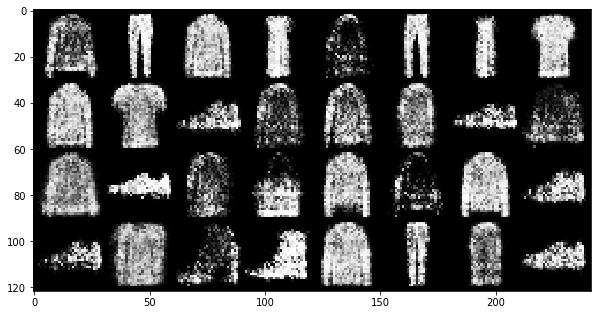

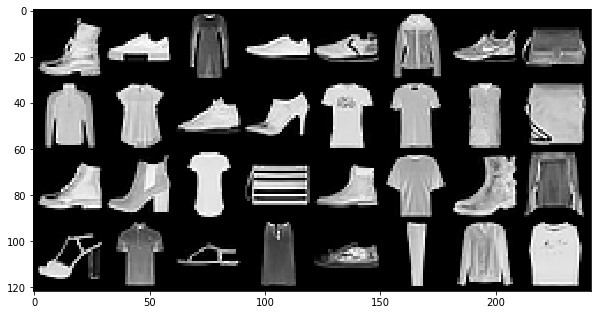

  0%|          | 0/469 [00:00<?, ?it/s]

Step 87500: Generator loss: 0.7517821251153949, discriminator loss: 0.6693945686817167


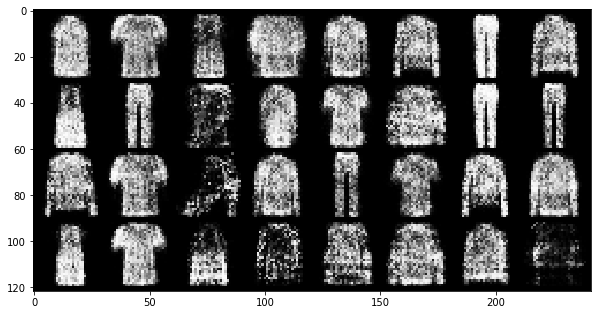

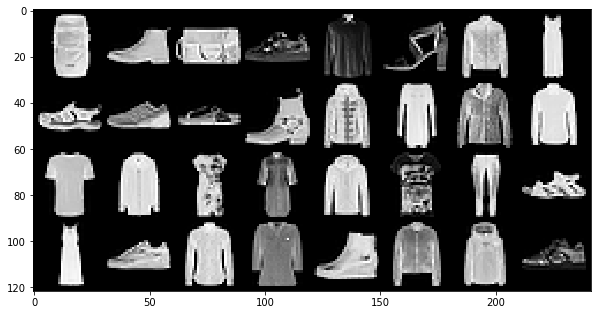

  0%|          | 0/469 [00:00<?, ?it/s]

Step 88000: Generator loss: 0.7603377790451046, discriminator loss: 0.6711472327709196


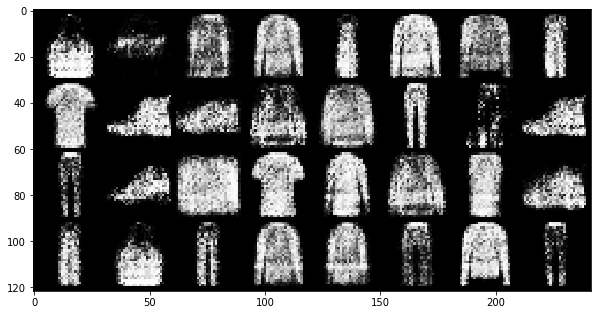

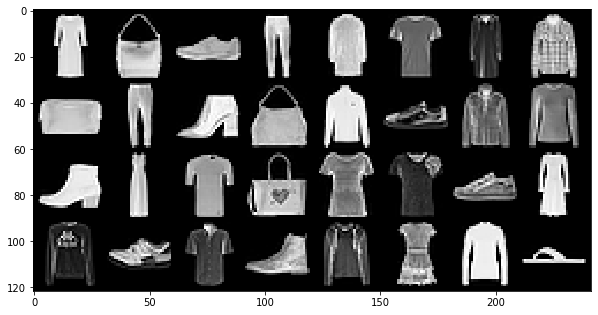

  0%|          | 0/469 [00:00<?, ?it/s]

Step 88500: Generator loss: 0.7644050037860868, discriminator loss: 0.6618819370269775


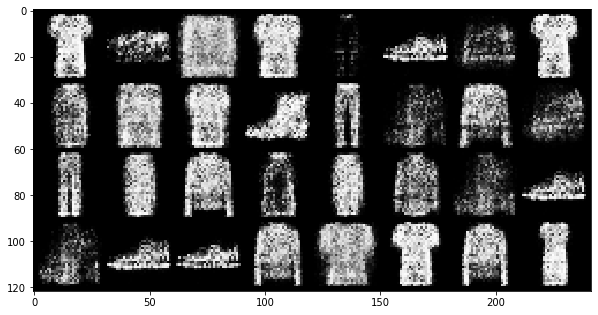

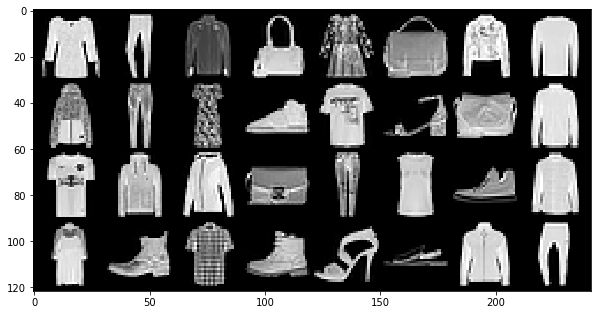

  0%|          | 0/469 [00:00<?, ?it/s]

Step 89000: Generator loss: 0.7904969711303722, discriminator loss: 0.6706971769332886


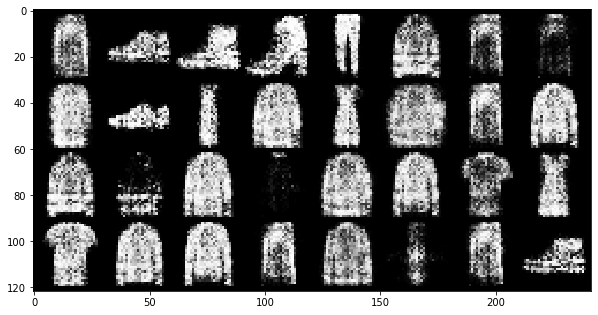

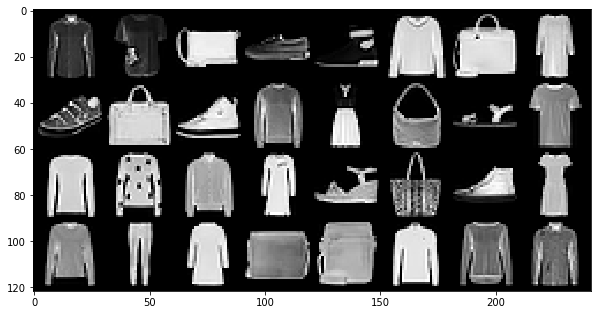

  0%|          | 0/469 [00:00<?, ?it/s]

Step 89500: Generator loss: 0.7840811946392056, discriminator loss: 0.6574887017011638


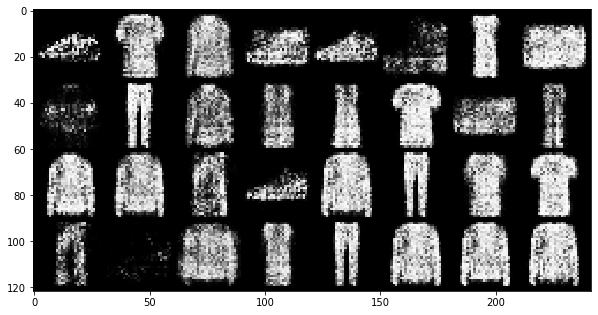

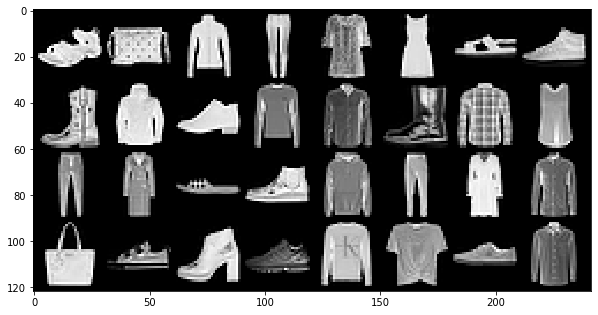

  0%|          | 0/469 [00:00<?, ?it/s]

Step 90000: Generator loss: 0.7785290133953101, discriminator loss: 0.6597157474756244


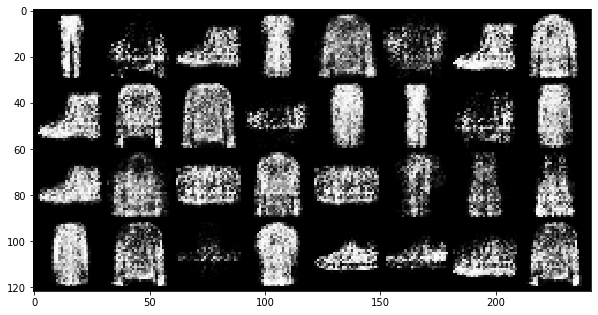

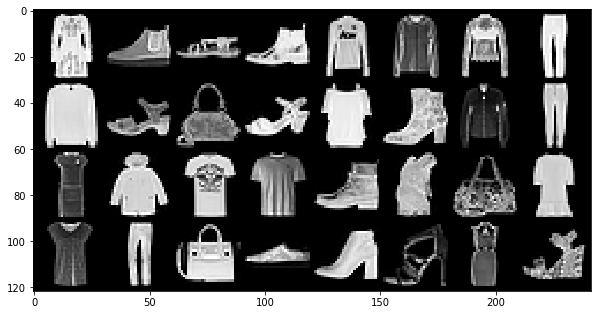

  0%|          | 0/469 [00:00<?, ?it/s]

Step 90500: Generator loss: 0.7769123612642285, discriminator loss: 0.6677604960203163


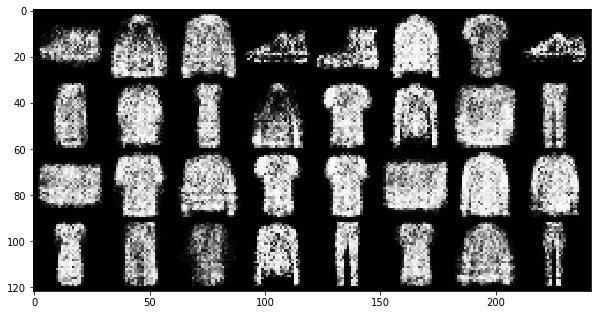

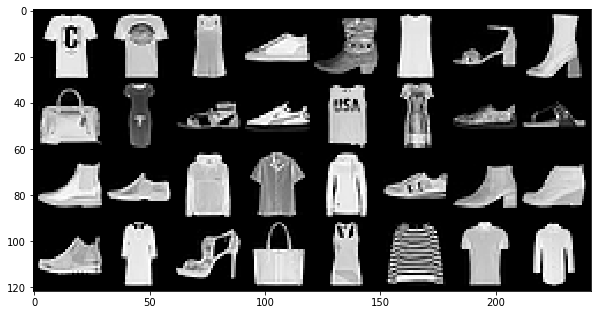

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 91000: Generator loss: 0.7819362168312076, discriminator loss: 0.6669731215238581


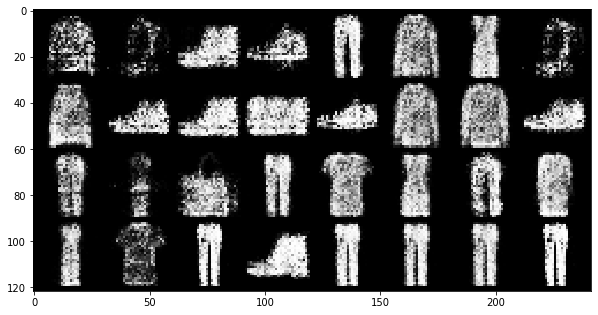

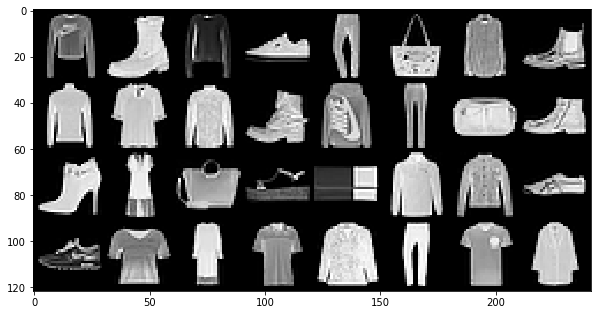

  0%|          | 0/469 [00:00<?, ?it/s]

Step 91500: Generator loss: 0.7760664966106419, discriminator loss: 0.6695804386138918


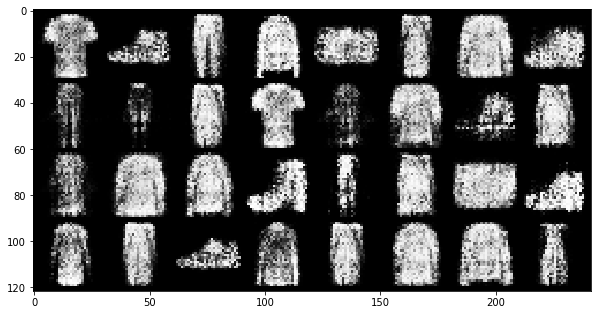

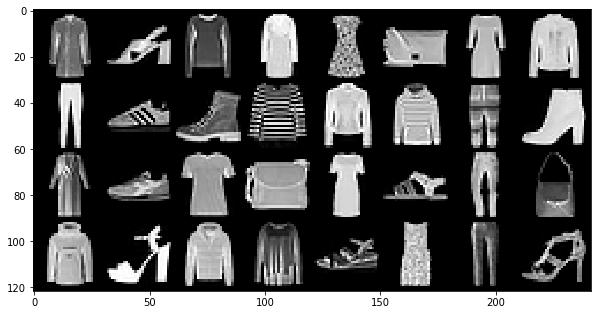

  0%|          | 0/469 [00:00<?, ?it/s]

Step 92000: Generator loss: 0.7774657056331631, discriminator loss: 0.6620633138418196


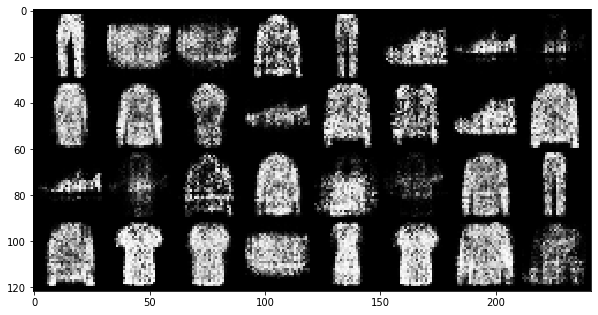

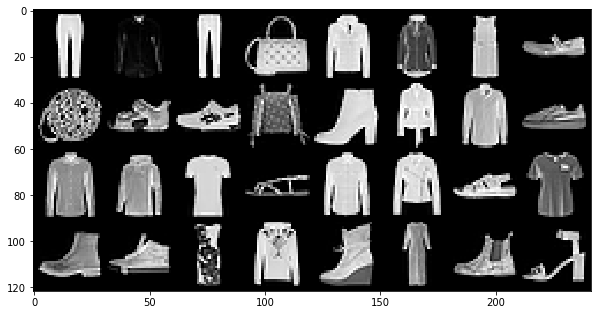

  0%|          | 0/469 [00:00<?, ?it/s]

Step 92500: Generator loss: 0.7697402647733693, discriminator loss: 0.6758198386430737


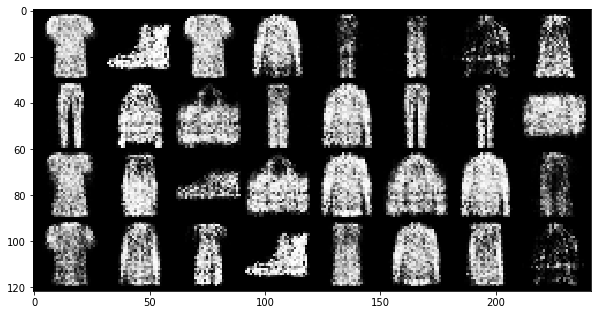

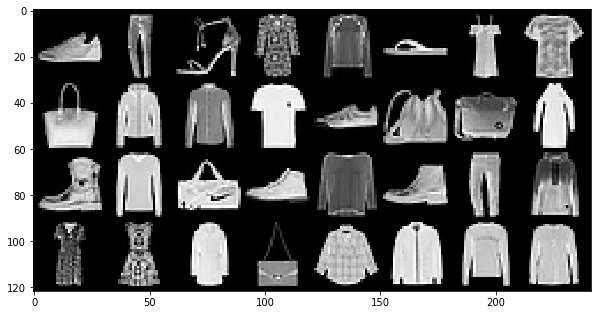

  0%|          | 0/469 [00:00<?, ?it/s]

Step 93000: Generator loss: 0.7659417998790741, discriminator loss: 0.6644414589405058


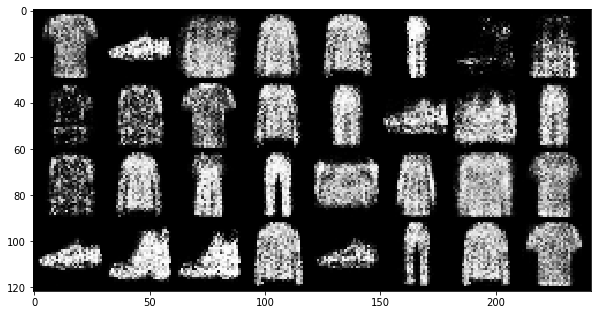

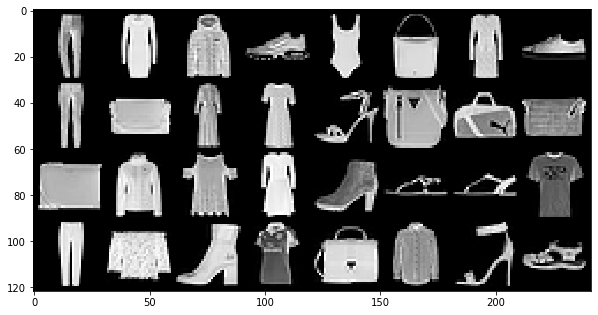

  0%|          | 0/469 [00:00<?, ?it/s]

Step 93500: Generator loss: 0.7866226649284365, discriminator loss: 0.6685341972112646


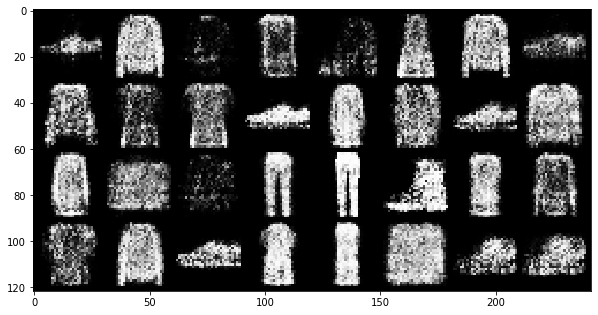

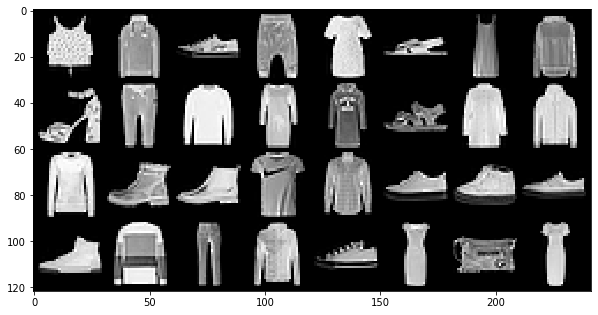

In [46]:
current_step = 0 # store current training step
mean_generator_loss = 0 # store mean generator loss for every `display_step` steps 
mean_discriminator_loss = 0 # store mean discriminator loss for every `display_step` steps
for epoch in range(n_epochs):
    for real_images, _ in tqdm(dataloader):
        current_batch_size = len(real_images)
        real_images = real_images.view(current_batch_size, -1).to(device) # flatten images

        # Discriminator training loop
        discriminator_opt.zero_grad()
        discriminator_loss = get_discriminator_loss(generator, discriminator, criterion, real_images, current_batch_size, noise_dim, device)
        discriminator_loss.backward(retain_graph=True)
        discriminator_opt.step()

        # Generator training loop
        # TODO: Start your code here
        generator_opt.zero_grad()
        generator_loss = get_generator_loss(generator, discriminator, criterion, current_batch_size, noise_dim, device)
        generator_loss.backward()
        generator_opt.step()
        # End your code here

        # Compute average discriminator loss per `display_step` steps
        mean_discriminator_loss += discriminator_loss.item() / display_step

        # Compute average generator loss per `display_step` steps
        mean_generator_loss += generator_loss.item() / display_step

        # Visualization
        if current_step % display_step == 0 and current_step > 0:
            print(f"Step {current_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            fake_noise = get_noise(current_batch_size, noise_dim, device=device)
            fake_images = generator(fake_noise)
            show_images(fake_images, fmnist_shape)
            show_images(real_images, fmnist_shape)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        current_step += 1